In [1]:
from platform import python_version
print(python_version())

3.6.8


# Imports

In [177]:
import inspect
import logging
import os
import sys
import io
import re
import pandas as pd
import numpy as np
import nltk
import yaml
import seaborn as sns
from math import *

from matplotlib import pyplot as plt
import matplotlib.cm as cm
from matplotlib.axes._axes import _log as matplotlib_axes_logger
matplotlib_axes_logger.setLevel('ERROR')

# PDFMiner
from pdfminer.pdfinterp import PDFResourceManager, PDFPageInterpreter
from pdfminer.converter import TextConverter
from pdfminer.pdfpage import PDFPage
from pdfminer.layout import LAParams

# Collections
import collections
from collections import Counter

# NLTK
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.cluster import KMeansClusterer, euclidean_distance

# Gensim
from gensim.corpora.dictionary import Dictionary
from gensim.models.tfidfmodel import TfidfModel
from gensim.models import word2vec
import gensim

from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

# Spacy
import spacy
nlp = spacy.load('en_core_web_sm')
# creuser la présence de mot anglais

# Import for progress bar
from tqdm import tqdm


currentdir = os.path.dirname(os.path.abspath(inspect.getfile(inspect.currentframe())))
parentdir = os.path.dirname(currentdir)
sys.path.insert(0,parentdir)

# Vars & Paths

In [133]:
Other_directory = "data/input/Other"
Other_output_directory = "data/output/Other"
jobs_save_file = "jobs_save_file.csv"

confs_path = "confs/config.yaml"
confs = yaml.load(open(confs_path, encoding='utf8'))

ITconfs_path = "confs/ITconfig.yaml"
ITconfs = yaml.load(open(ITconfs_path, encoding='utf8'))


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:6: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:9: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  if __name__ == '__main__':


In [175]:
# Delete english stopwords
isDeleteEnglishStopwords = True 

#lower the word
isLower = True

#lemmatize the word
isLemmatize = False

perplexity=30

possibilities = [False, True]

perplexityPossibilities=[30, 50]

n_iter = 2500

n_iterPossibilities = [2500, 5000]

min_count = 50

min_countPossibilities = [30, 50, 70]

In [139]:
skills = []

for extractor, items_of_interest in ITconfs['extractors'].items():
    
    for items in items_of_interest :

        
        # Format list inputs
        if type(items) is list and len(items) >= 1:
            for i in items :
                skills.append(i)

        # Format string inputs
        elif type(skill_input) is str:
            skills.append(i)


regex_skill = ""
for skill in skills : 
    if skill == skills[-1] :
        regex_skill += r'\b' + re.escape(skill) + r'\b'
    else :
        regex_skill += r'\b' + re.escape(skill) + r'\b' + "|"
        

# Extract & Convert

In [141]:
def reduceDimensionList (my_list) :
    
    my_list = [item for sublist in my_list for item in sublist]
    
    return my_list

In [147]:
def getColumn(start_index, end_index, sentences):

        if start_index != 0:
            start_index = start_index + 1
        
        if end_index == 0 :
            text = sentences[start_index:]
        else : 
            text = sentences[start_index:end_index]
                        
            
        text = [word_tokenize(w) for w in text]

        my_text = []
        for sent in text :
            my_sent = []
            for word in sent :
                # Delete date or phone number
                if not len(re.findall("[a-zA-Z]",word)) > 0: 
                    continue
                    
                #lower the word
                if isLower:    
                    word = word.lower()
                    
                #lemmatize the word
                if isLemmatize:
                    word = nlp(word)[0].lemma_ 
                                    
                # Delete english stopwords
                if isDeleteEnglishStopwords and (word in stopwords.words("english")):
                    continue
                   
                #append (or not) the word to the "sentence"
                if len(word) > 0:
                    my_sent.append(word)

            #append (or not) the sentence to the "text"
            if len(my_sent) > 0:
                my_text.append(my_sent)
                
        
        return my_text

# Start preprocessing

In [148]:
def preprocessingAO(observations):  
       
    observations['sentences'] = ""
    observations['sentences2'] = ""

    for index, row in tqdm(observations.iterrows()):
        
        # Tokenization
        sentences = []        
        del_1 = "\n"
        delimiters = del_1 
        paragraphs = [p for p in re.split(delimiters, row["job_description"]) if p]
        for paragraph in paragraphs:
            sentences += sent_tokenize(paragraph)
        observations.loc[index, "sentences"] = sentences
        
        observations.loc[index, "sentences2"] = getColumn(0, 0, sentences)

        
    return observations

In [149]:
# 338 lines

seekBoard = pd.read_csv("data/input/Other/seek_australia_sample.csv", encoding = "ISO-8859-1")
seekBoard = seekBoard[["job_description"]]
seekBoard = seekBoard[seekBoard['job_description'].str.contains(regex_skill, na=False, regex=True)]
seekBoard_observations = preprocessingAO(seekBoard)


338it [01:41,  2.32it/s]


In [156]:
# 188 lines

gumtreeBoard = pd.read_csv("data/input/Other/Gumtree_australia.csv", encoding = "ISO-8859-1")
gumtreeBoard = gumtreeBoard[["job_description"]]
gumtreeBoard = gumtreeBoard[gumtreeBoard['job_description'].str.contains(regex_skill, na=False, regex=True)]
gumtreeBoard_observations = preprocessingAO(gumtreeBoard)


188it [00:22,  7.98it/s]


# TSNE

In [172]:
listToReduce = seekBoard_observations['sentences2'].tolist() + gumtreeBoard_observations['sentences2'].tolist()

corpus = reduceDimensionList(listToReduce)
model = word2vec.Word2Vec(corpus, min_count=min_count, seed = 0)

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


In [179]:
def tsne_plot(model):

    labels = []
    tokens = []

    # Get words
    for word in model.wv.vocab:
        tokens.append(model[word])
        labels.append(word)
        
    # Get X & Y values
    tsne_model = TSNE(perplexity=perplexity, init='pca', n_iter=n_iter, random_state=0)
    new_values = tsne_model.fit_transform(tokens)
    x = []
    y = []
    for value in new_values:
        x.append(value[0])
        y.append(value[1])
        

    matrix = np.column_stack((x, y))
    clusters_number = 10
    kclusterer = KMeansClusterer(clusters_number,  distance=nltk.cluster.util.cosine_distance, repeats=25)
    assigned_clusters = kclusterer.cluster(matrix, assign_clusters=True)


    colors = cm.rainbow(np.linspace(0, 1, clusters_number))
    plt.figure(figsize=(16, 16)) 
    for i in range(len(x)):
        plt.scatter(x[i],y[i], c=colors[assigned_clusters[i]])
        plt.annotate(labels[i],
                     xy=(x[i], y[i]),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
        
        
    title = "Mincount_" + str(min_count) \
    + " Files_" + str(len(seekBoard_observations) + len(gumtreeBoard_observations)) \
    + " Perplexity" + str(perplexity) \
    + " EnglishStopword_" + str(isDeleteEnglishStopwords) \
    + " Lower_" + str(isLower) \
    + " Lemmatization_" + str(isLemmatize)
    

                    
                    
    plt.savefig(title + ".png", bbox_inches='tight')
    
    model.save(title + ".model")
    
    plt.show()

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a si

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


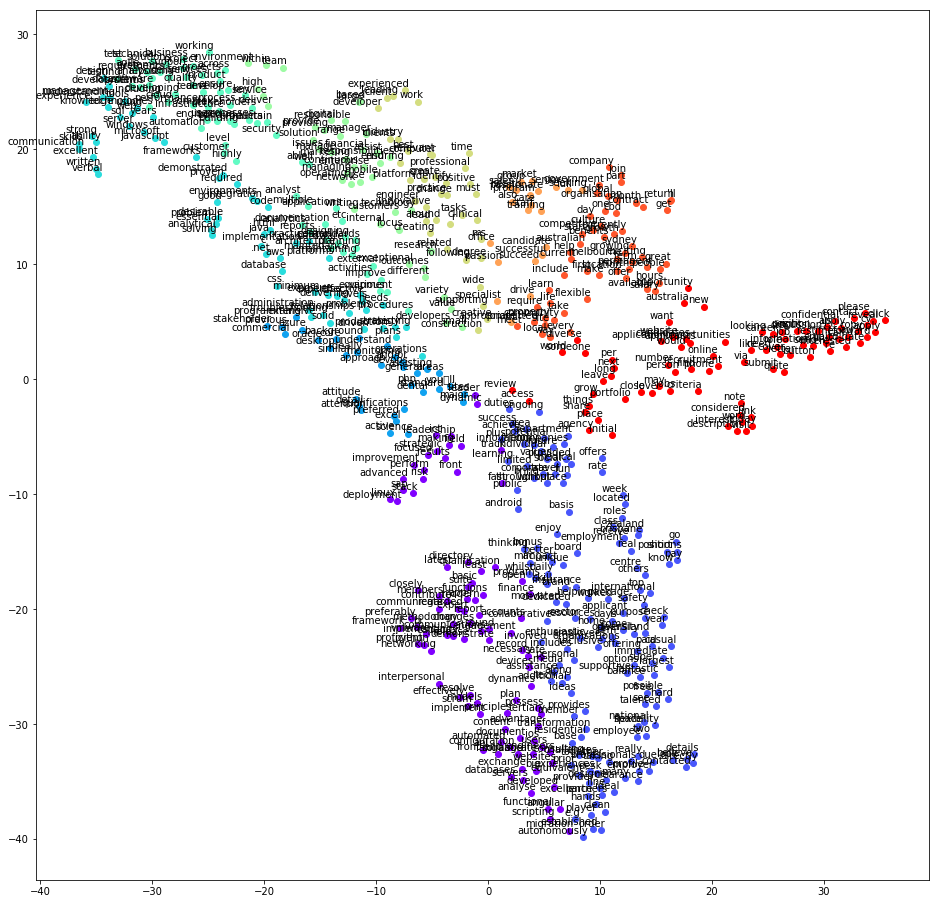

In [174]:
tsne_plot(model)


# All cases

preprocessing


338it [00:01, 181.55it/s]
188it [00:00, 237.81it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


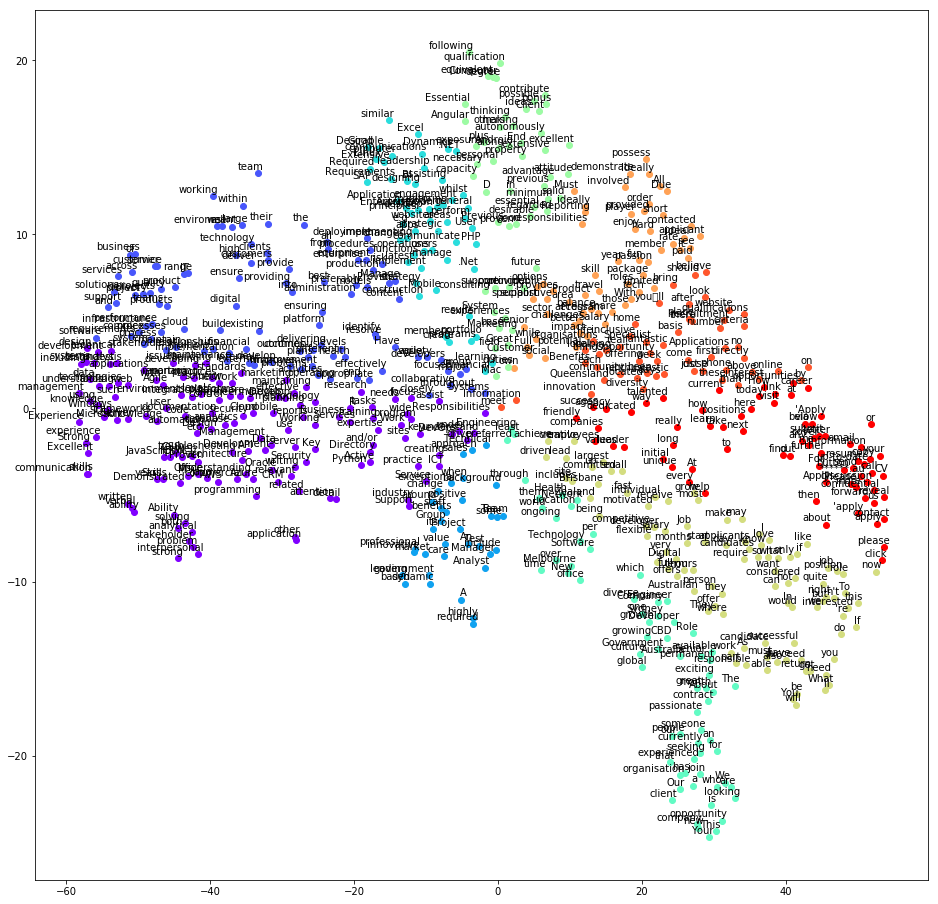

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:01, 173.88it/s]
188it [00:00, 243.03it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


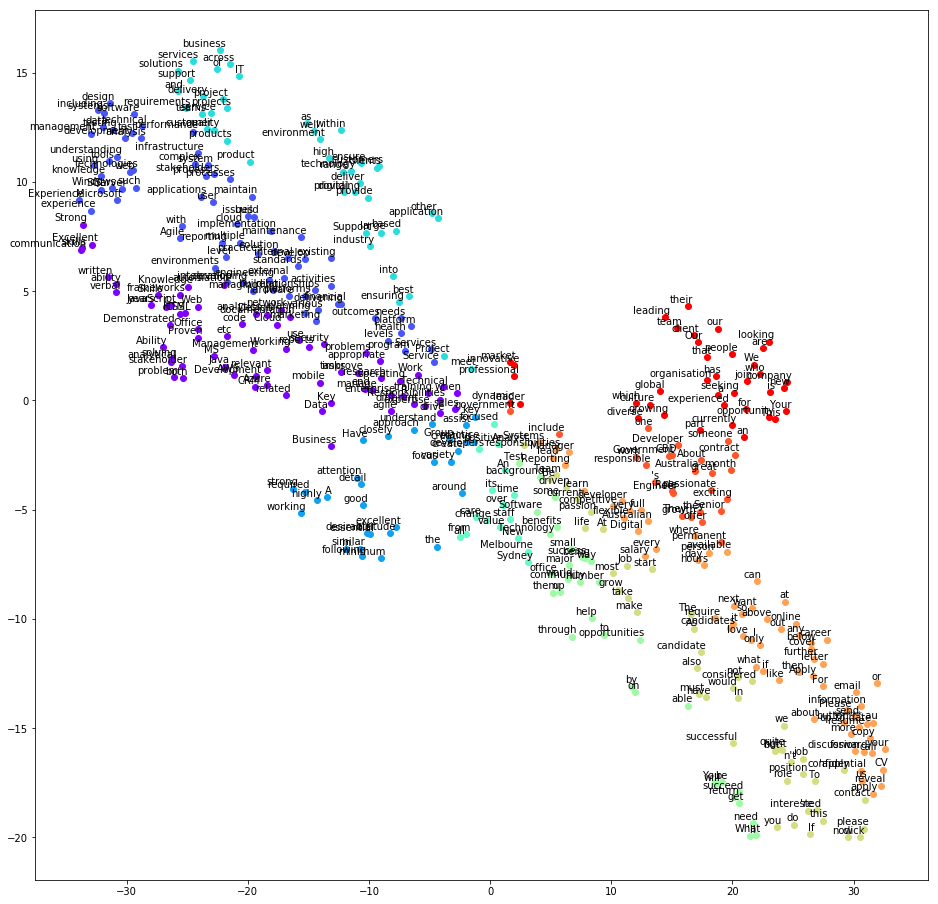

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:02, 145.52it/s]
188it [00:00, 192.86it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


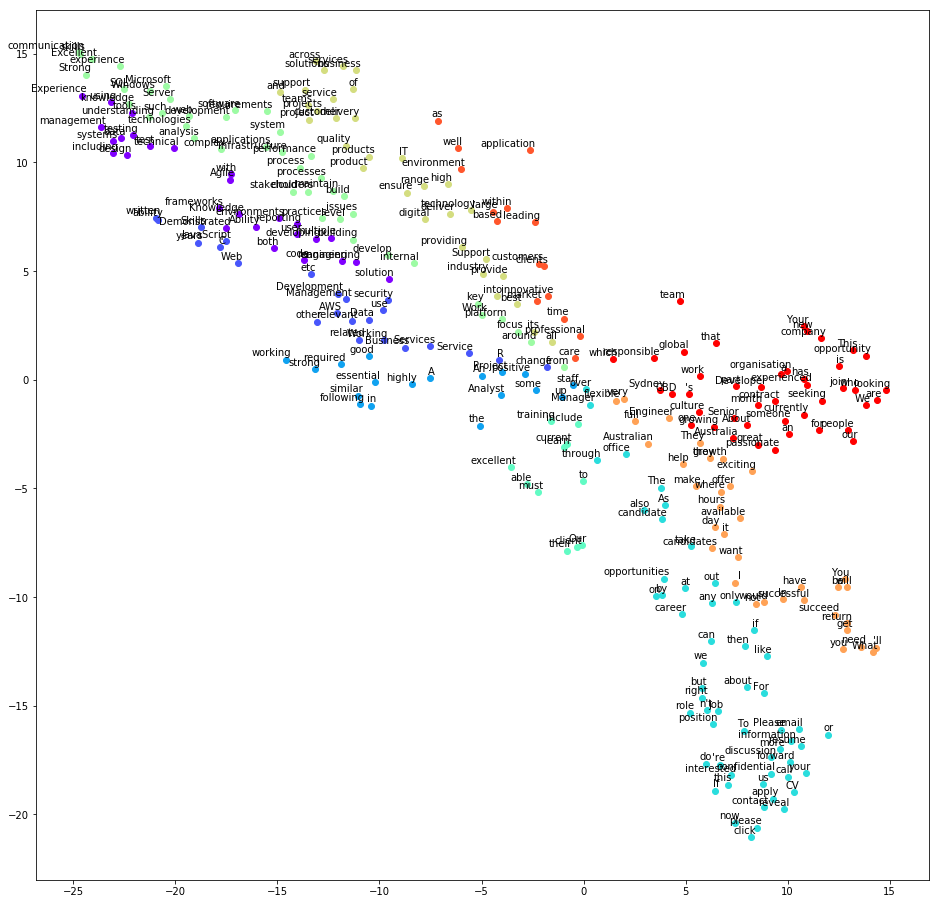

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:02, 145.15it/s]
188it [00:00, 201.83it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


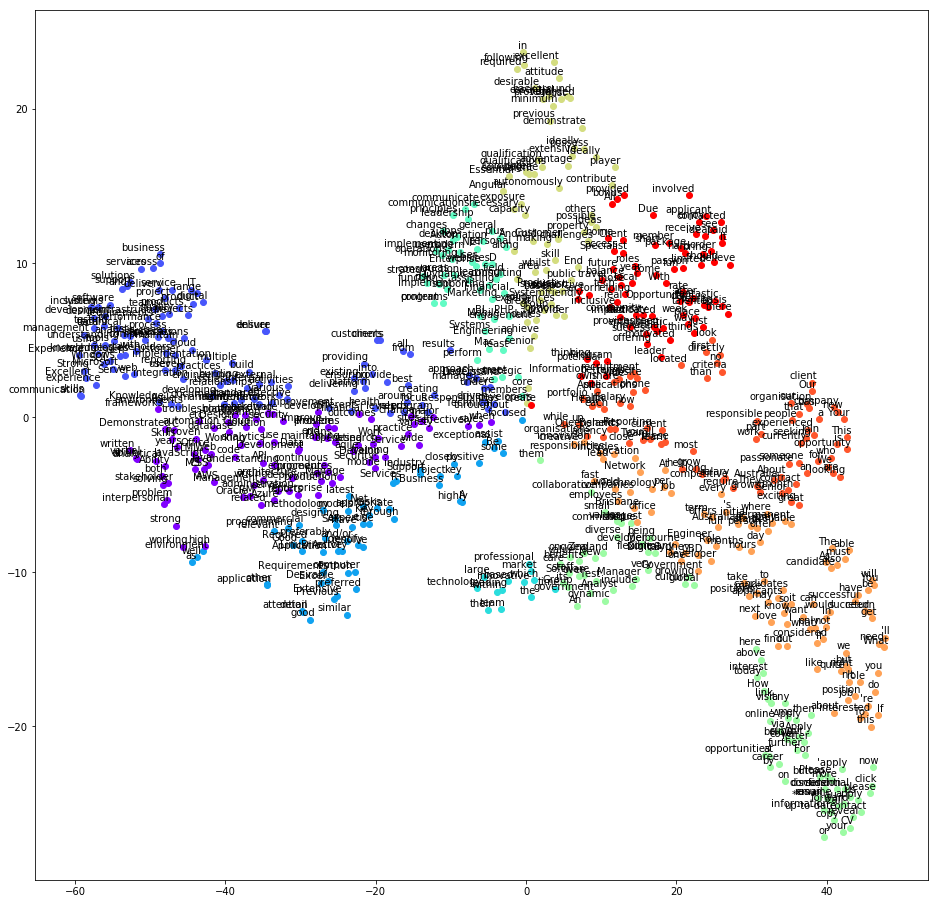

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:02, 142.76it/s]
188it [00:00, 202.27it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


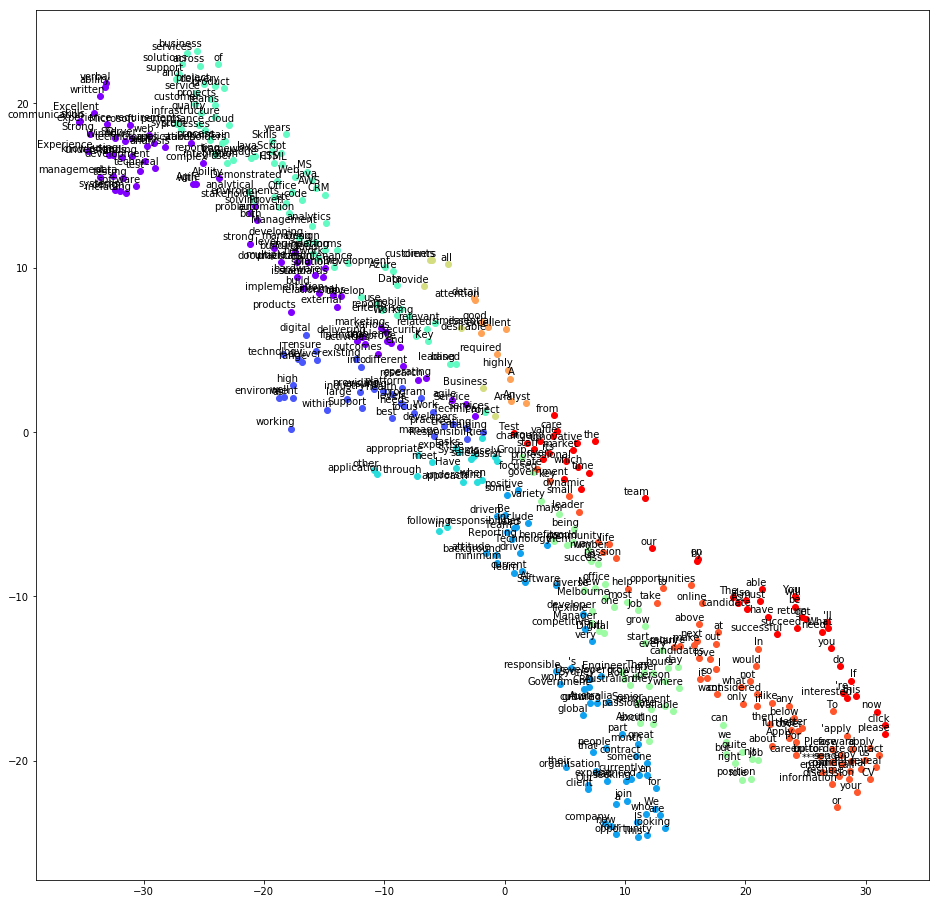

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:02, 152.96it/s]
188it [00:00, 190.96it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


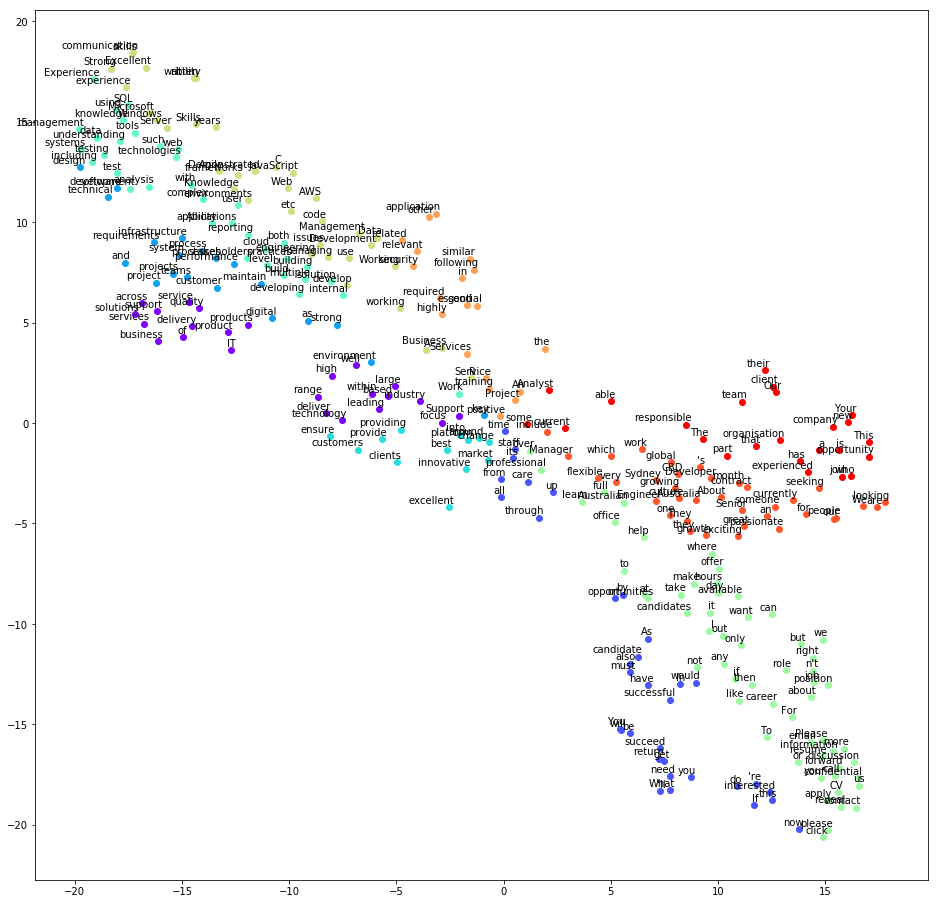

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [14:53,  2.78s/it]
188it [05:36,  1.24s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


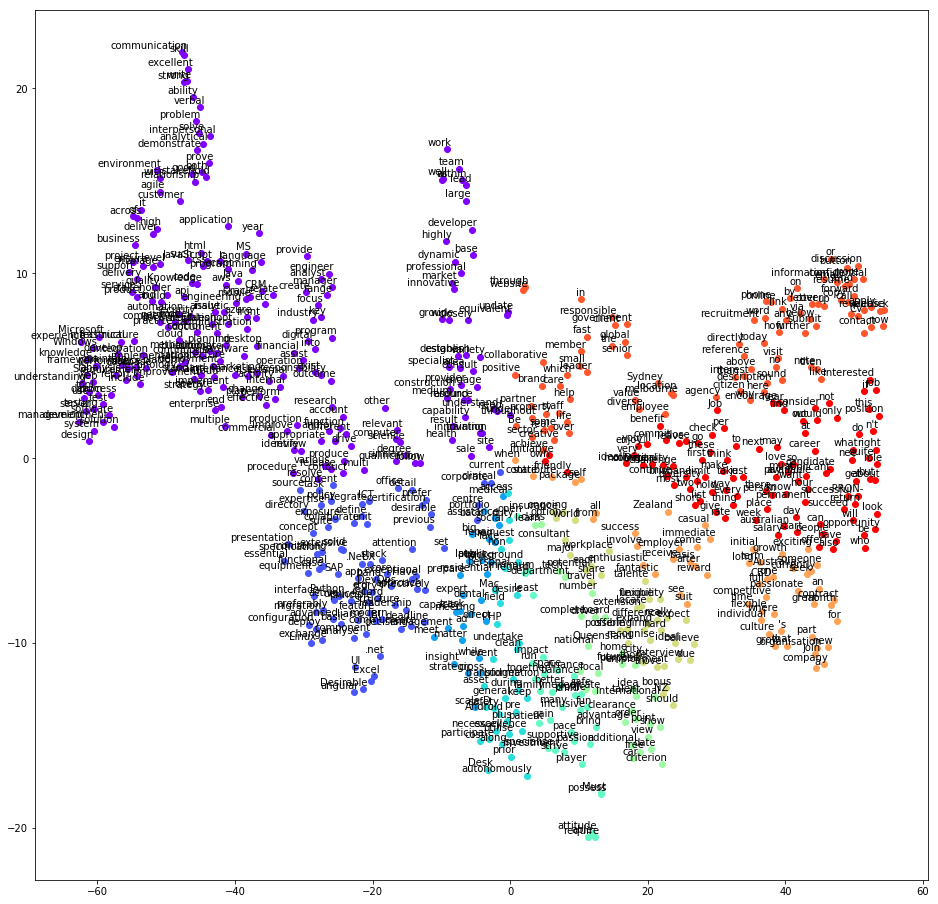

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [14:45,  2.77s/it]
188it [05:48,  1.55s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


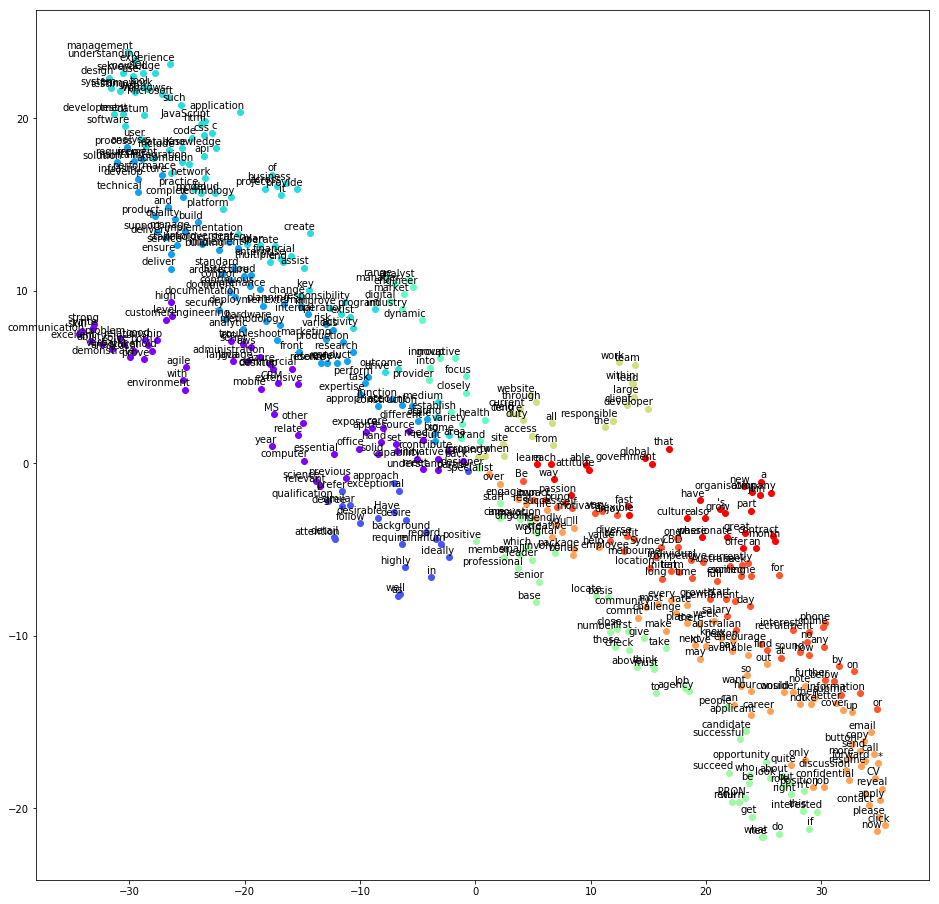

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [15:22,  2.94s/it]
188it [04:54,  1.28s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


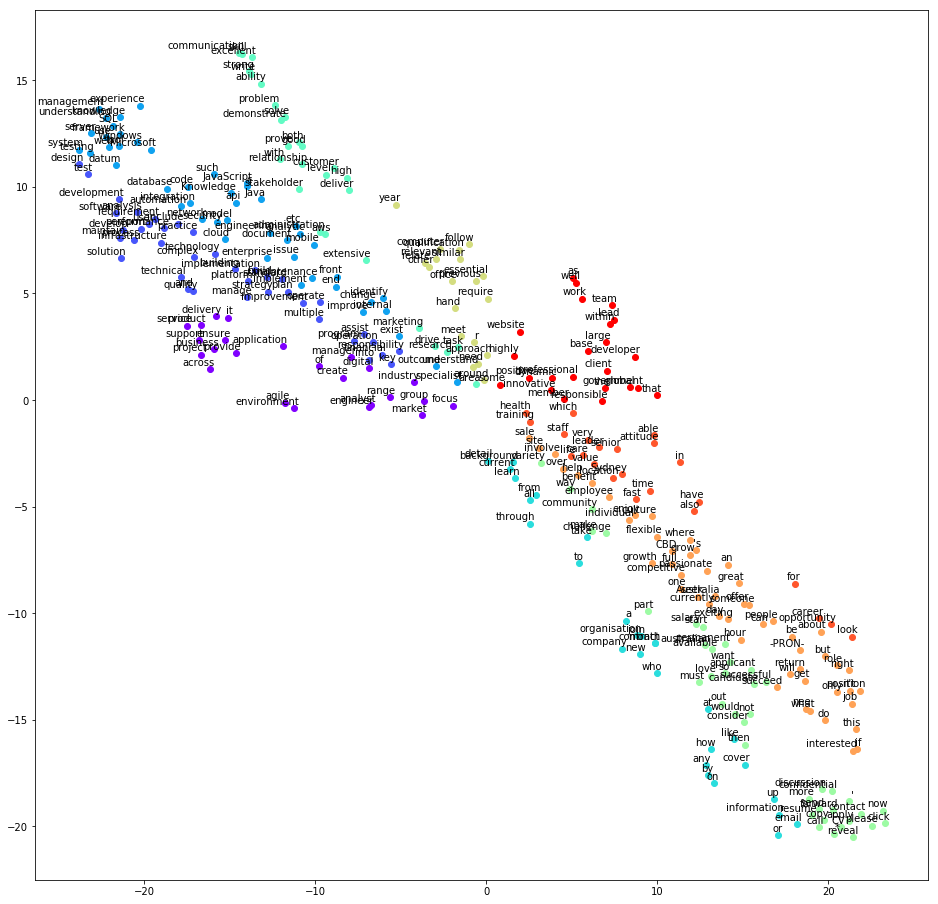

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:13,  2.32s/it]
188it [04:43,  1.24s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


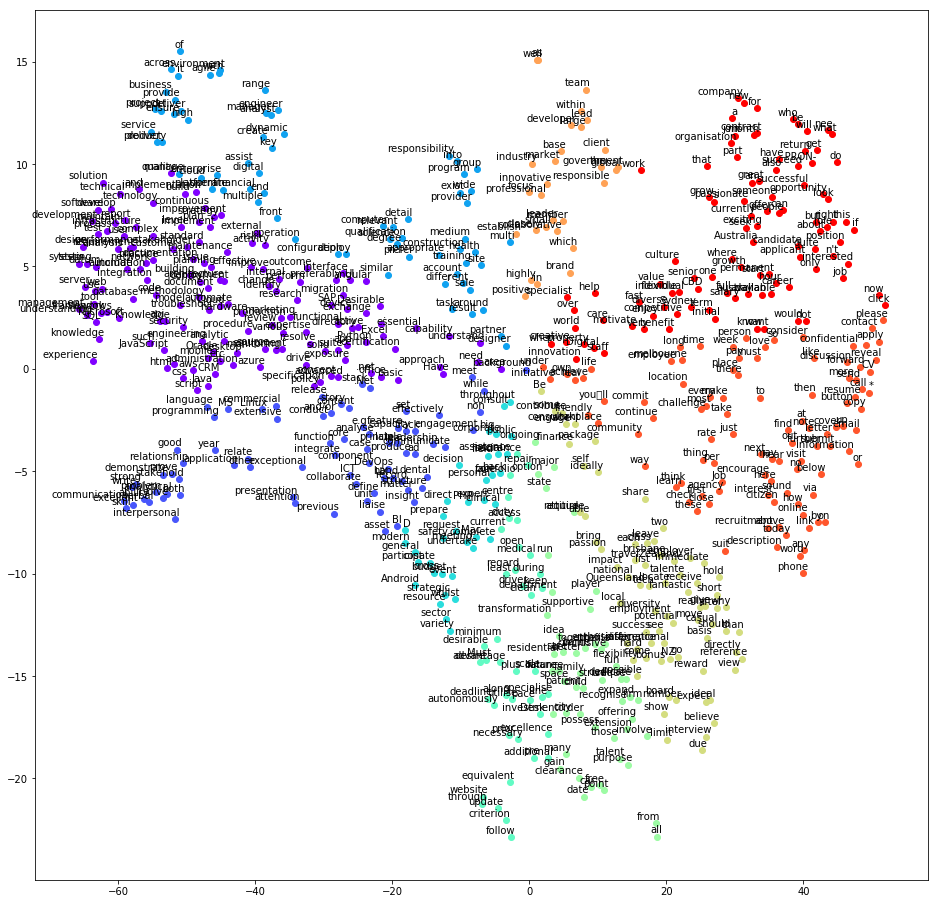

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:13,  2.32s/it]
188it [04:43,  1.24s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


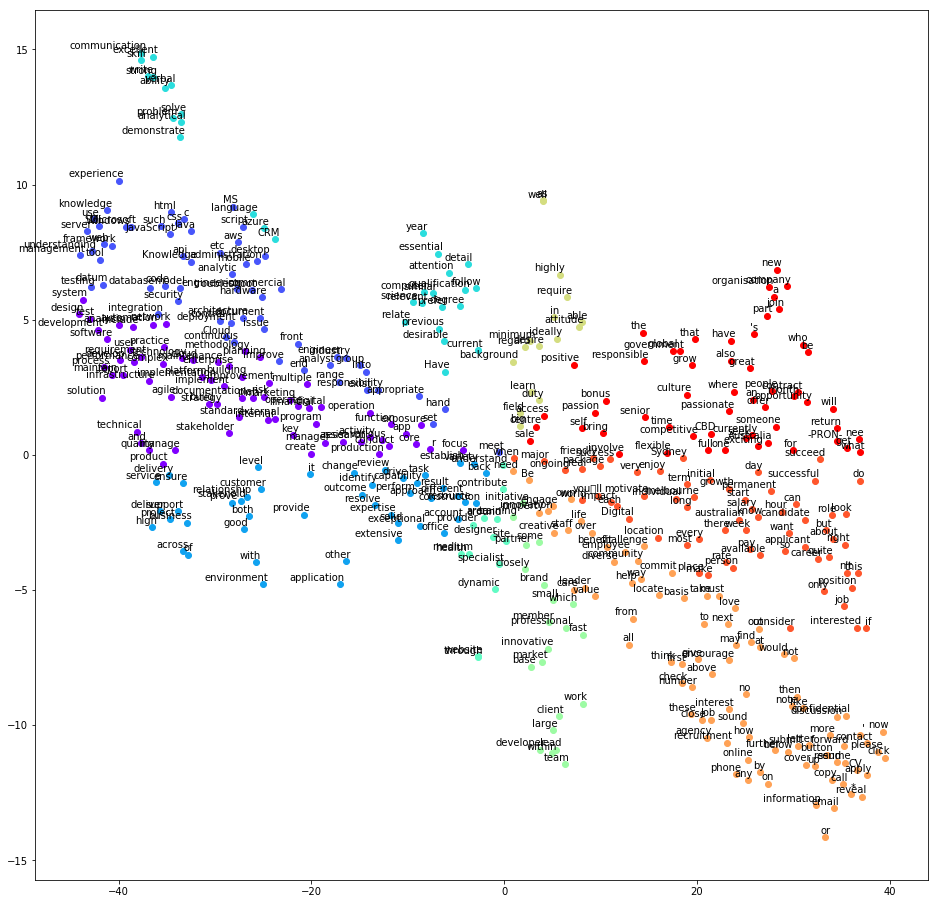

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:12,  2.34s/it]
188it [04:43,  1.24s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


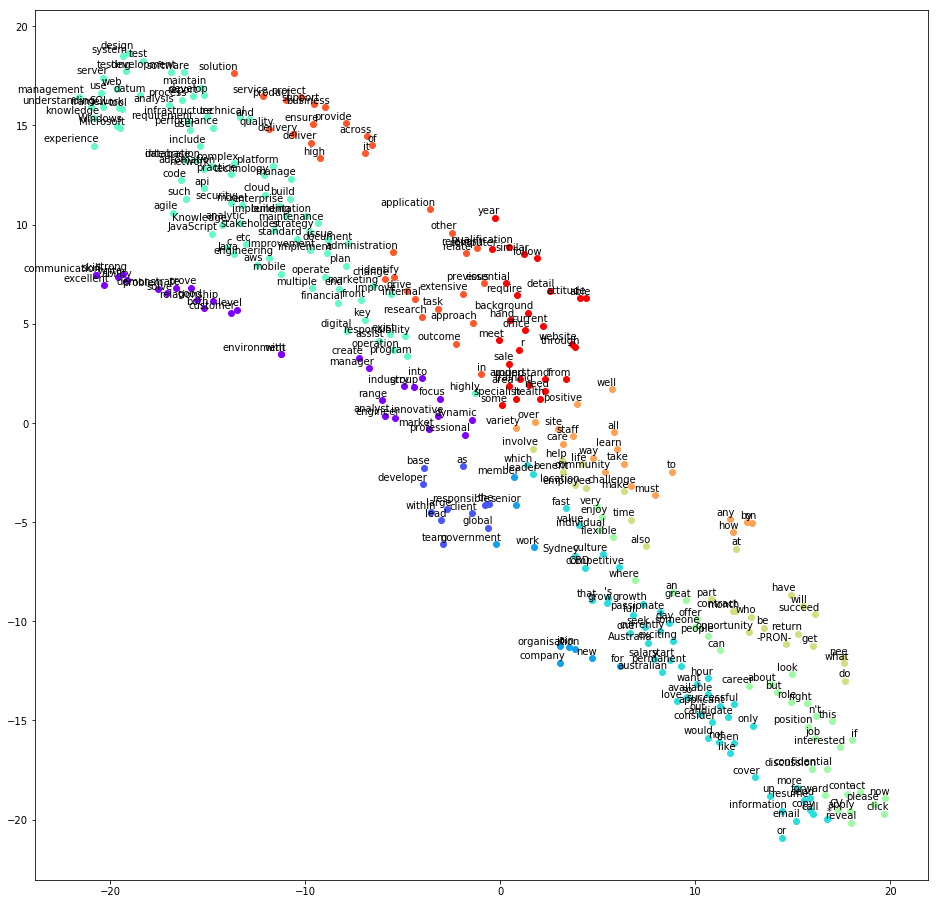

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:01, 172.30it/s]
188it [00:00, 232.23it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


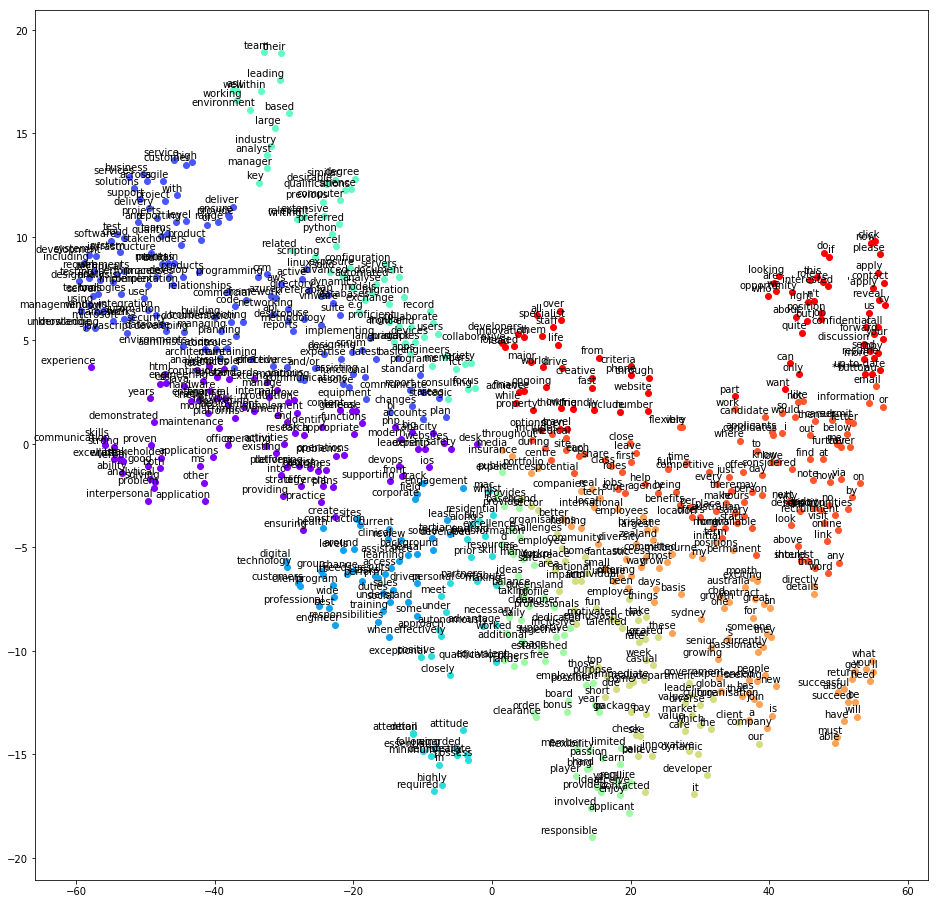

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('aws', 0.9984427690505981), ('framework', 0.9973234534263611), ('.net', 0.9972656965255737), ('programming', 0.9962990880012512), ('linux', 0.9960435628890991)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('windows', 0.9983811378479004), ('using', 0.99741131067276), ('server', 0.9965659379959106), ('tools', 0.9956655502319336), ('knowledge', 0.9944323897361755), ('data', 0.9922202825546265), ('microsoft', 0.9908149242401123), ('understanding', 0.9894922375679016), ('javascript', 0.988915205001831), ('analysis', 0.9885713458061218)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('sql', 0.9983811974525452), ('server', 0.997260570526123), ('tools', 0.9967198371887207), ('using', 0.9965119957923889), ('microsoft', 0.9958368539810181), ('javascript', 0.9923021793365479), ('knowledge', 0.9921503663063049), ('data', 0.9912008047103882), ('technologies', 0.9903638362884521), ('analysis', 0.9892452955245972)]
preprocessing


338it [00:01, 170.69it/s]
188it [00:00, 234.43it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


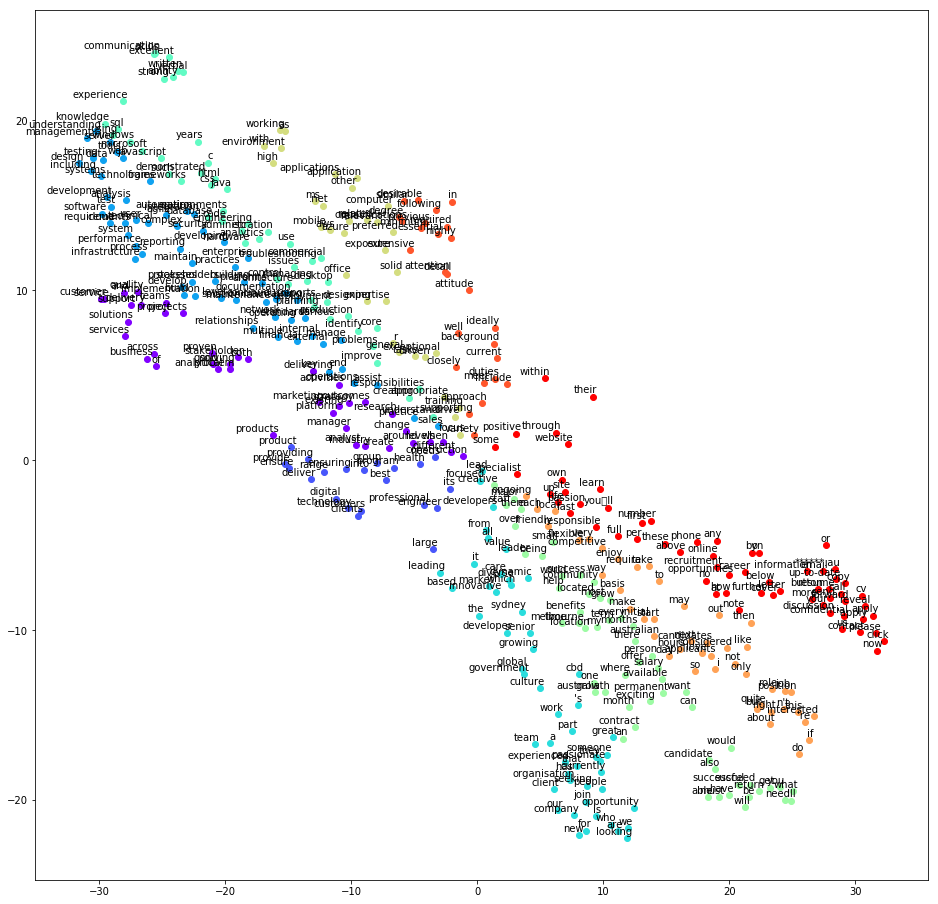

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('html', 0.9968510866165161), ('css', 0.9967949986457825), ('environments', 0.9947429299354553), ('aws', 0.9947149157524109), ('commercial', 0.9929864406585693)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('windows', 0.999129056930542), ('using', 0.9982749223709106), ('server', 0.9981592297554016), ('tools', 0.9955514669418335), ('javascript', 0.995549201965332), ('microsoft', 0.9949198961257935), ('knowledge', 0.9943071603775024), ('c', 0.9915004968643188), ('technologies', 0.9887632131576538), ('web', 0.987879753112793)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('sql', 0.999129056930542), ('server', 0.9985469579696655), ('using', 0.9980751276016235), ('microsoft', 0.9969649314880371), ('tools', 0.9959556460380554), ('javascript', 0.9952896237373352), ('knowledge', 0.9934936761856079), ('c', 0.9914340376853943), ('web', 0.9881550073623657), ('technologies', 0.9875290393829346)]
preprocessing


338it [00:01, 174.25it/s]
188it [00:00, 239.63it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


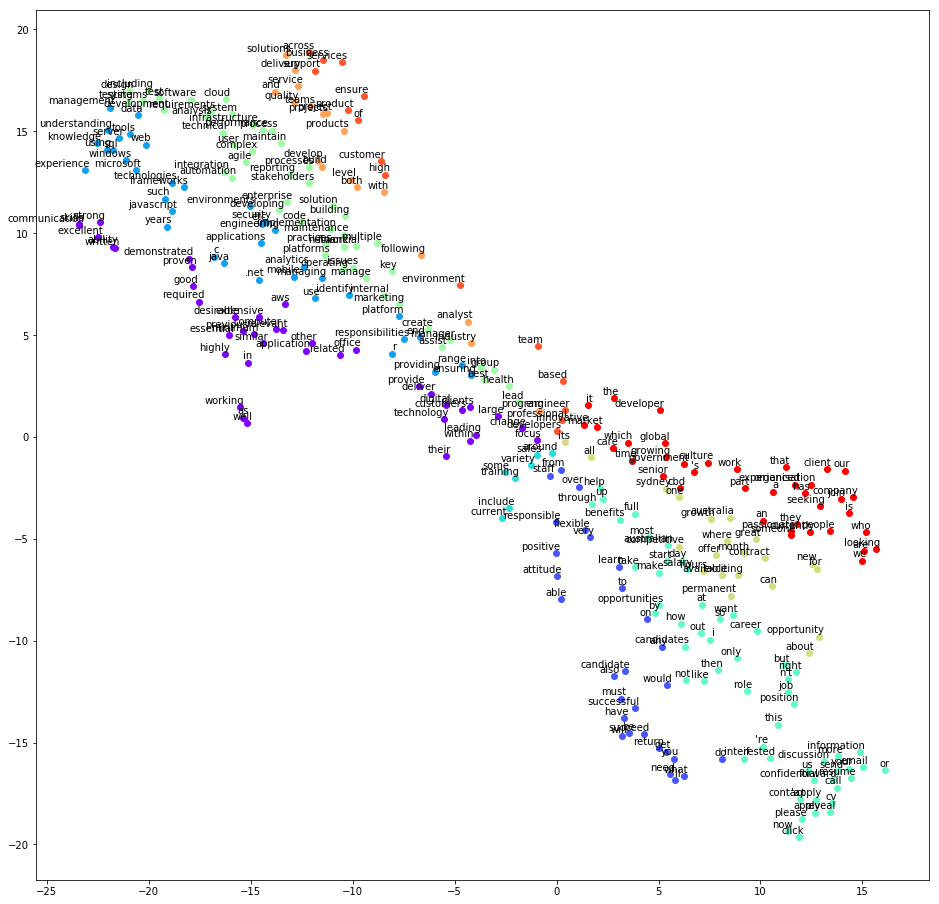

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9936997890472412), ('aws', 0.9935771226882935), ('.net', 0.9923011660575867), ('environments', 0.9907693862915039), ('proven', 0.9888498783111572)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('using', 0.9963184595108032), ('server', 0.9960926175117493), ('windows', 0.9958673119544983), ('microsoft', 0.994999885559082), ('understanding', 0.9939894676208496), ('tools', 0.9934078454971313), ('technologies', 0.9929982423782349), ('javascript', 0.9921228289604187), ('knowledge', 0.9920223951339722), ('such', 0.9917532205581665)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('microsoft', 0.9993607401847839), ('using', 0.9974937438964844), ('server', 0.9968091249465942), ('sql', 0.9958674311637878), ('javascript', 0.9933865070343018), ('tools', 0.9928900599479675), ('knowledge', 0.9927433133125305), ('technologies', 0.9904327392578125), ('understanding', 0.9892665147781372), ('such', 0.9875388145446777)]
preprocessing


338it [00:01, 173.81it/s]
188it [00:00, 238.88it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


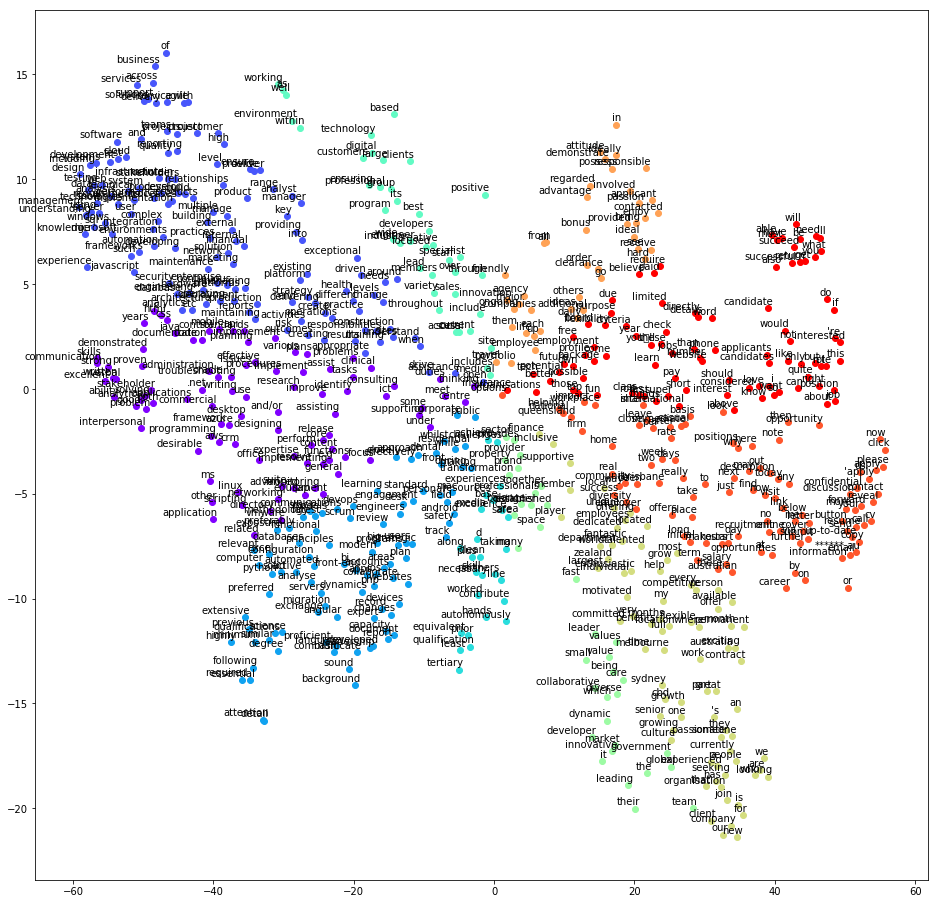

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('css', 0.9983880519866943), ('framework', 0.9977881908416748), ('aws', 0.9974854588508606), ('linux', 0.9964298009872437), ('html', 0.9959731101989746)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('using', 0.9974977970123291), ('tools', 0.9972127079963684), ('server', 0.9971165060997009), ('windows', 0.9959096312522888), ('knowledge', 0.9937033653259277), ('understanding', 0.9934678077697754), ('technologies', 0.9926730394363403), ('testing', 0.9916914105415344), ('microsoft', 0.9903097152709961), ('data', 0.9899728298187256)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9988498687744141), ('tools', 0.997490644454956), ('microsoft', 0.9974855184555054), ('sql', 0.9959096312522888), ('using', 0.9955890774726868), ('technologies', 0.9905805587768555), ('knowledge', 0.9905405044555664), ('javascript', 0.9901112914085388), ('web', 0.9880125522613525), ('testing', 0.9876165986061096)]
preprocessing


338it [00:02, 154.51it/s]
188it [00:00, 235.42it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


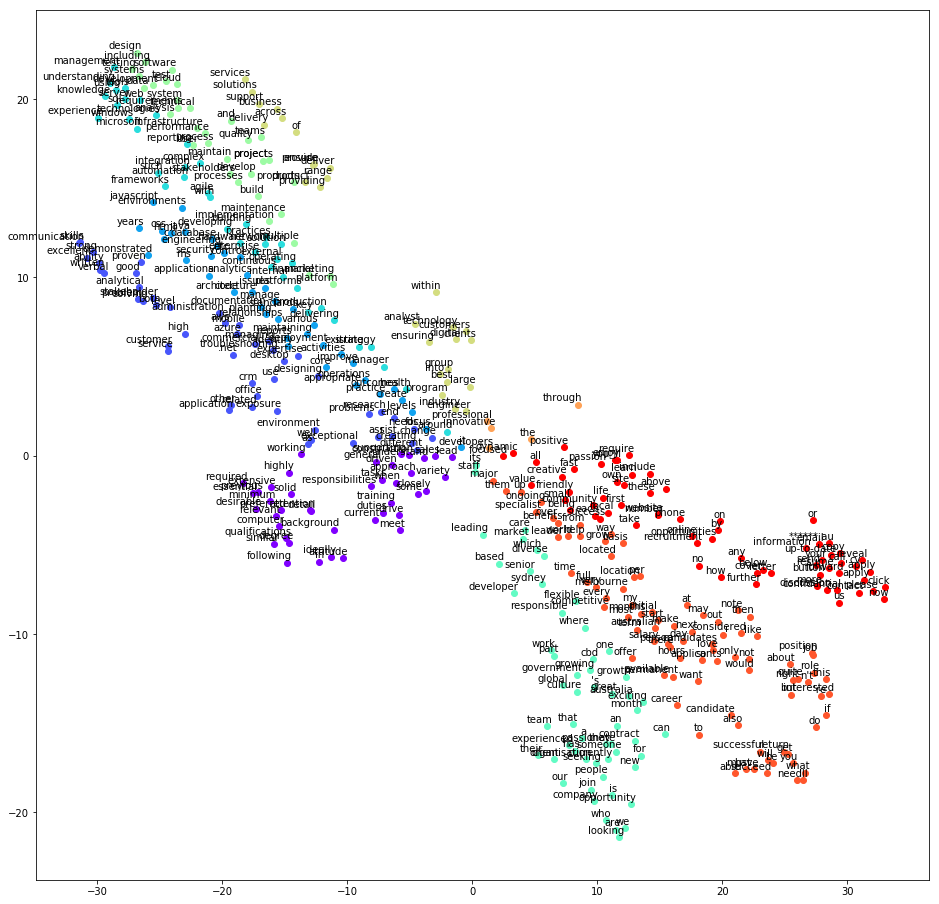

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('azure', 0.9958282113075256), ('aws', 0.9957836866378784), ('environments', 0.9956046938896179), ('html', 0.9942616820335388), ('mobile', 0.9931979775428772)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('windows', 0.9970965385437012), ('using', 0.9966768026351929), ('server', 0.9958169460296631), ('tools', 0.9956691265106201), ('knowledge', 0.9942240715026855), ('microsoft', 0.9915321469306946), ('understanding', 0.9912596940994263), ('javascript', 0.9893600940704346), ('technologies', 0.983252227306366), ('c', 0.9822824597358704)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.997910737991333), ('sql', 0.9970966577529907), ('microsoft', 0.9970022439956665), ('tools', 0.9946097731590271), ('using', 0.9930851459503174), ('knowledge', 0.9912375211715698), ('javascript', 0.9911713600158691), ('understanding', 0.9852306246757507), ('technologies', 0.9849047660827637), ('c', 0.9846436381340027)]
preprocessing


338it [00:02, 162.73it/s]
188it [00:00, 234.42it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


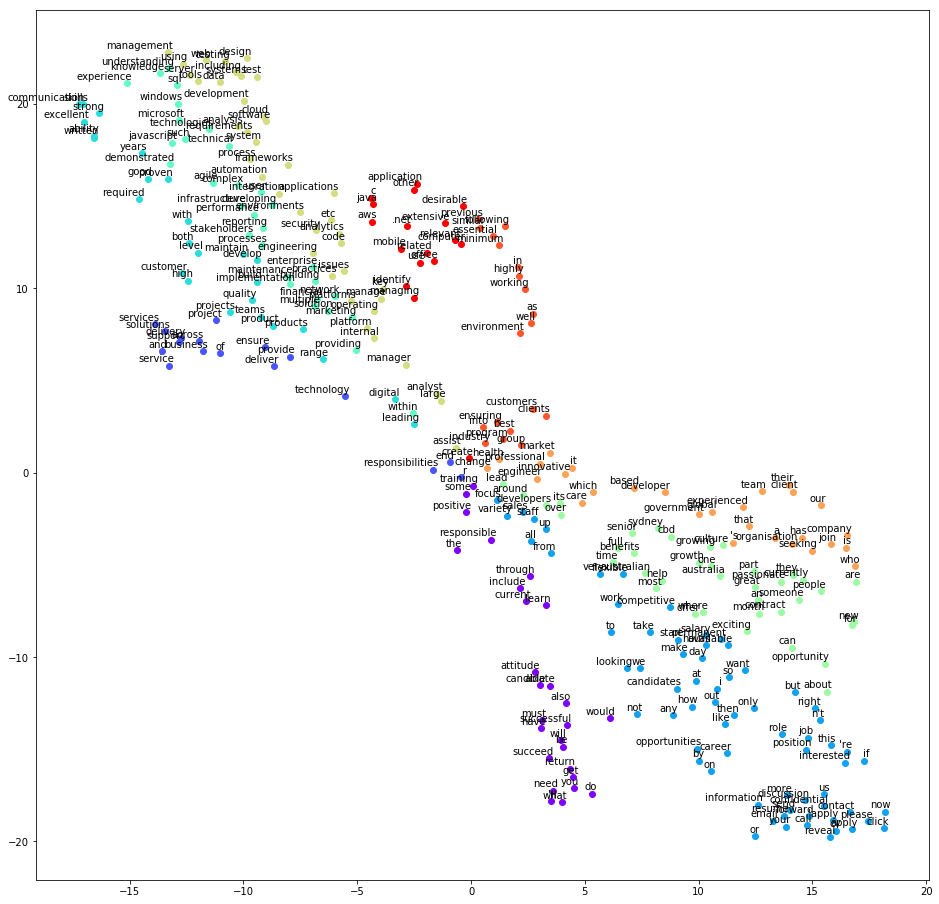

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9967530369758606), ('aws', 0.9964181184768677), ('frameworks', 0.9930281639099121), ('extensive', 0.9904888868331909), ('environments', 0.9876461029052734)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('windows', 0.9971833229064941), ('server', 0.9971250295639038), ('using', 0.9960107207298279), ('microsoft', 0.9952143430709839), ('tools', 0.9945226907730103), ('javascript', 0.9934831857681274), ('such', 0.9920833110809326), ('understanding', 0.9920781850814819), ('knowledge', 0.9918737411499023), ('technologies', 0.9914305210113525)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('microsoft', 0.9985231161117554), ('sql', 0.9971833229064941), ('server', 0.9953333139419556), ('javascript', 0.9936527013778687), ('using', 0.9929956793785095), ('knowledge', 0.9927637577056885), ('tools', 0.9926990270614624), ('such', 0.989533543586731), ('understanding', 0.9882770776748657), ('technologies', 0.9854729175567627)]
preprocessing


338it [12:16,  2.36s/it]
188it [04:42,  1.24s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


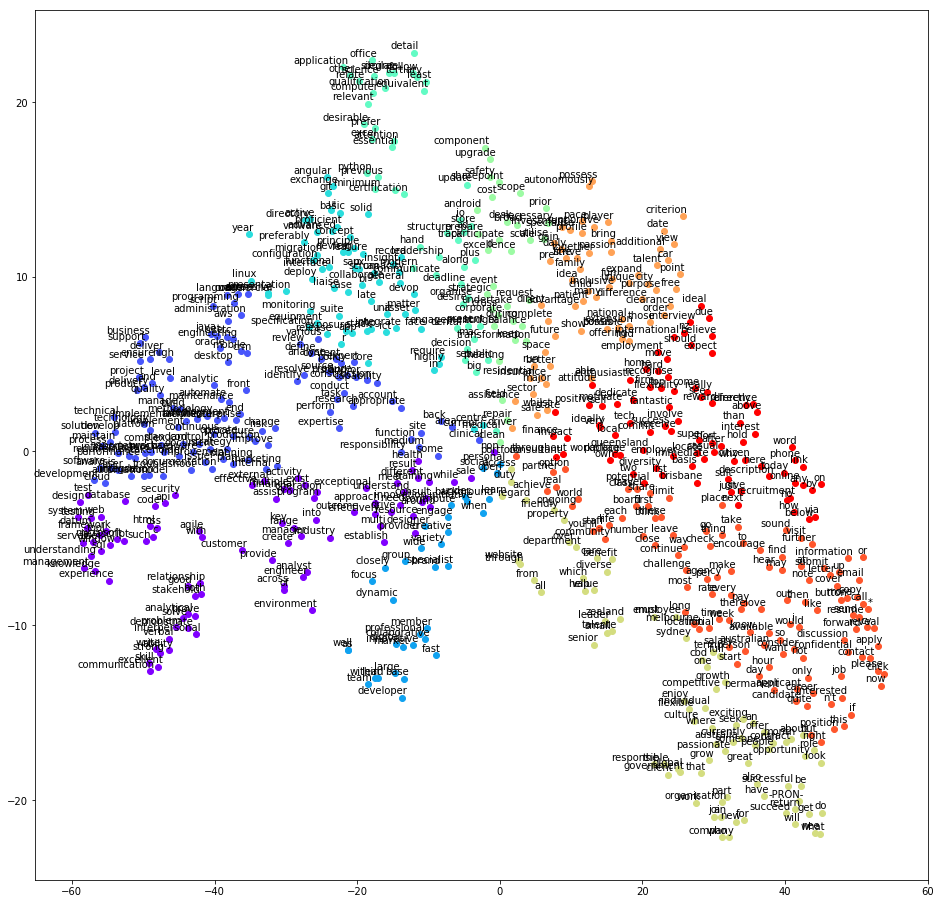

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.9976462721824646), ('language', 0.9970411062240601), ('azure', 0.9966387748718262), ('programming', 0.9954721331596375), ('aws', 0.9953951239585876)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('framework', 0.998266339302063), ('tool', 0.9959264397621155), ('microsoft', 0.9950388669967651), ('window', 0.994936466217041), ('use', 0.9944028258323669), ('javascript', 0.9943279027938843), ('server', 0.9933820962905884), ('knowledge', 0.9927042722702026), ('understanding', 0.9923606514930725), ('testing', 0.9890625476837158)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:11,  2.29s/it]
188it [04:43,  1.24s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


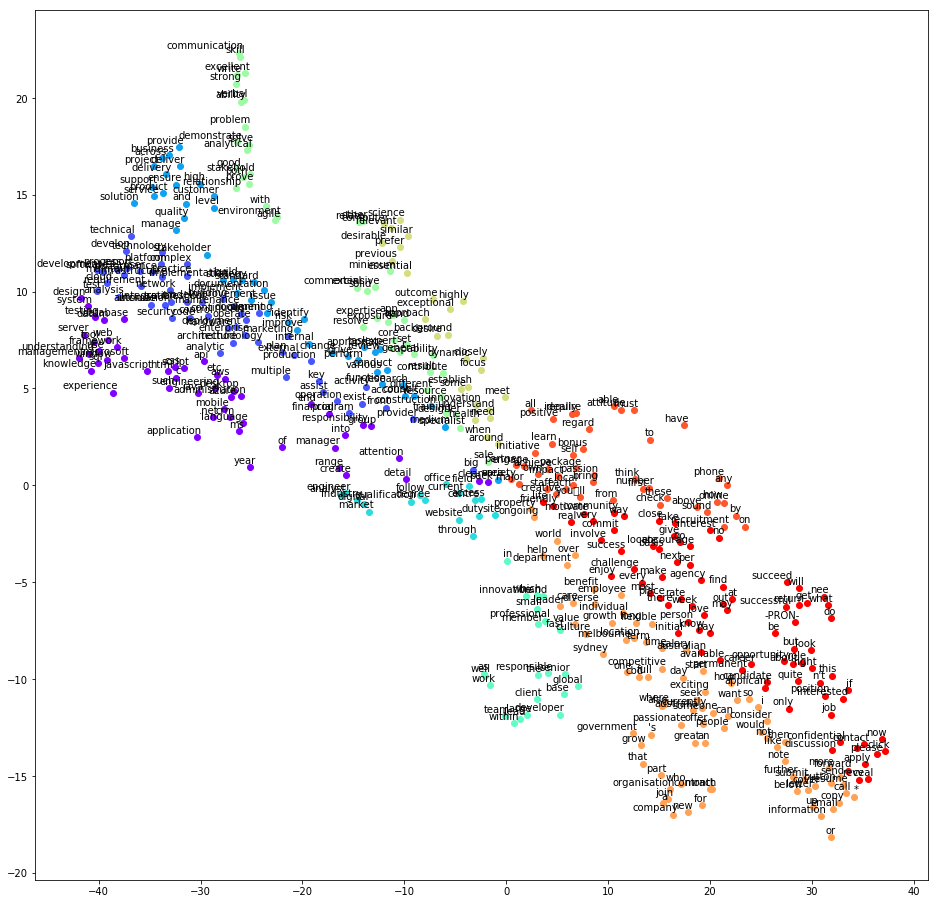

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('azure', 0.9935566782951355), ('aws', 0.9929088354110718), ('.net', 0.9928440451622009), ('script', 0.9899090528488159), ('etc', 0.9895603656768799)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('window', 0.9978350400924683), ('tool', 0.9970307350158691), ('use', 0.9961461424827576), ('server', 0.9947096109390259), ('understanding', 0.9932504892349243), ('framework', 0.9930922389030457), ('knowledge', 0.9930261373519897), ('microsoft', 0.9921888113021851), ('javascript', 0.989666759967804), ('c', 0.9846429228782654)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:12,  2.31s/it]
188it [04:43,  1.27s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


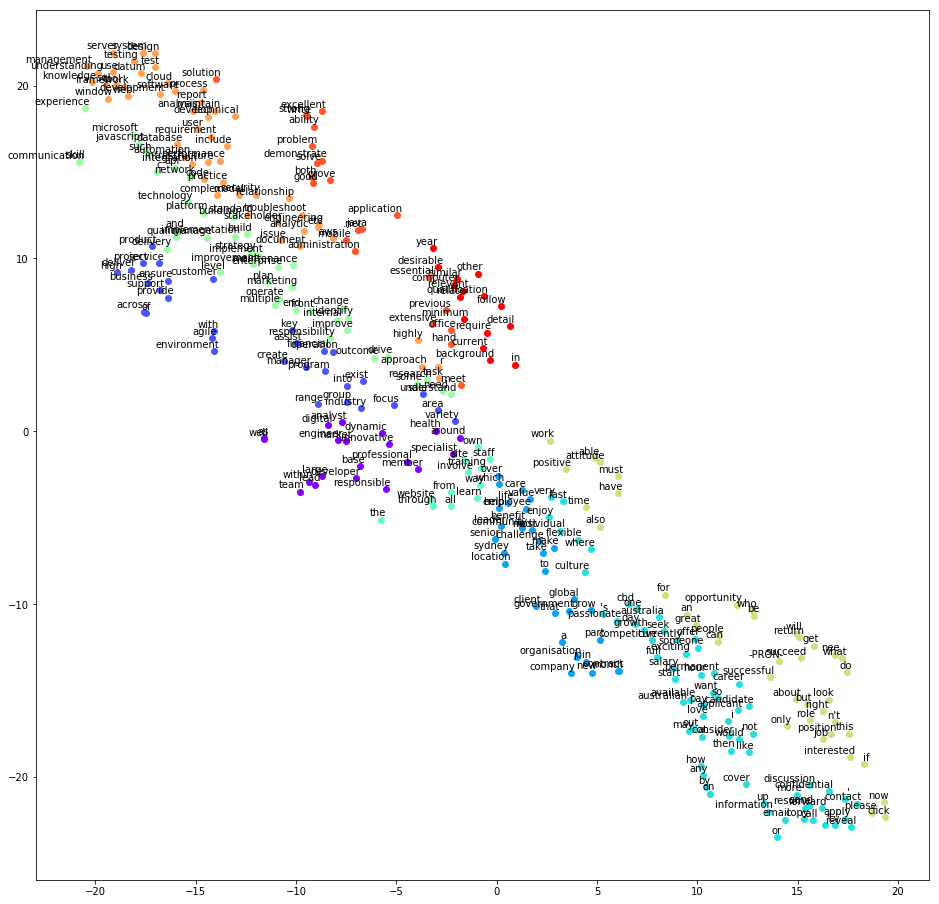

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.9949029684066772), ('administration', 0.9924538135528564), ('aws', 0.9870209097862244), ('engineering', 0.9870097637176514), ('etc', 0.9869703650474548)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('window', 0.997298538684845), ('tool', 0.9972928762435913), ('framework', 0.9965494871139526), ('use', 0.9952901005744934), ('server', 0.9952152967453003), ('javascript', 0.9939639568328857), ('microsoft', 0.9930618405342102), ('knowledge', 0.9922977685928345), ('understanding', 0.990220308303833), ('c', 0.9898538589477539)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:13,  2.29s/it]
188it [04:42,  1.23s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


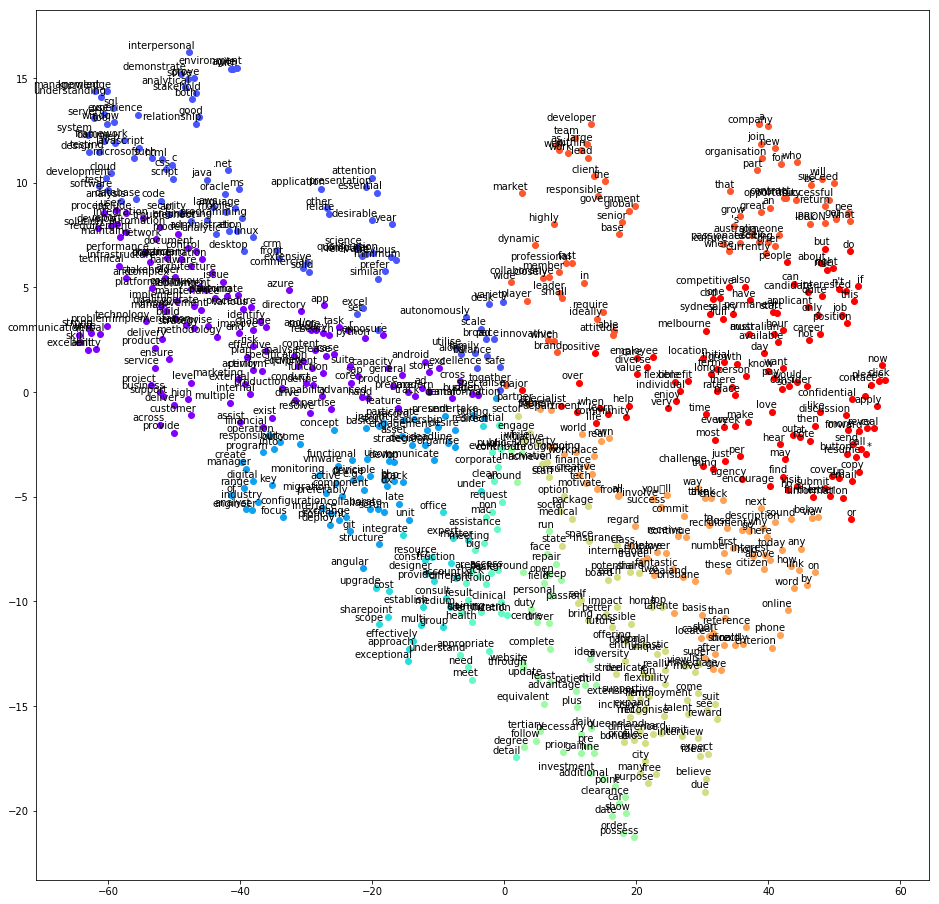

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('linux', 0.9962617754936218), ('aws', 0.995885968208313), ('c', 0.9954970479011536), ('language', 0.99400794506073), ('programming', 0.9939977526664734)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('framework', 0.9977984428405762), ('window', 0.9975773096084595), ('tool', 0.996216356754303), ('use', 0.9944272637367249), ('server', 0.9942274689674377), ('microsoft', 0.9938619136810303), ('knowledge', 0.9932870864868164), ('javascript', 0.9932710528373718), ('understanding', 0.9906820058822632), ('testing', 0.9865471720695496)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:12,  2.48s/it]
188it [04:42,  1.24s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


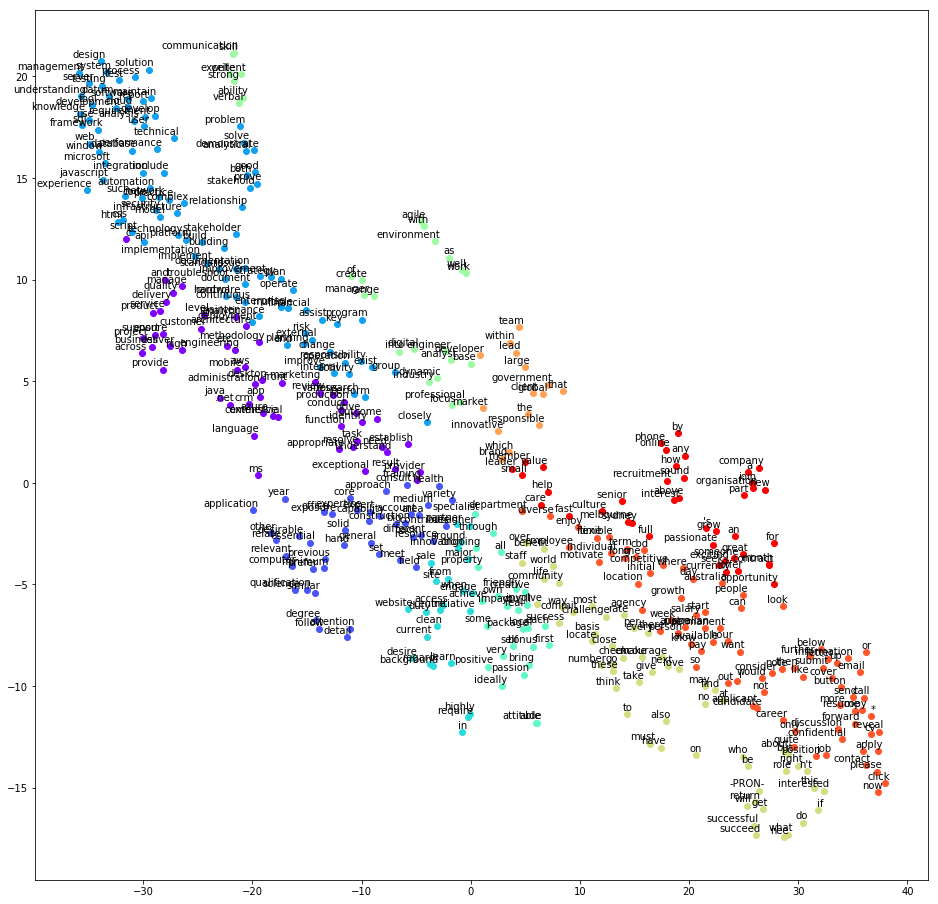

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.9967395067214966), ('language', 0.9931128025054932), ('aws', 0.9926542639732361), ('azure', 0.9917755126953125), ('crm', 0.9909236431121826)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('knowledge', 0.9983099699020386), ('window', 0.9961730241775513), ('javascript', 0.9949167966842651), ('framework', 0.9948872327804565), ('tool', 0.9947723150253296), ('microsoft', 0.9938714504241943), ('use', 0.9938064813613892), ('understanding', 0.9926471710205078), ('server', 0.9924775958061218), ('web', 0.9850856065750122)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [14:37,  2.77s/it]
188it [05:42,  1.51s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


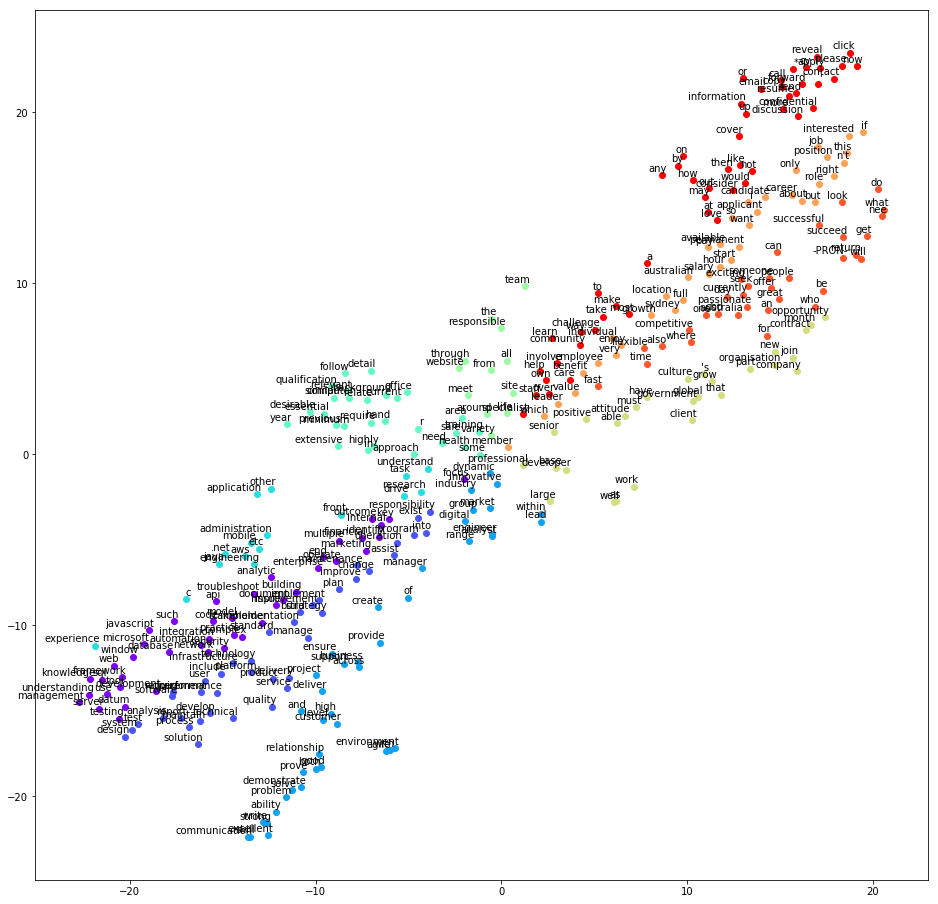

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.9958839416503906), ('aws', 0.9948983192443848), ('mobile', 0.9872538447380066), ('etc', 0.9869554042816162), ('administration', 0.9868148565292358)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('framework', 0.996795654296875), ('window', 0.9961360692977905), ('tool', 0.9943469762802124), ('knowledge', 0.9941284656524658), ('server', 0.9940499663352966), ('use', 0.9918317794799805), ('javascript', 0.9914638996124268), ('microsoft', 0.9909026622772217), ('understanding', 0.9903910160064697), ('c', 0.9888861179351807)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [01:02,  5.13it/s]
188it [00:23,  7.88it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


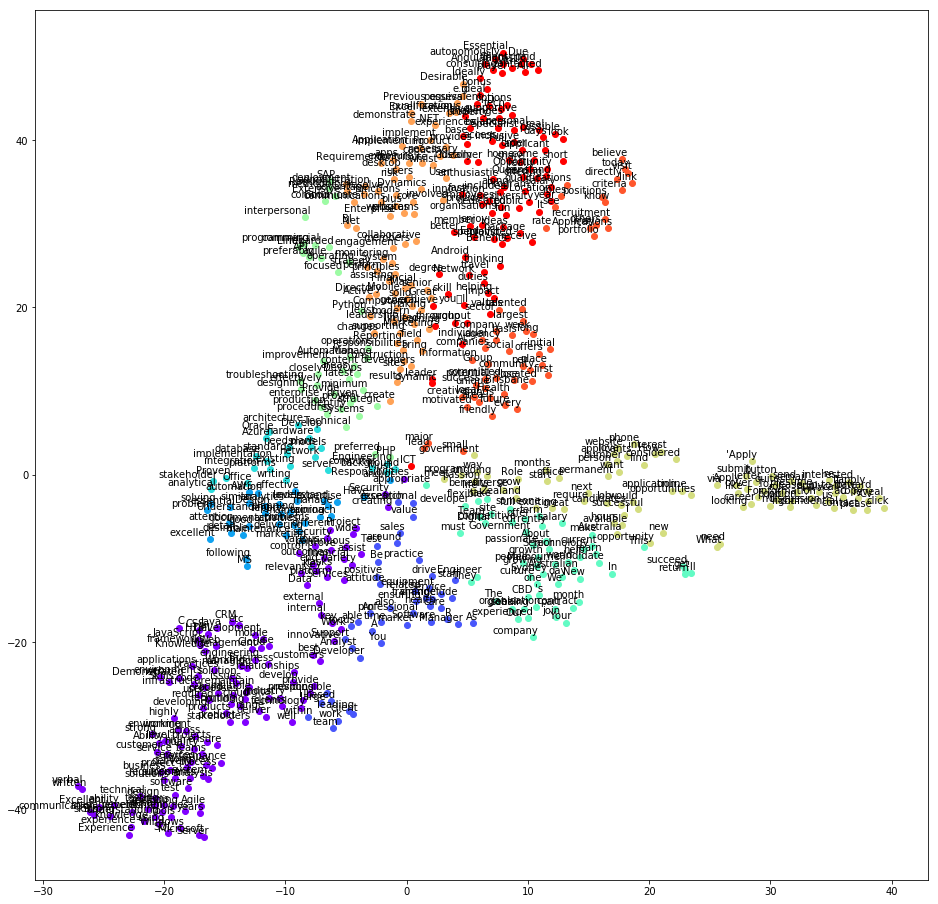

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [01:02,  5.09it/s]
188it [00:24,  7.36it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


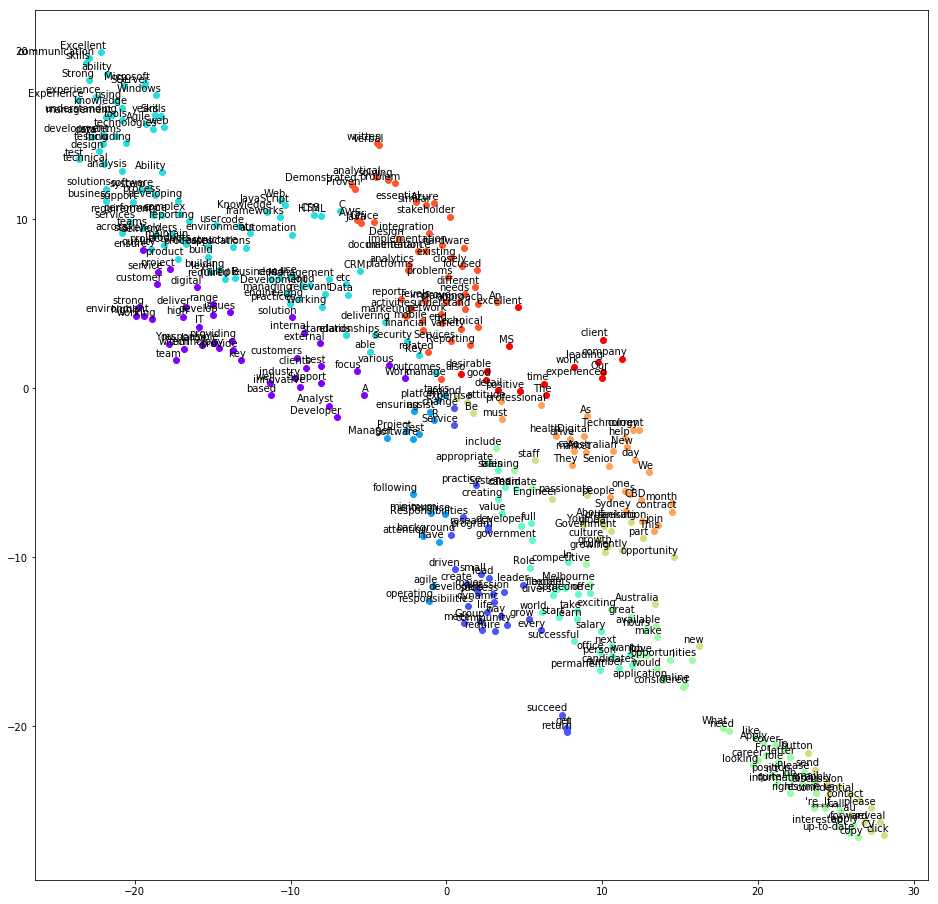

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [01:03,  5.07it/s]
188it [00:24,  7.51it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


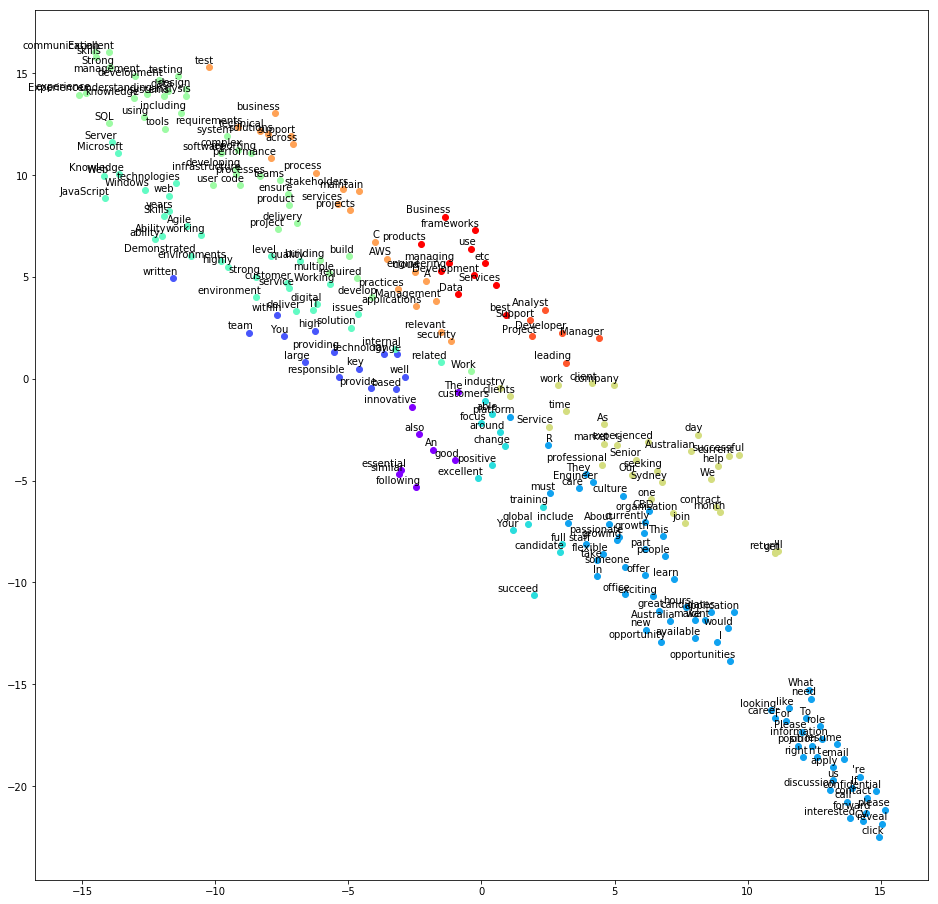

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [01:04,  4.94it/s]
188it [00:24,  7.41it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


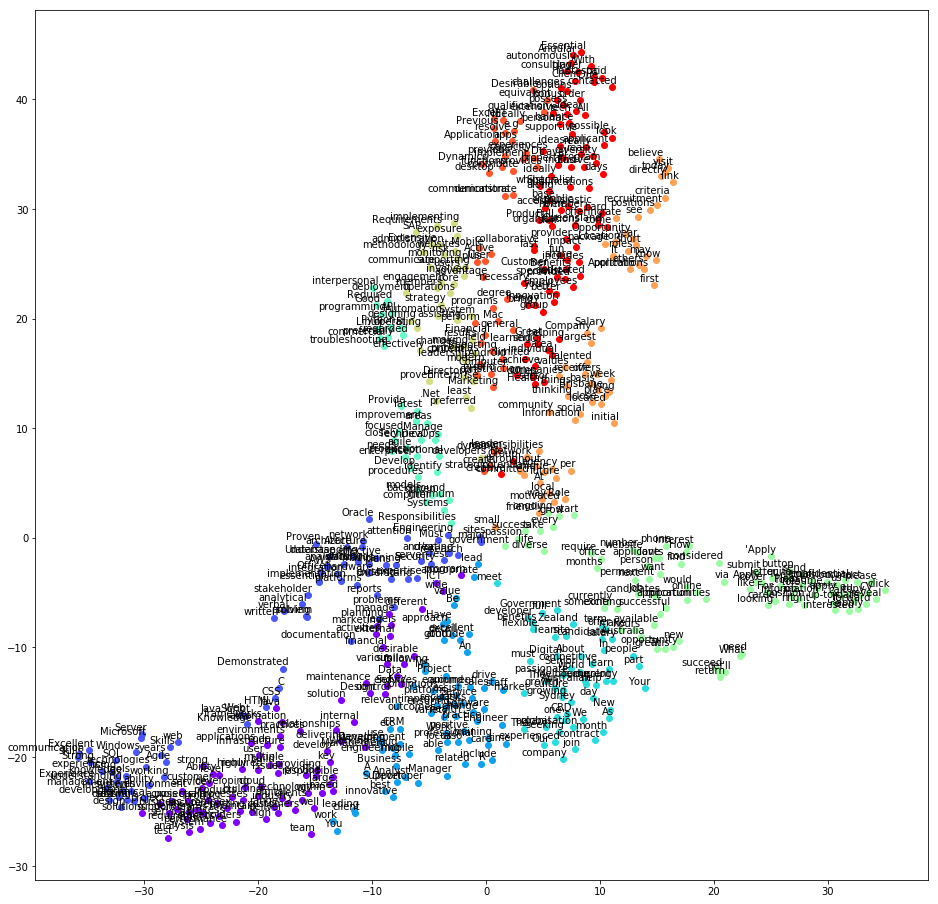

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [01:02,  4.96it/s]
188it [00:25,  7.42it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


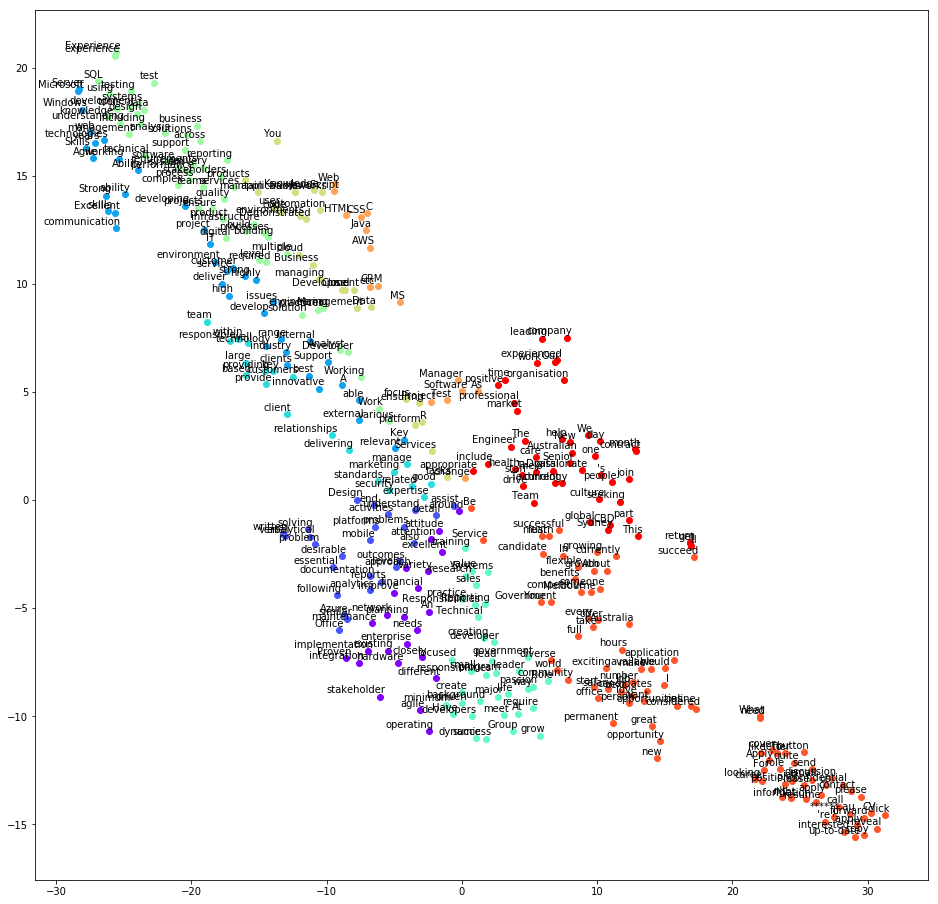

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [01:04,  5.02it/s]
188it [00:24,  7.45it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


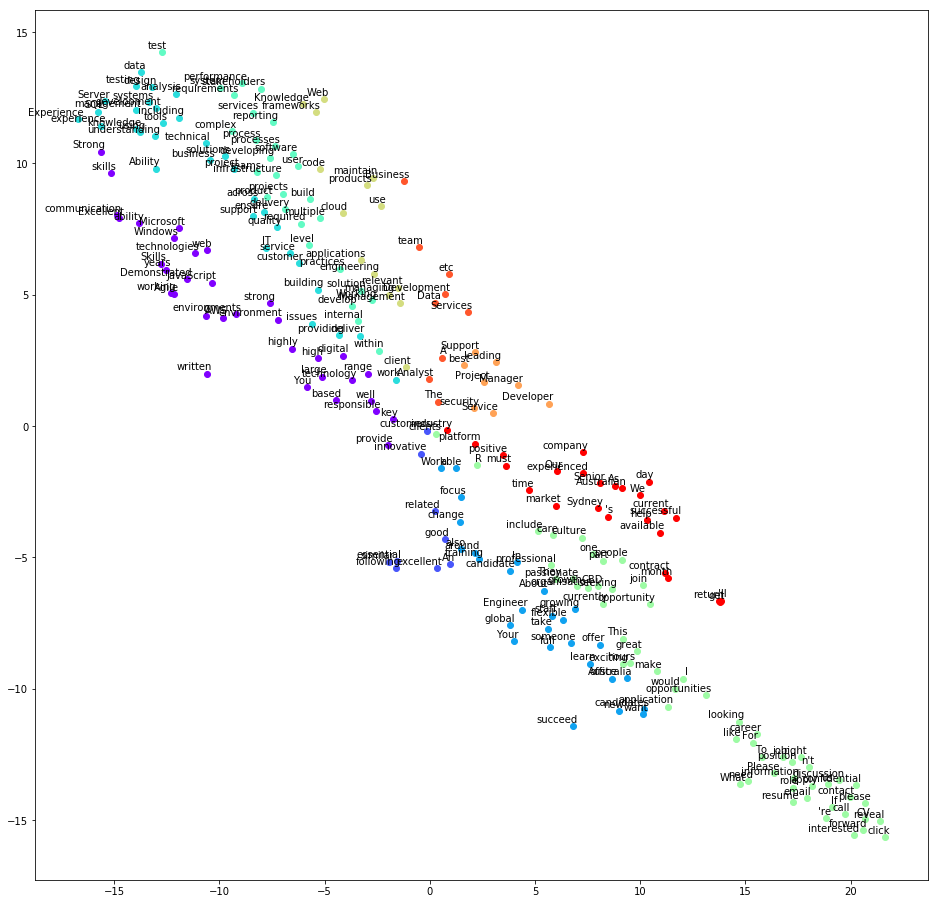

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [14:53,  2.64s/it]
188it [05:20,  1.40s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


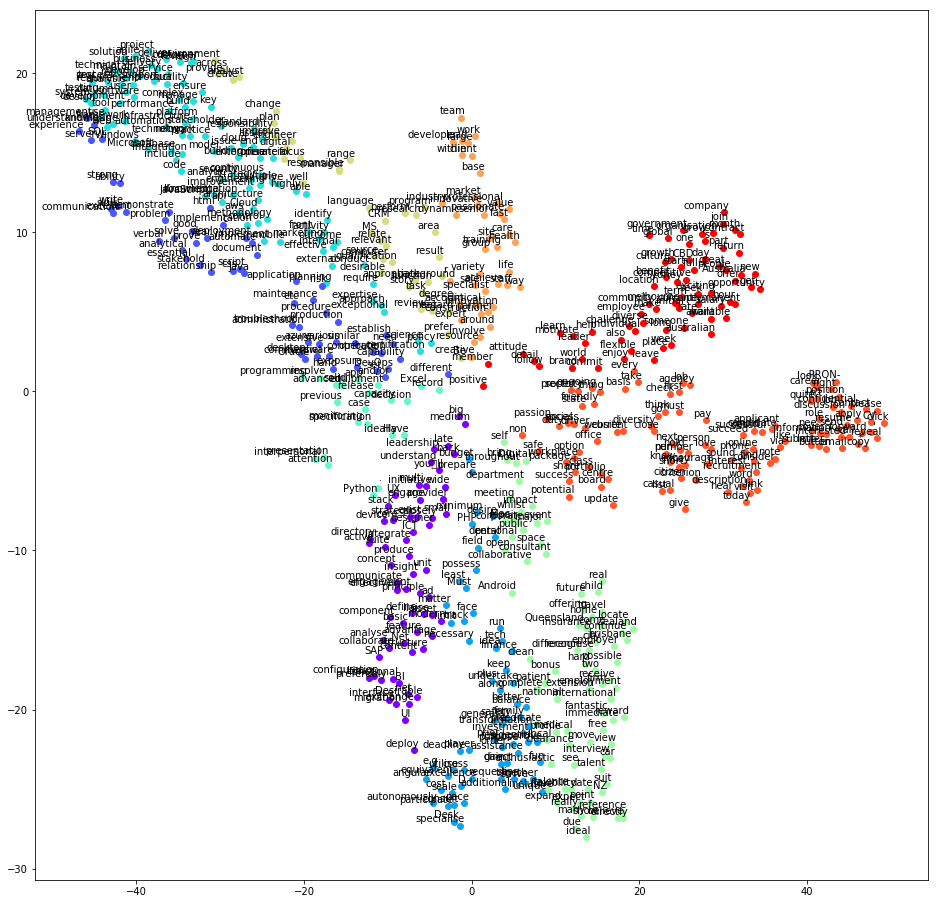

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:55,  2.69s/it]
188it [05:21,  1.42s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


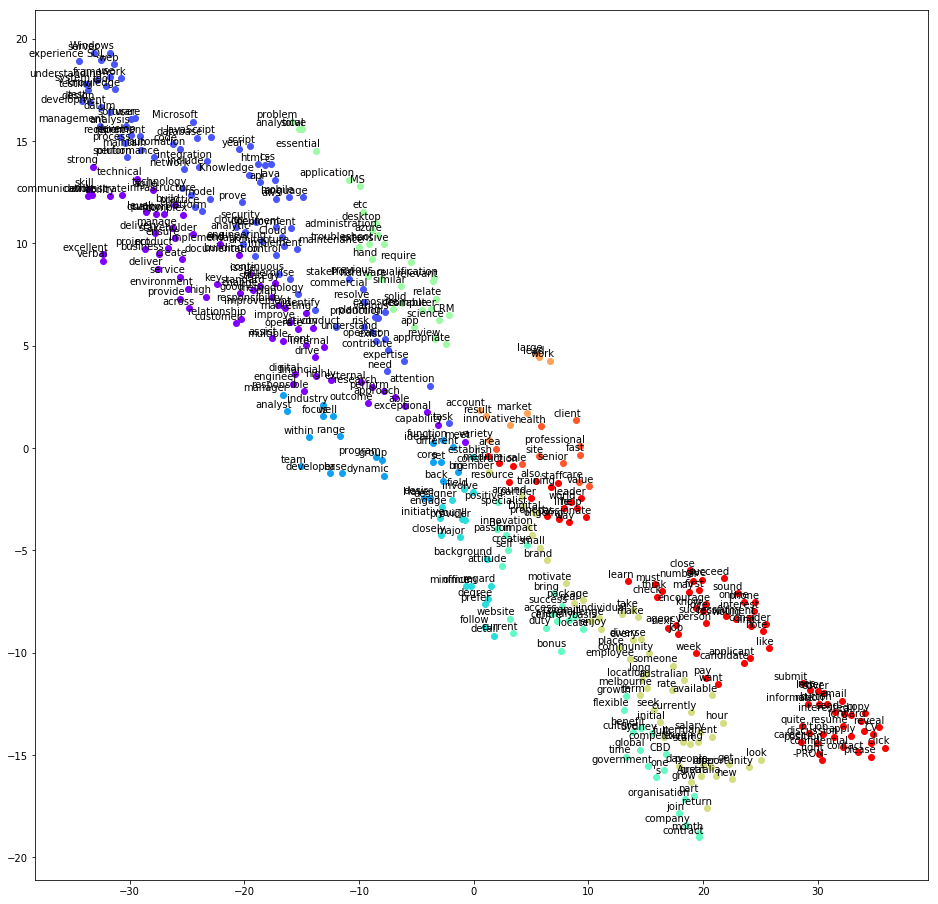

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:51,  2.65s/it]
188it [05:21,  1.40s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


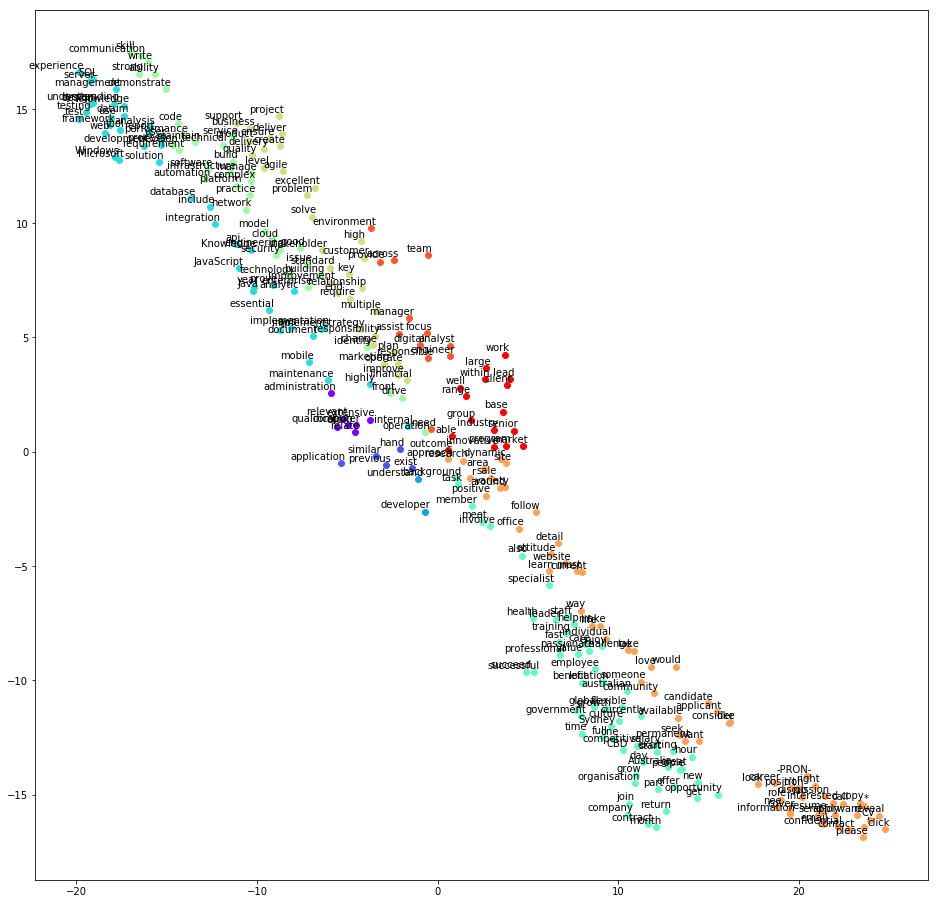

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:56,  2.69s/it]
188it [05:23,  1.42s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


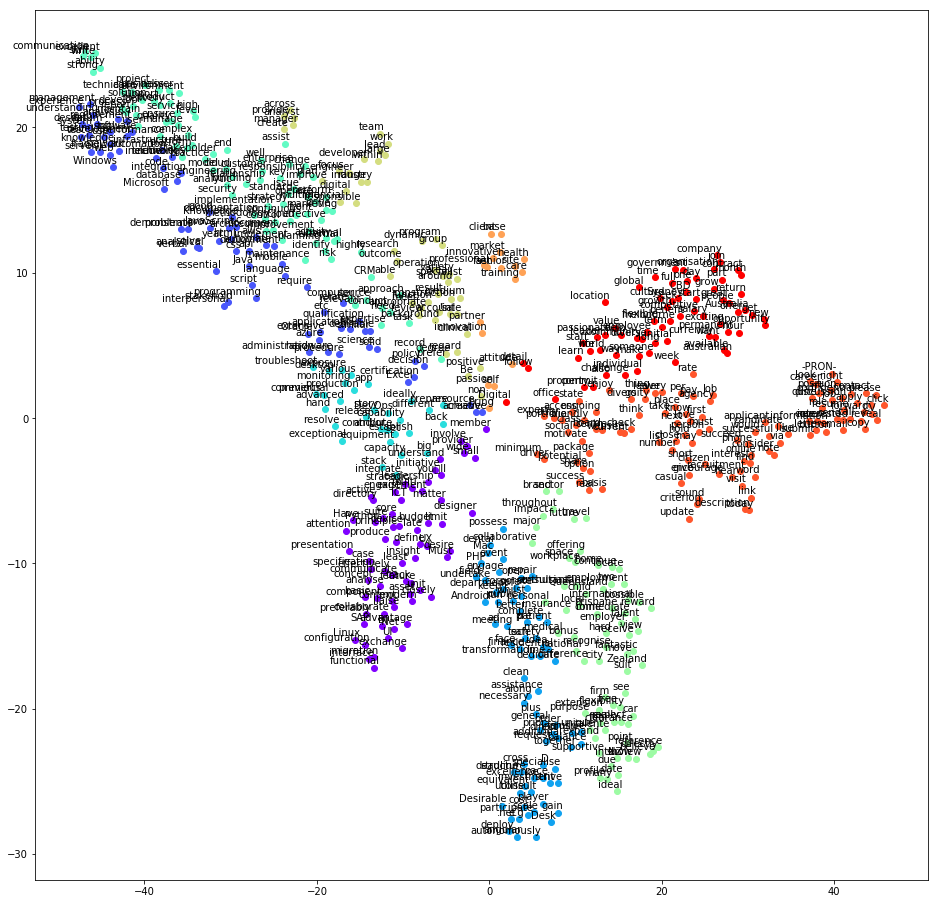

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:56,  2.63s/it]
188it [05:20,  1.42s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


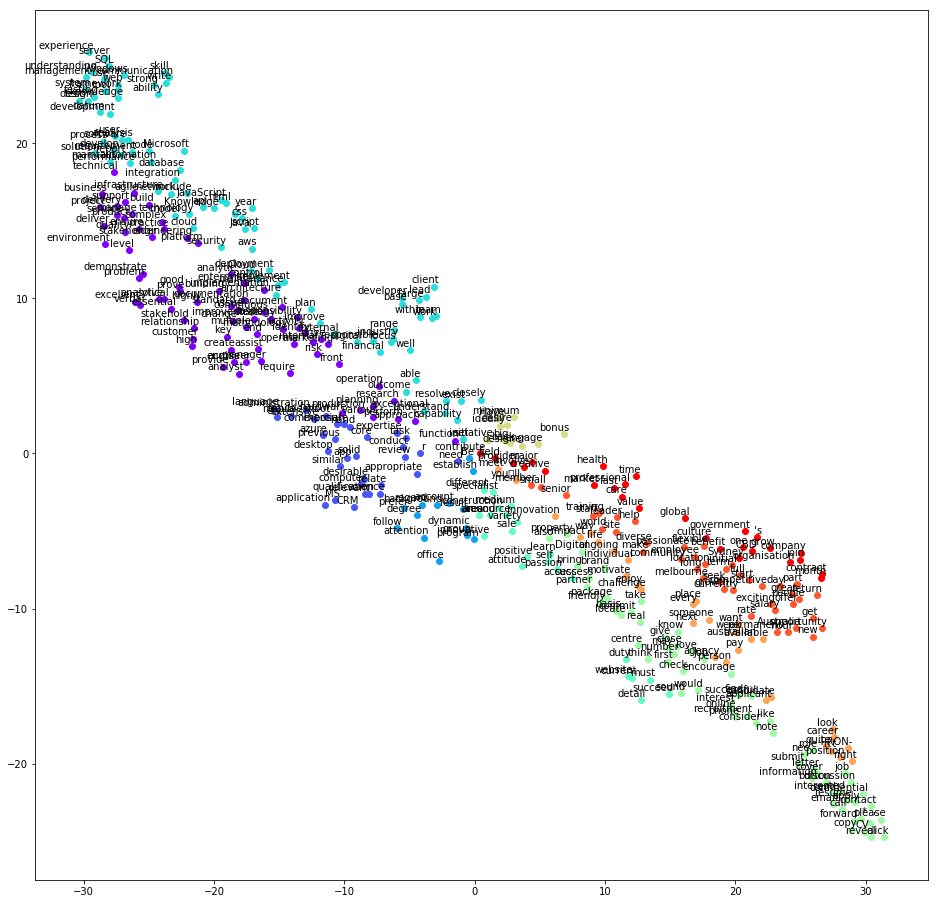

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:51,  2.62s/it]
188it [05:23,  1.41s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


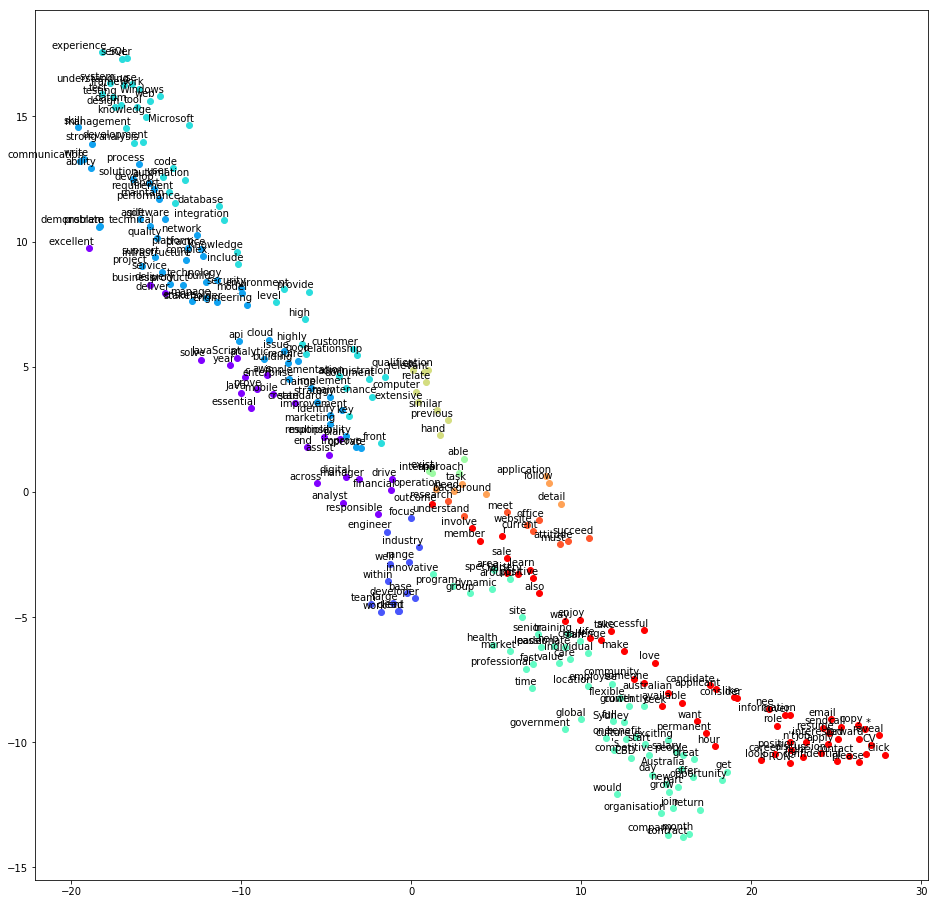

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:53,  5.54it/s]
188it [00:20,  8.96it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


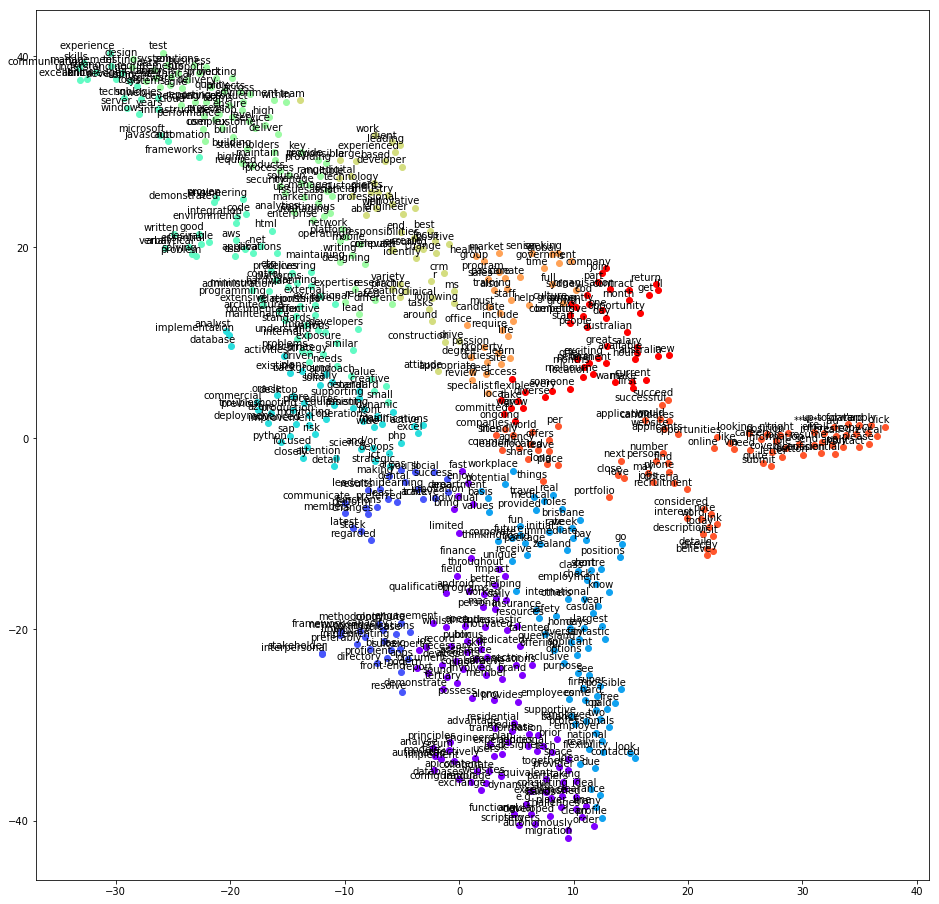

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('html', 0.9993712902069092), ('.net', 0.9992867708206177), ('linux', 0.999247670173645), ('framework', 0.9992268681526184), ('scripting', 0.9992033243179321)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9983353018760681), ('web', 0.9977967739105225), ('tools', 0.9966220855712891), ('windows', 0.9966148138046265), ('using', 0.9965798258781433), ('knowledge', 0.9956332445144653), ('understanding', 0.9944096803665161), ('technologies', 0.9942479133605957), ('years', 0.9937829375267029), ('development', 0.9936755895614624)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9985356330871582), ('microsoft', 0.9979146122932434), ('technologies', 0.996977686882019), ('web', 0.9969047904014587), ('sql', 0.996614933013916), ('tools', 0.9963313341140747), ('years', 0.9960049390792847), ('systems', 0.9956698417663574), ('javascript', 0.9954553842544556), ('including', 0.9951058030128479)]
preprocessing


338it [00:53,  5.55it/s]
188it [00:20,  8.87it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


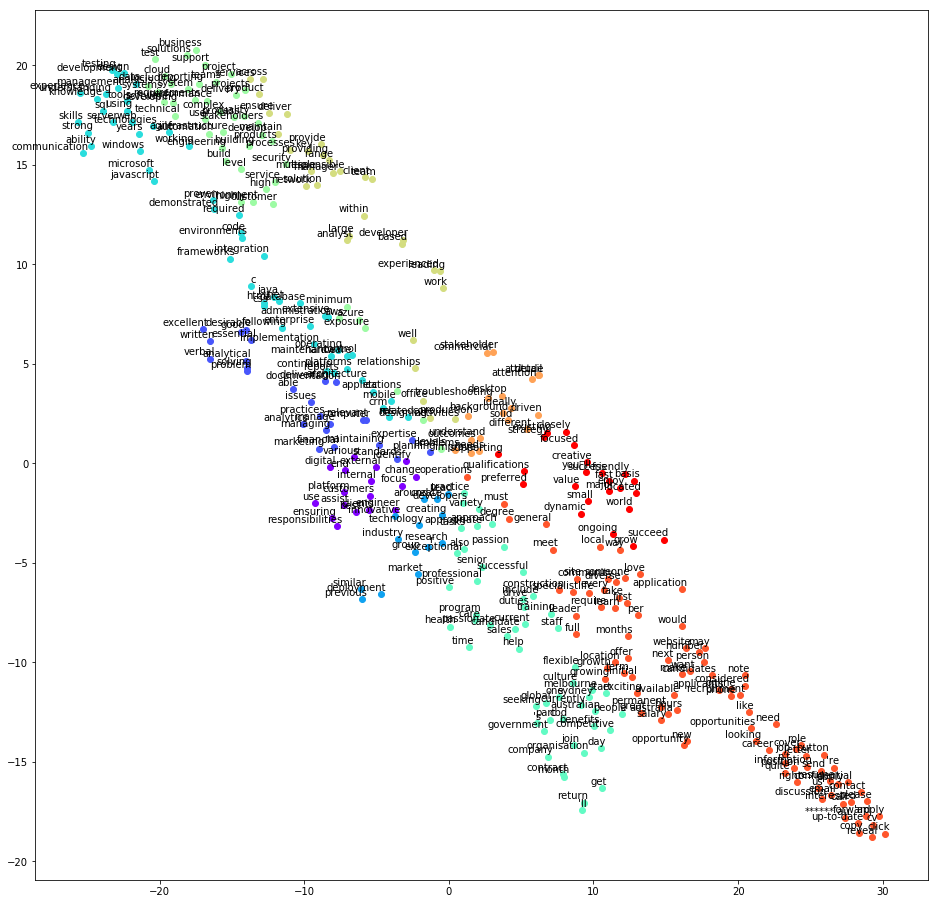

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.9992576837539673), ('c', 0.9991753101348877), ('extensive', 0.998981237411499), ('database', 0.9988665580749512), ('html', 0.9988113045692444)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('knowledge', 0.9967625141143799), ('server', 0.9966659545898438), ('understanding', 0.996288001537323), ('using', 0.9951227307319641), ('web', 0.9943922162055969), ('tools', 0.9942299127578735), ('windows', 0.9922503232955933), ('years', 0.9921206831932068), ('development', 0.9921033978462219), ('testing', 0.9916596412658691)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('microsoft', 0.9983535408973694), ('server', 0.9979852437973022), ('technologies', 0.9976314902305603), ('web', 0.9974237680435181), ('tools', 0.9970301389694214), ('using', 0.9970283508300781), ('years', 0.9968818426132202), ('javascript', 0.9961233139038086), ('including', 0.9960628747940063), ('systems', 0.9960541725158691)]
preprocessing


338it [01:05,  5.10it/s]
188it [00:24,  7.71it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


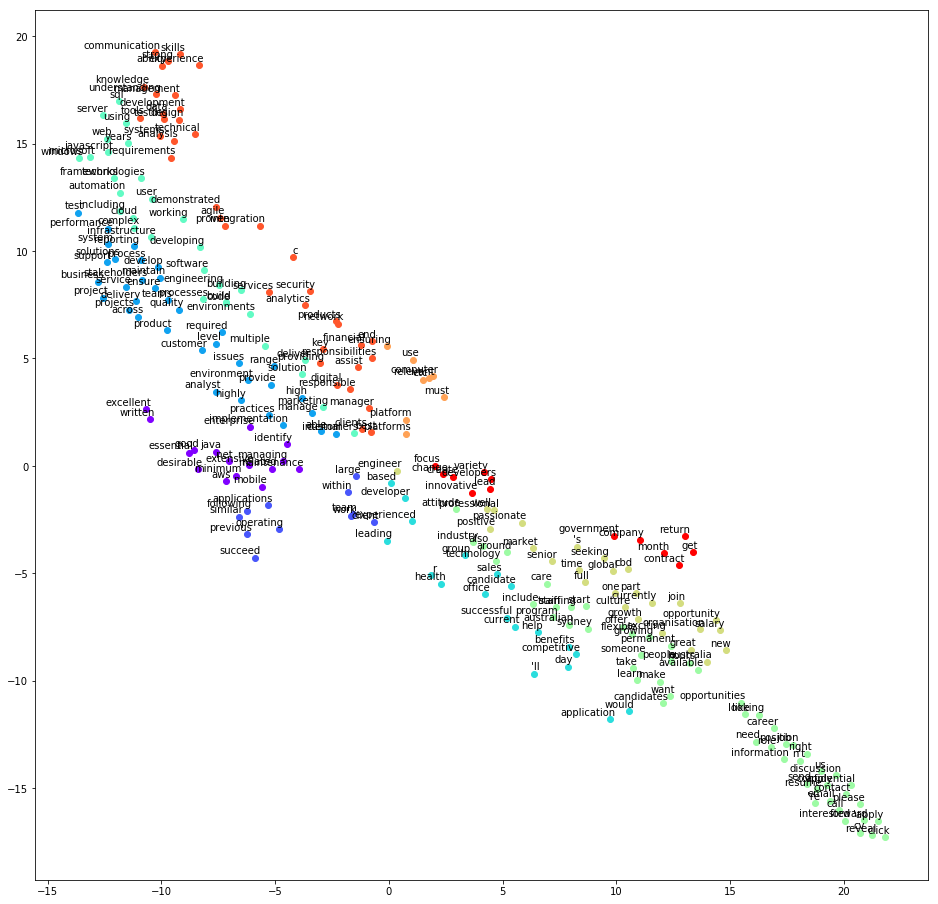

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9995043277740479), ('.net', 0.9989237189292908), ('frameworks', 0.9988185167312622), ('aws', 0.9987769722938538), ('environments', 0.9987466335296631)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9984195828437805), ('knowledge', 0.9979127645492554), ('using', 0.9978214502334595), ('tools', 0.9976552128791809), ('understanding', 0.9971083402633667), ('years', 0.9970983266830444), ('web', 0.9968099594116211), ('javascript', 0.9963414669036865), ('data', 0.9959930181503296), ('systems', 0.9955166578292847)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('microsoft', 0.9993551969528198), ('frameworks', 0.9979463219642639), ('javascript', 0.9977752566337585), ('integration', 0.9974765777587891), ('web', 0.9973856210708618), ('java', 0.9973021149635315), ('server', 0.9972682595252991), ('technologies', 0.9972555637359619), ('c', 0.99715256690979), ('essential', 0.9971134662628174)]
preprocessing


338it [01:03,  4.97it/s]
188it [00:24,  7.63it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


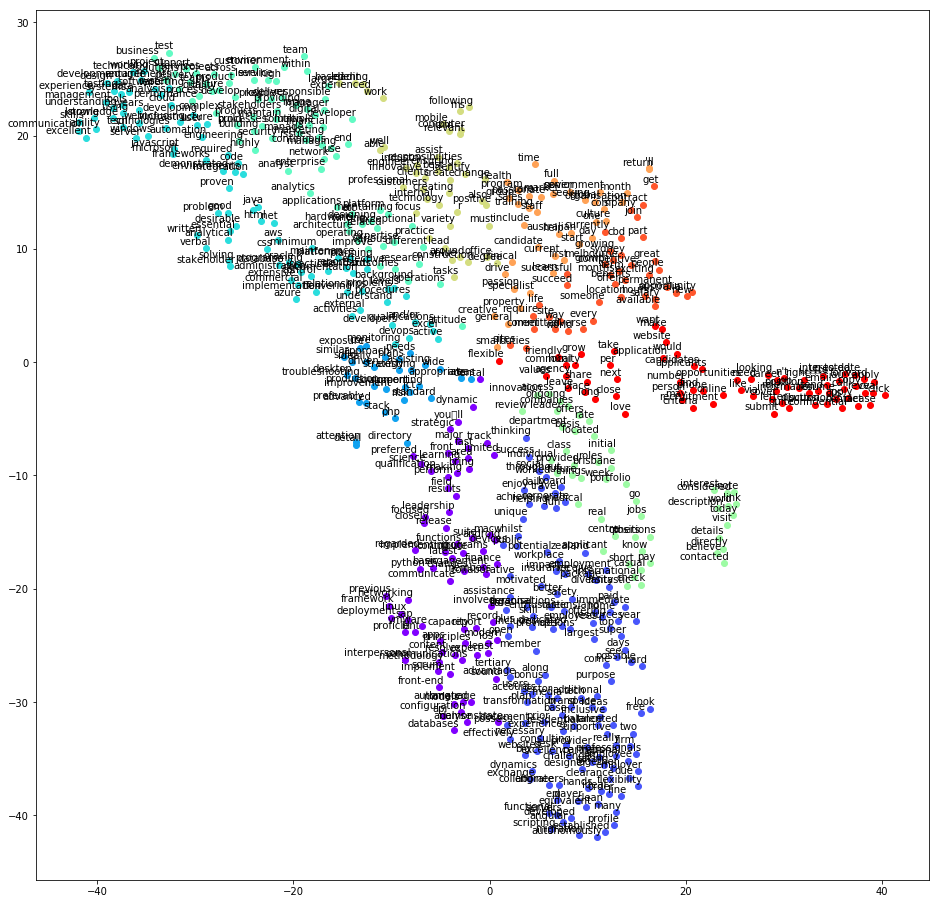

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9994438886642456), ('frameworks', 0.9991216659545898), ('css', 0.9989621639251709), ('aws', 0.9988460540771484), ('.net', 0.9987810850143433)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('knowledge', 0.9970899820327759), ('using', 0.9967544078826904), ('tools', 0.9960542321205139), ('web', 0.9956458210945129), ('server', 0.9954549670219421), ('understanding', 0.9954118728637695), ('years', 0.9935606718063354), ('windows', 0.9934247732162476), ('systems', 0.9919434785842896), ('testing', 0.9908100366592407)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9988164901733398), ('technologies', 0.9967396259307861), ('web', 0.9965015649795532), ('microsoft', 0.9959086775779724), ('javascript', 0.9952556490898132), ('including', 0.9947834610939026), ('tools', 0.994011640548706), ('years', 0.9934897422790527), ('sql', 0.9934248328208923), ('cloud', 0.9934178590774536)]
preprocessing


338it [01:02,  4.99it/s]
188it [00:24,  7.85it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


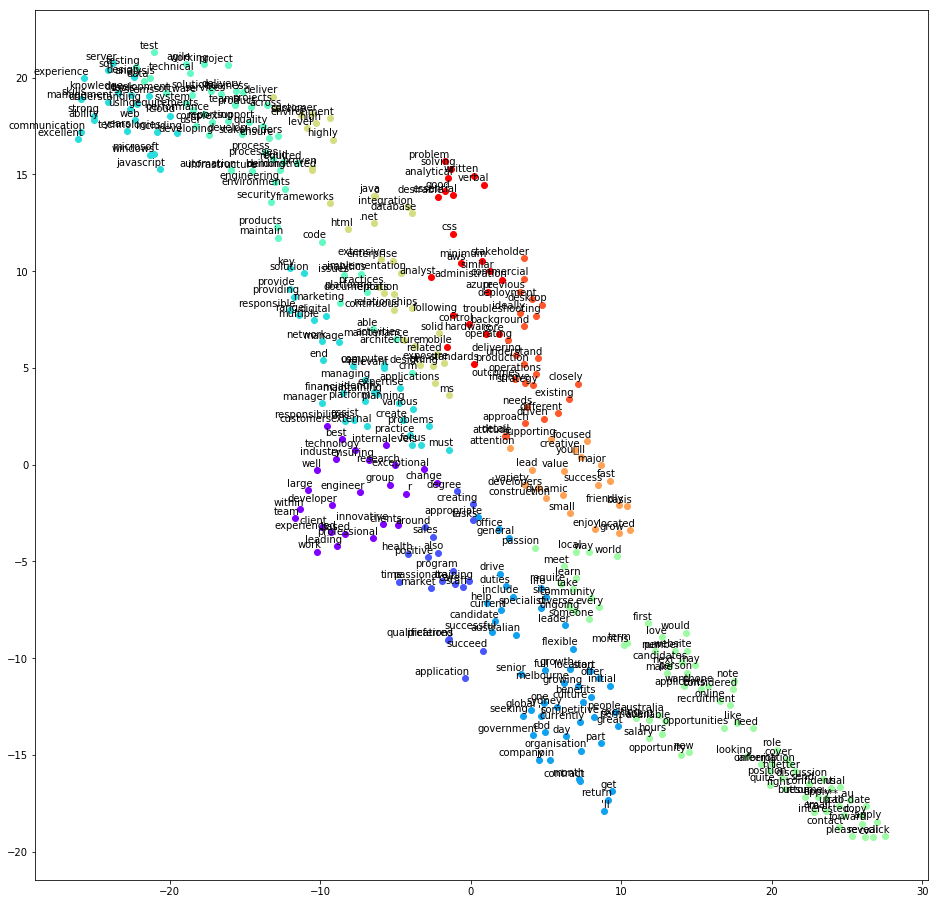

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('frameworks', 0.9993309378623962), ('c', 0.9991676807403564), ('database', 0.998769998550415), ('environments', 0.9983884692192078), ('automation', 0.998322606086731)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.997937798500061), ('knowledge', 0.9969953298568726), ('web', 0.9963861107826233), ('using', 0.9956889748573303), ('tools', 0.9949861764907837), ('understanding', 0.9935826063156128), ('years', 0.9934061765670776), ('windows', 0.9915499091148376), ('systems', 0.99120032787323), ('testing', 0.9908588528633118)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('microsoft', 0.9993062615394592), ('technologies', 0.9976820349693298), ('javascript', 0.9971900582313538), ('including', 0.9967453479766846), ('integration', 0.9962539672851562), ('server', 0.996177077293396), ('c', 0.9961468577384949), ('using', 0.9959709644317627), ('java', 0.9957958459854126), ('web', 0.995510458946228)]
preprocessing


338it [01:02,  5.27it/s]
188it [00:24,  7.94it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


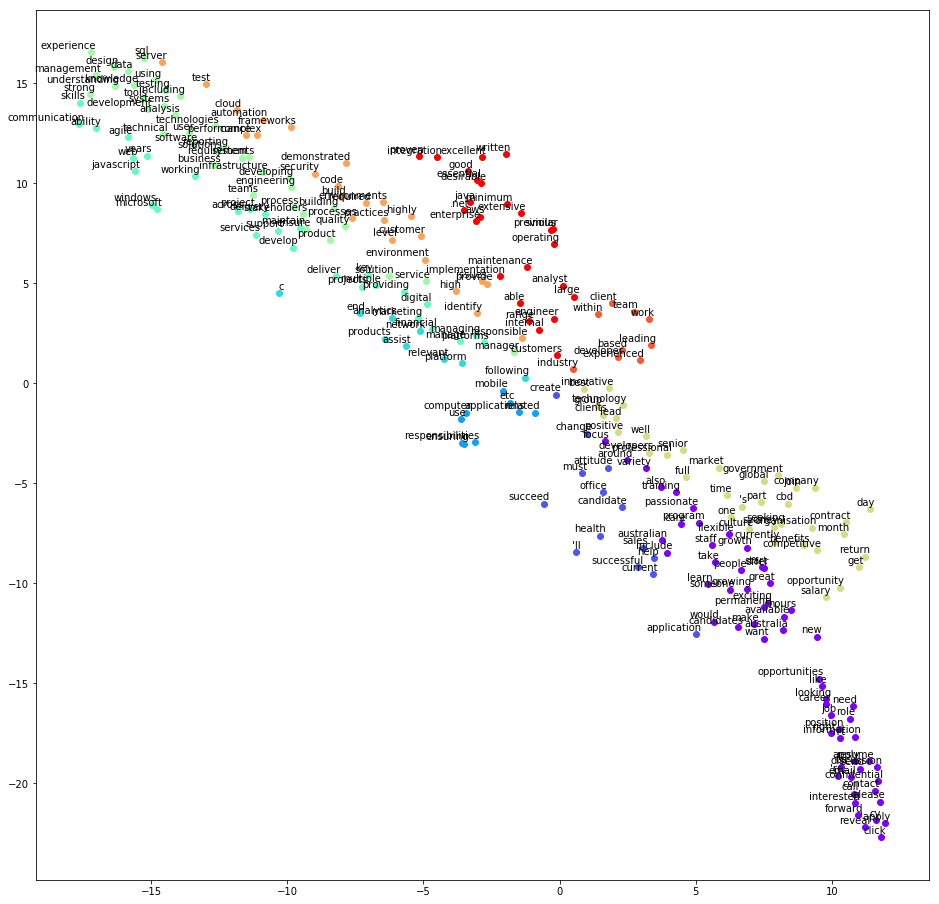

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9992510676383972), ('.net', 0.9991699457168579), ('enterprise', 0.9990872144699097), ('frameworks', 0.9990640878677368), ('environments', 0.9990029335021973)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.998032808303833), ('knowledge', 0.9973322153091431), ('understanding', 0.99725341796875), ('using', 0.9969257116317749), ('tools', 0.9968101978302002), ('web', 0.9957475662231445), ('data', 0.9955929517745972), ('strong', 0.9949876070022583), ('development', 0.9948599338531494), ('testing', 0.9944508671760559)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('microsoft', 0.9993690252304077), ('frameworks', 0.9984126687049866), ('integration', 0.9983693361282349), ('technologies', 0.998123824596405), ('javascript', 0.9981061220169067), ('demonstrated', 0.9979321956634521), ('java', 0.9974278211593628), ('good', 0.9973905086517334), ('proven', 0.9973504543304443), ('code', 0.9973418712615967)]
preprocessing


338it [16:47,  3.16s/it]
188it [06:30,  1.71s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


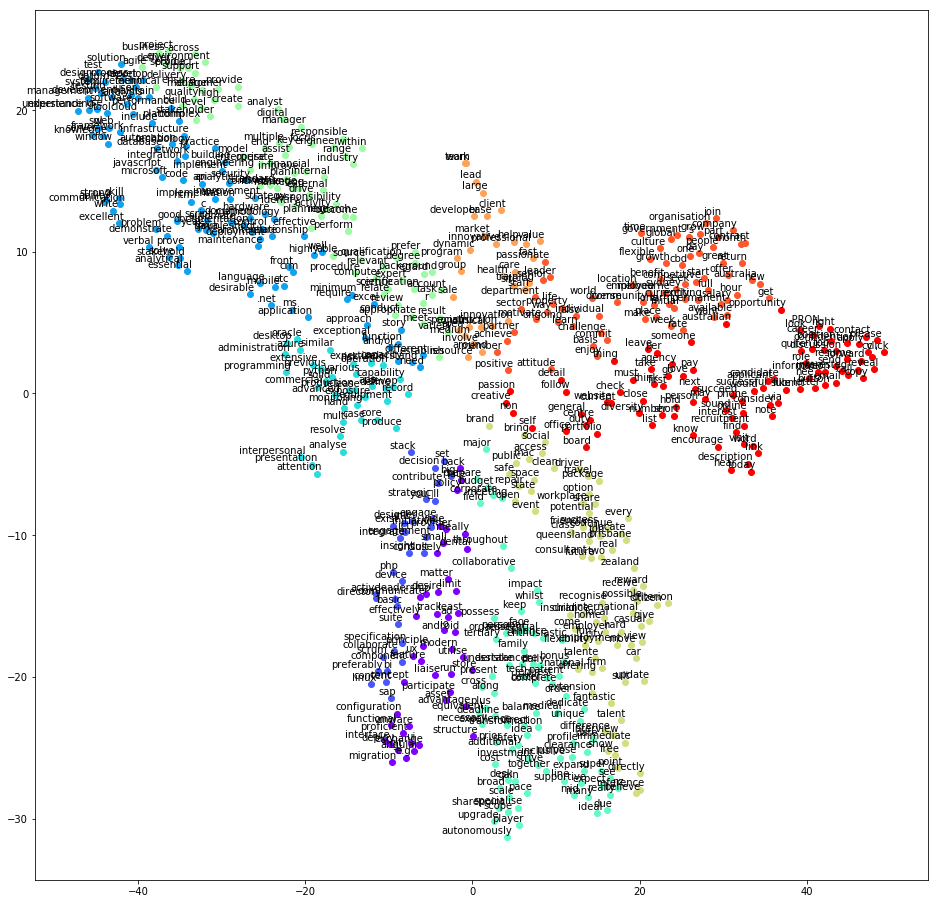

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.999336838722229), ('script', 0.9983391761779785), ('aws', 0.9982239603996277), ('api', 0.9981003999710083), ('html', 0.9979703426361084)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9975680112838745), ('web', 0.9969648122787476), ('knowledge', 0.9964245557785034), ('window', 0.9961506128311157), ('tool', 0.9944330453872681), ('use', 0.9937177300453186), ('understanding', 0.9918395280838013), ('framework', 0.9911393523216248), ('development', 0.9863094687461853), ('system', 0.9861097931861877)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [15:19,  2.63s/it]
188it [05:22,  1.42s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


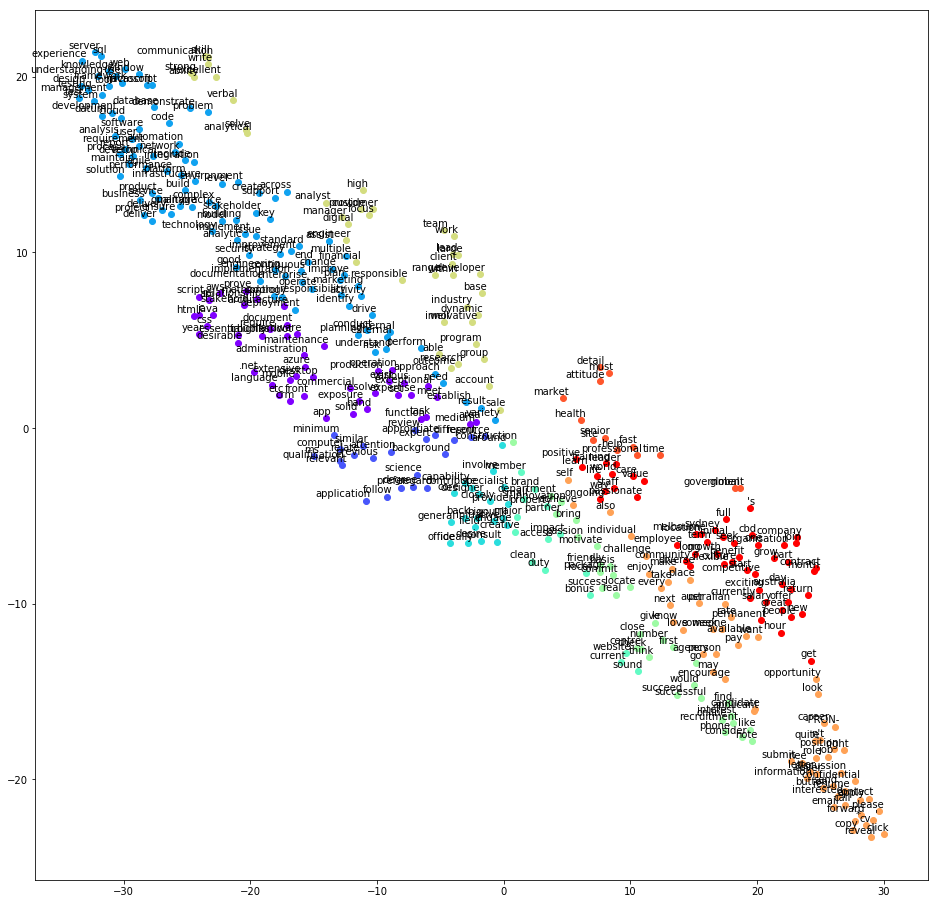

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('api', 0.9987359046936035), ('c', 0.9980652332305908), ('aws', 0.9977854490280151), ('.net', 0.9975477457046509), ('css', 0.9971109628677368)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9983305931091309), ('web', 0.9959779977798462), ('knowledge', 0.9947245121002197), ('framework', 0.993484377861023), ('use', 0.9931408762931824), ('tool', 0.992881178855896), ('understanding', 0.9921861886978149), ('window', 0.9907320737838745), ('experience', 0.9879251718521118), ('system', 0.9843785762786865)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:53,  2.62s/it]
188it [05:22,  1.42s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


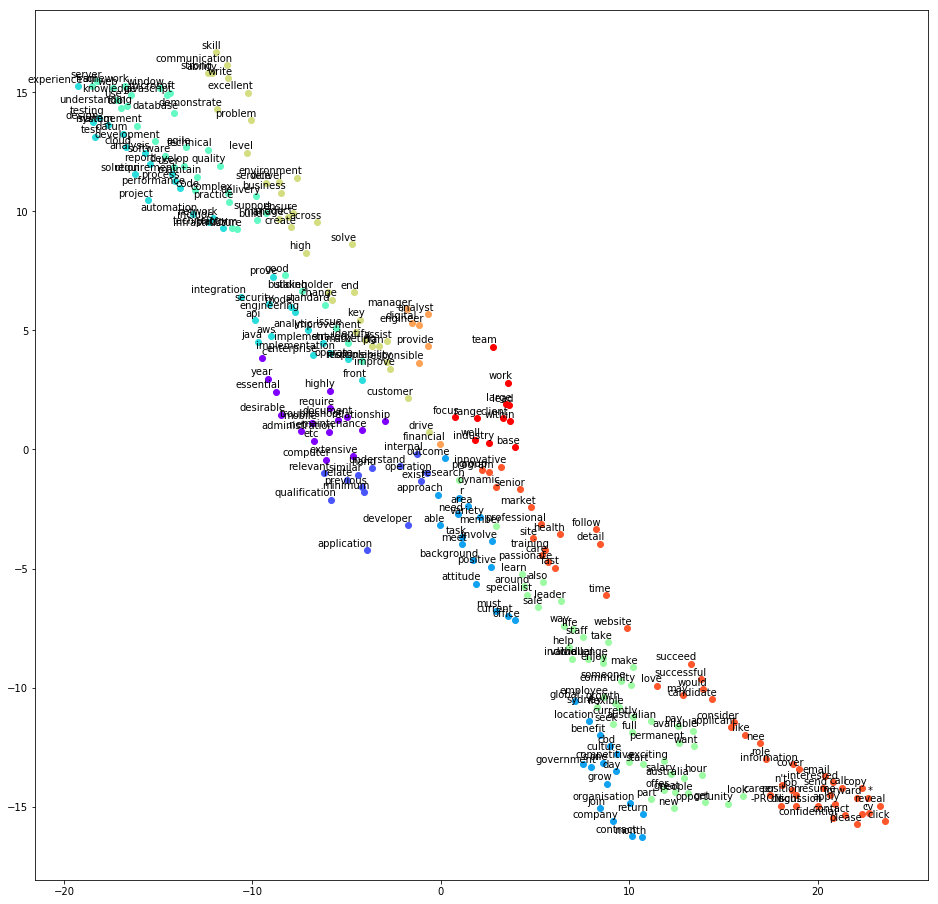

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('api', 0.9986472129821777), ('aws', 0.9979622960090637), ('c', 0.997366726398468), ('security', 0.9972324371337891), ('automation', 0.9964867234230042)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9983921647071838), ('web', 0.9971004724502563), ('knowledge', 0.9943426251411438), ('use', 0.9939548969268799), ('tool', 0.9934011697769165), ('understanding', 0.9926353693008423), ('framework', 0.9925209283828735), ('experience', 0.9903908371925354), ('testing', 0.9898605346679688), ('system', 0.9890119433403015)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:53,  2.62s/it]
188it [05:22,  1.41s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


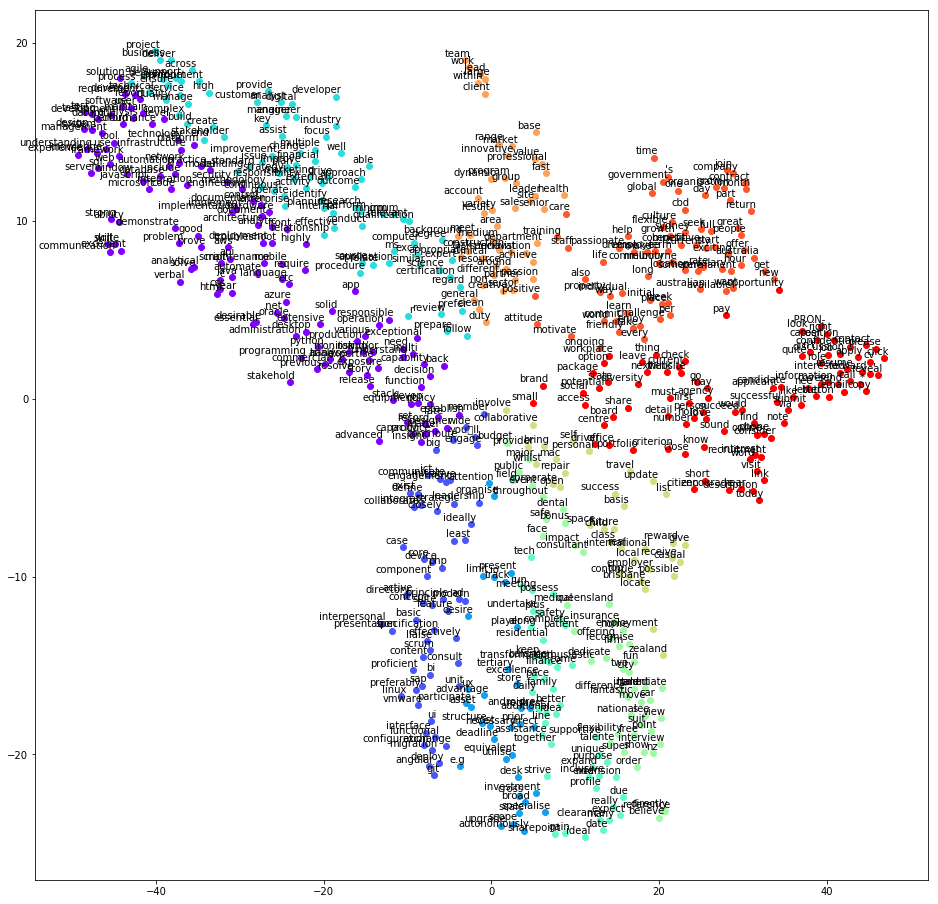

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9992647171020508), ('css', 0.9982765913009644), ('api', 0.9982575178146362), ('aws', 0.9982016682624817), ('script', 0.9980725049972534)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('web', 0.99737149477005), ('knowledge', 0.9971160888671875), ('server', 0.9968162775039673), ('use', 0.9957754015922546), ('tool', 0.9936344623565674), ('framework', 0.9928121566772461), ('understanding', 0.9922627806663513), ('window', 0.9902780055999756), ('system', 0.9884071946144104), ('development', 0.9874635934829712)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:56,  2.65s/it]
188it [05:22,  1.41s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


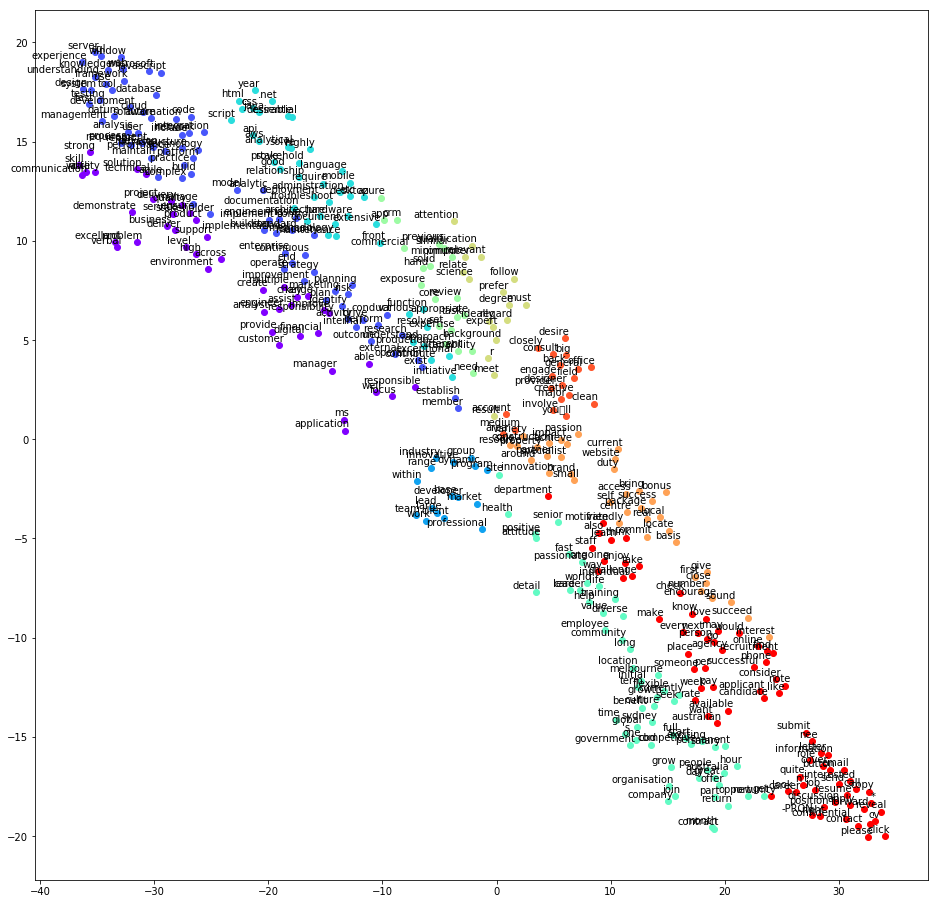

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.999035120010376), ('html', 0.9986051321029663), ('css', 0.9983997941017151), ('api', 0.9977501034736633), ('aws', 0.9974507093429565)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9985960721969604), ('knowledge', 0.9955872297286987), ('window', 0.9946613311767578), ('use', 0.9943580627441406), ('web', 0.9941951036453247), ('understanding', 0.9933188557624817), ('tool', 0.9922076463699341), ('framework', 0.9915918111801147), ('experience', 0.9887308478355408), ('system', 0.9856088161468506)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:57,  2.62s/it]
188it [05:26,  1.41s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


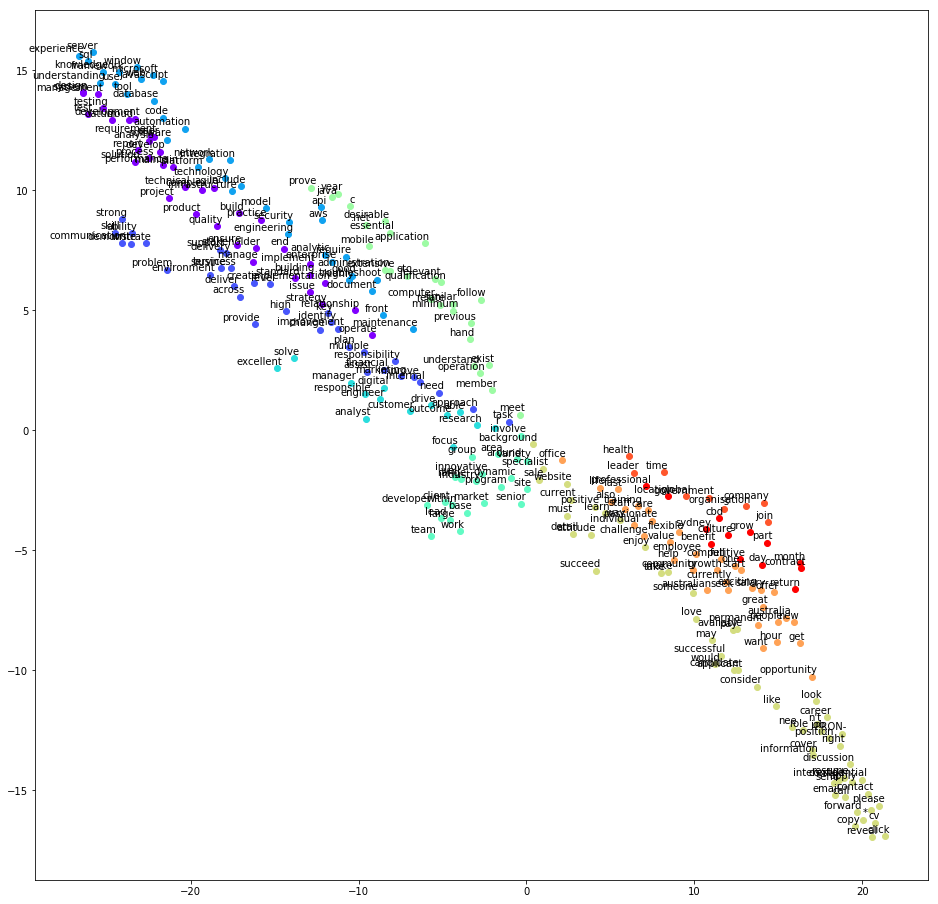

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('api', 0.998915433883667), ('c', 0.9978509545326233), ('aws', 0.9974033832550049), ('year', 0.9971106052398682), ('automation', 0.995407223701477)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9982359409332275), ('knowledge', 0.9967295527458191), ('experience', 0.995749294757843), ('framework', 0.9944884777069092), ('understanding', 0.9939507246017456), ('use', 0.9927198886871338), ('window', 0.9917636513710022), ('web', 0.990638792514801), ('system', 0.9902749061584473), ('design', 0.990168571472168)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:02, 166.58it/s]
188it [00:00, 223.87it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


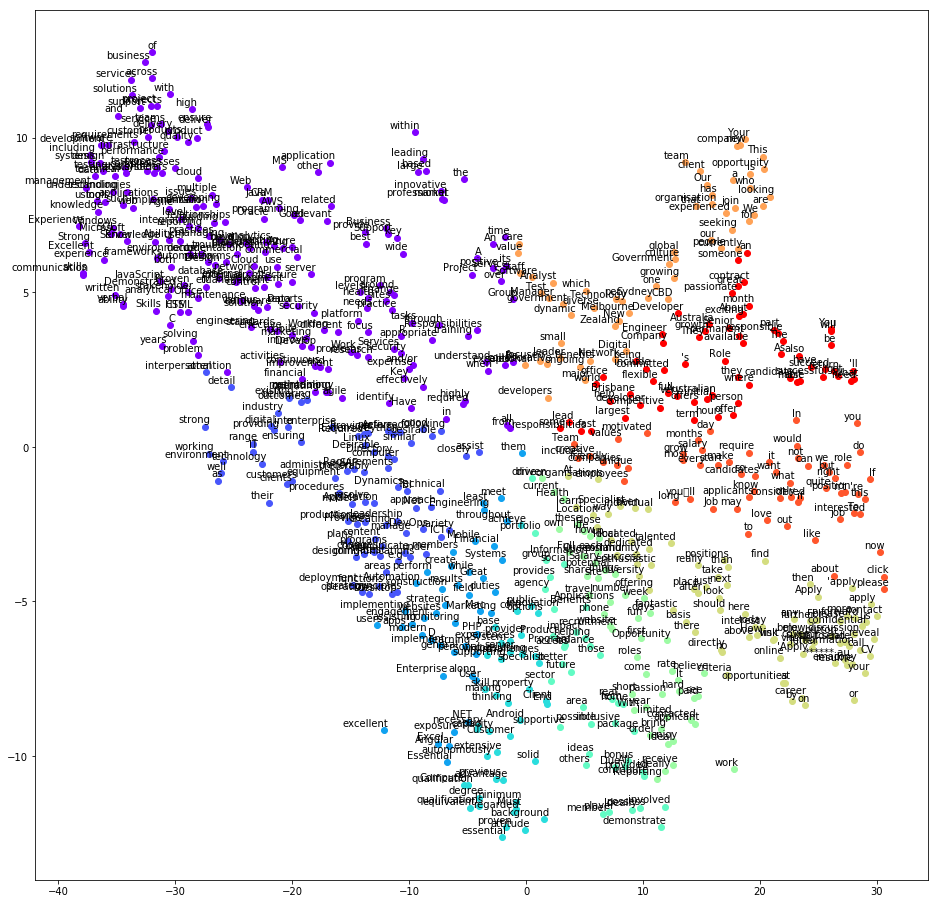

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:01, 175.20it/s]
188it [00:00, 235.22it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


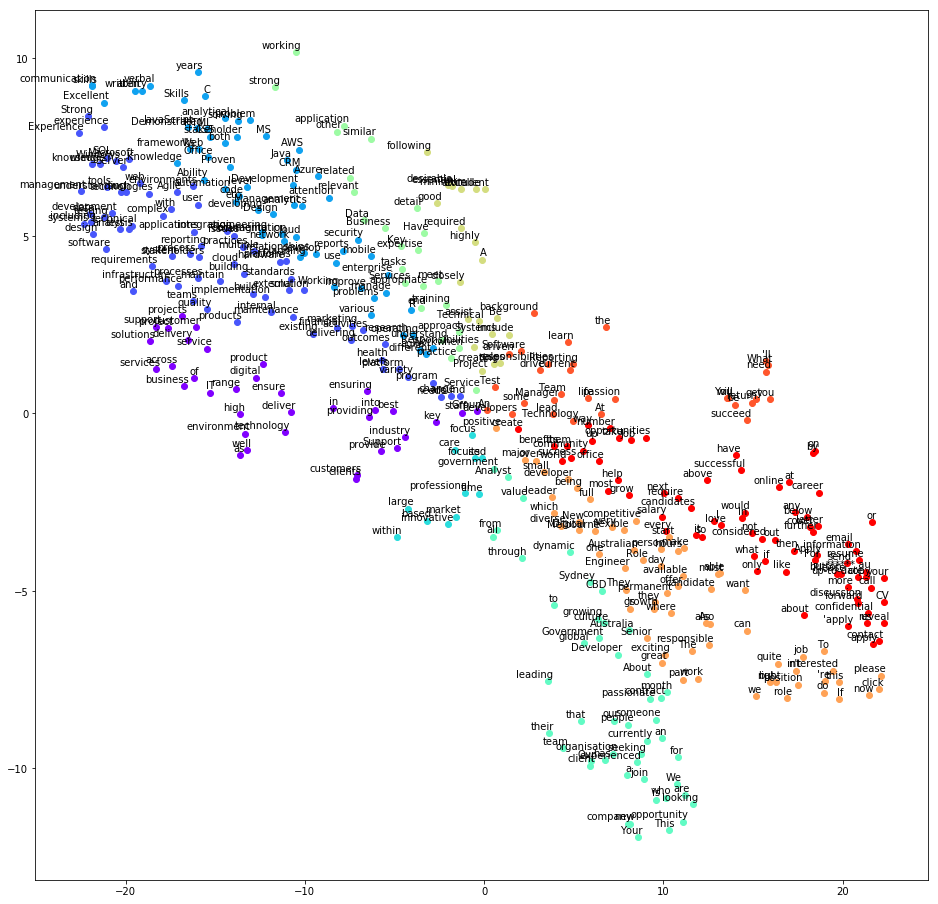

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:01, 177.33it/s]
188it [00:00, 237.69it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


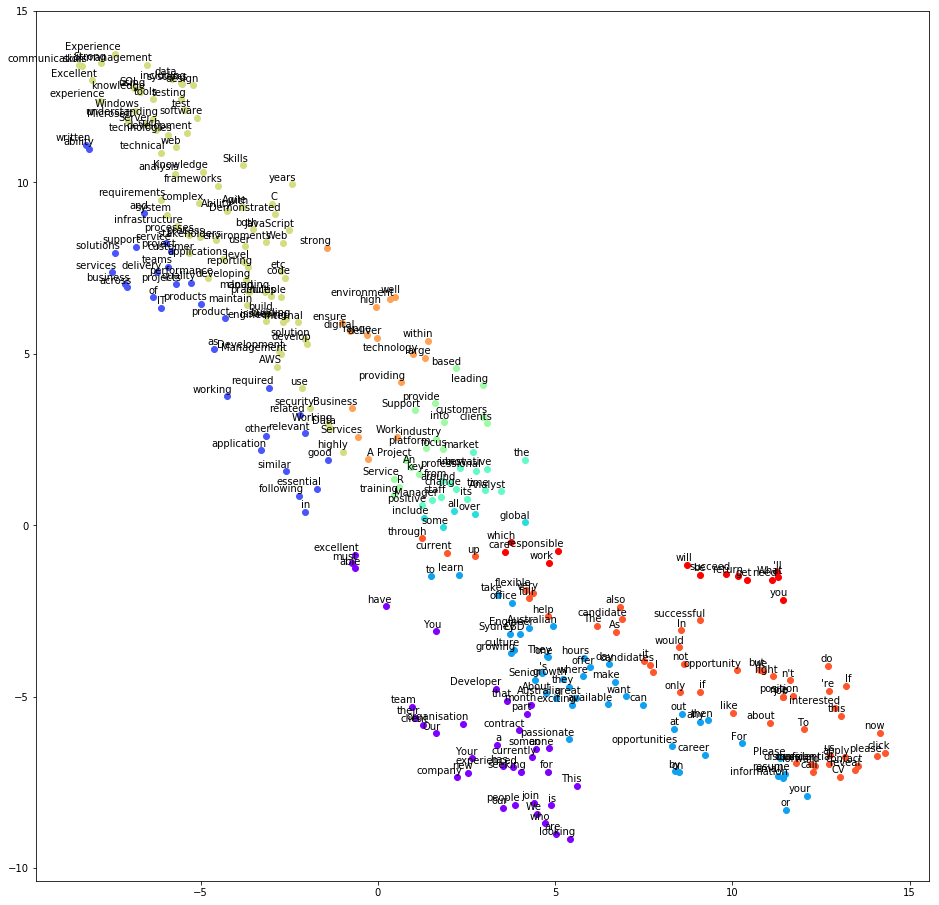

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:01, 173.27it/s]
188it [00:00, 237.05it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


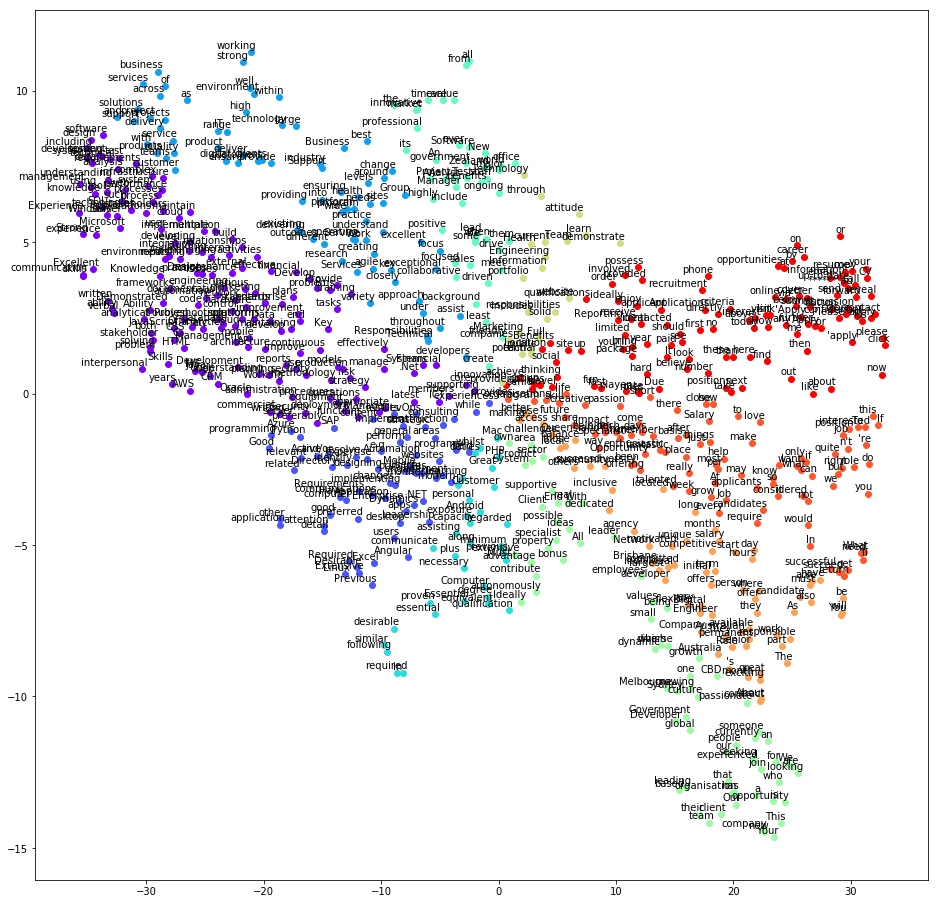

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:01, 173.96it/s]
188it [00:00, 228.93it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


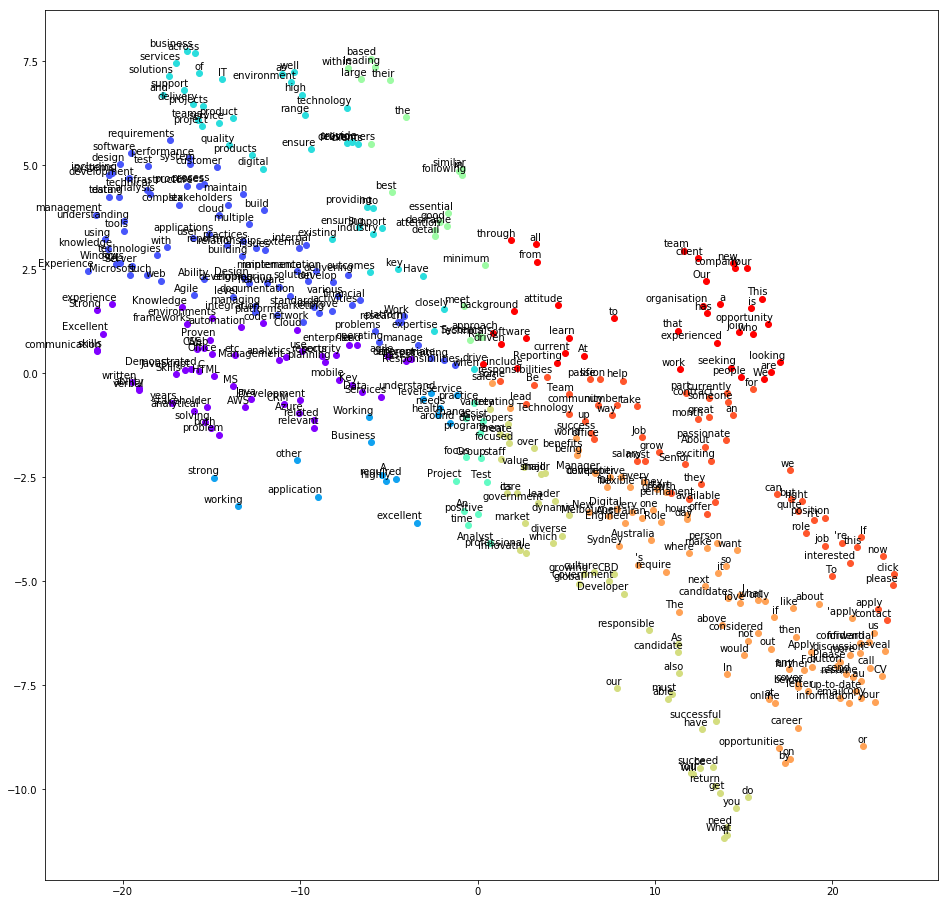

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:01, 175.66it/s]
188it [00:00, 233.85it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


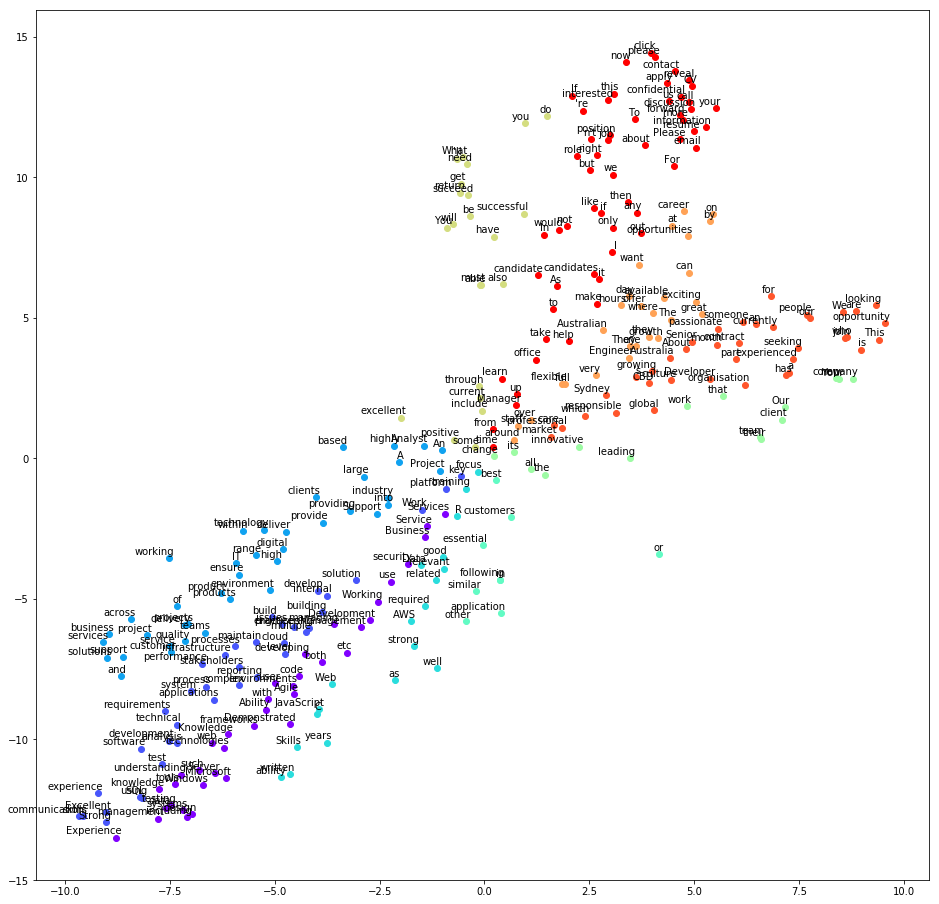

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:15,  2.31s/it]
188it [04:46,  1.30s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


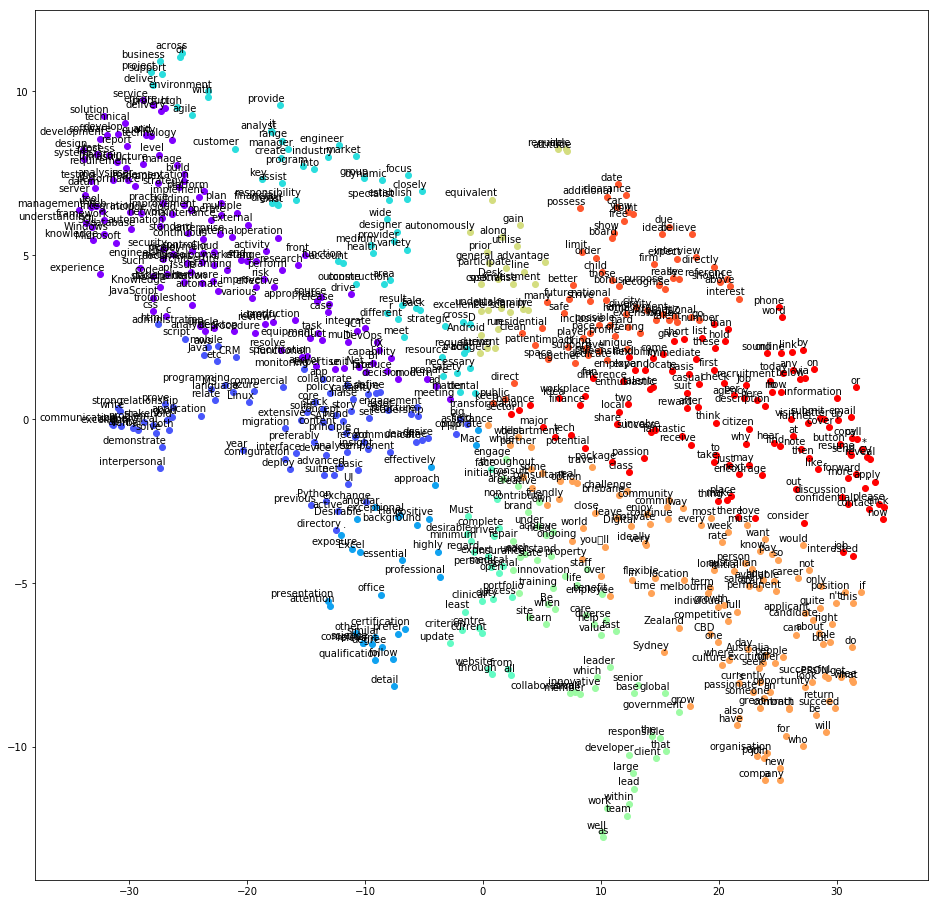

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:15,  2.37s/it]
188it [04:44,  1.25s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


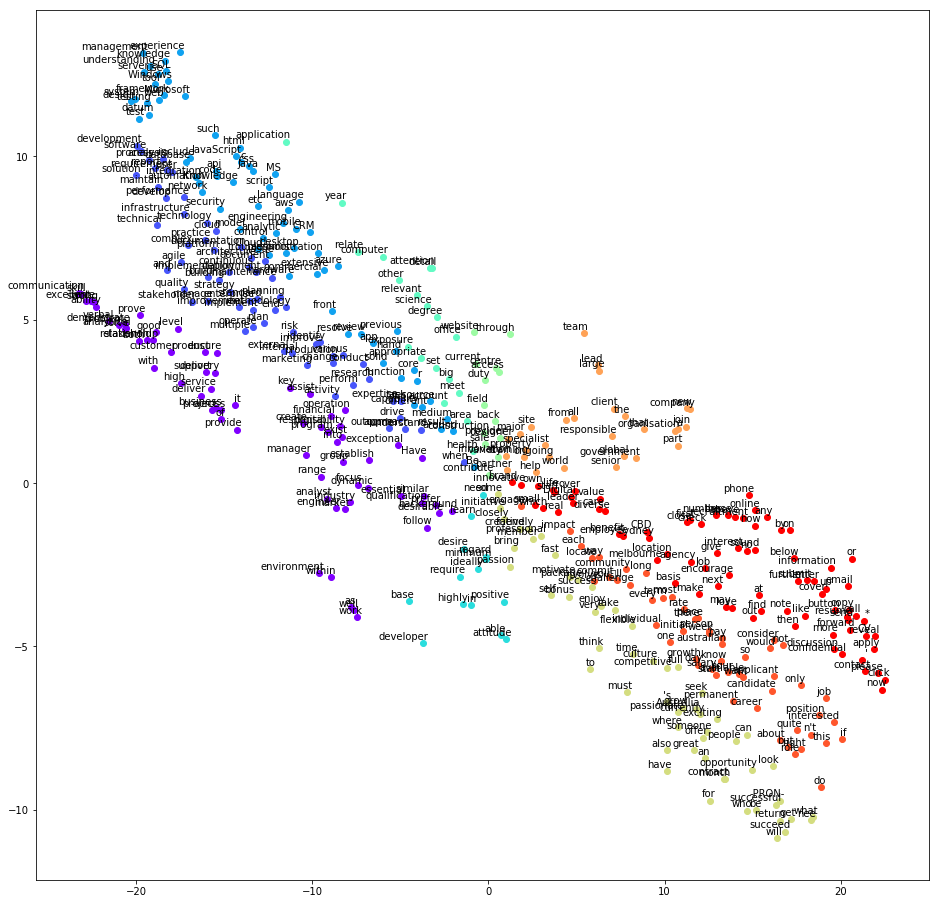

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:18,  2.42s/it]
188it [04:45,  1.25s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


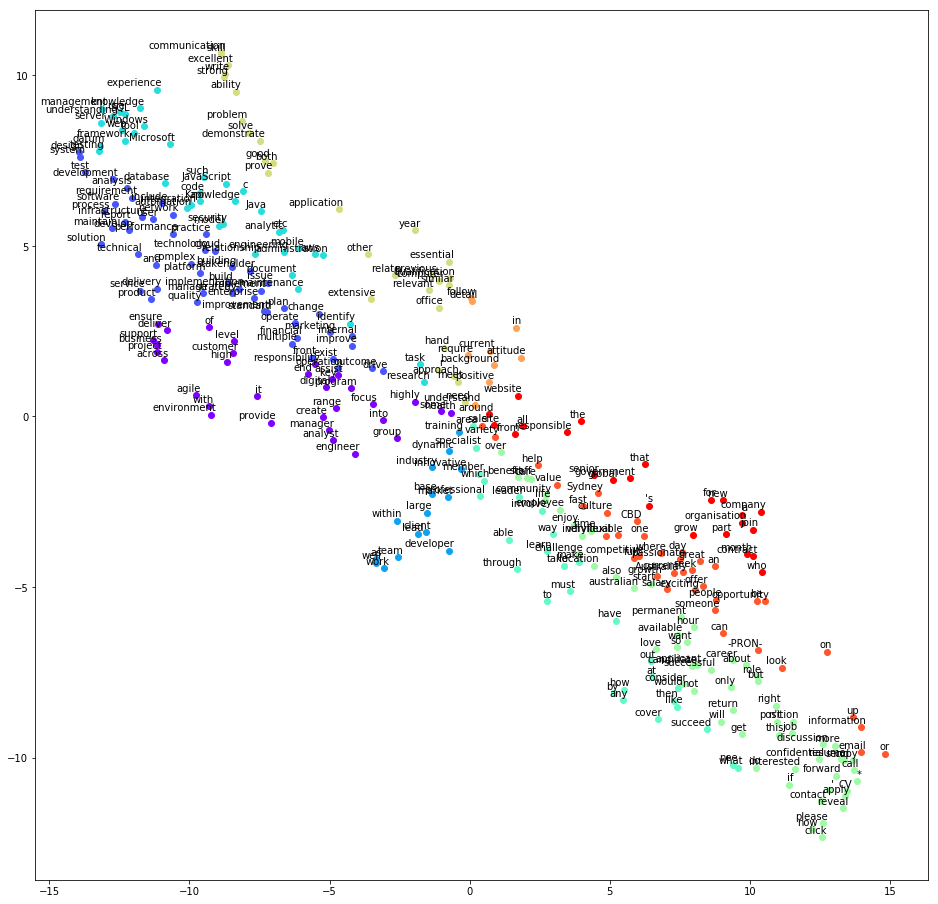

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:15,  2.32s/it]
188it [04:45,  1.24s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


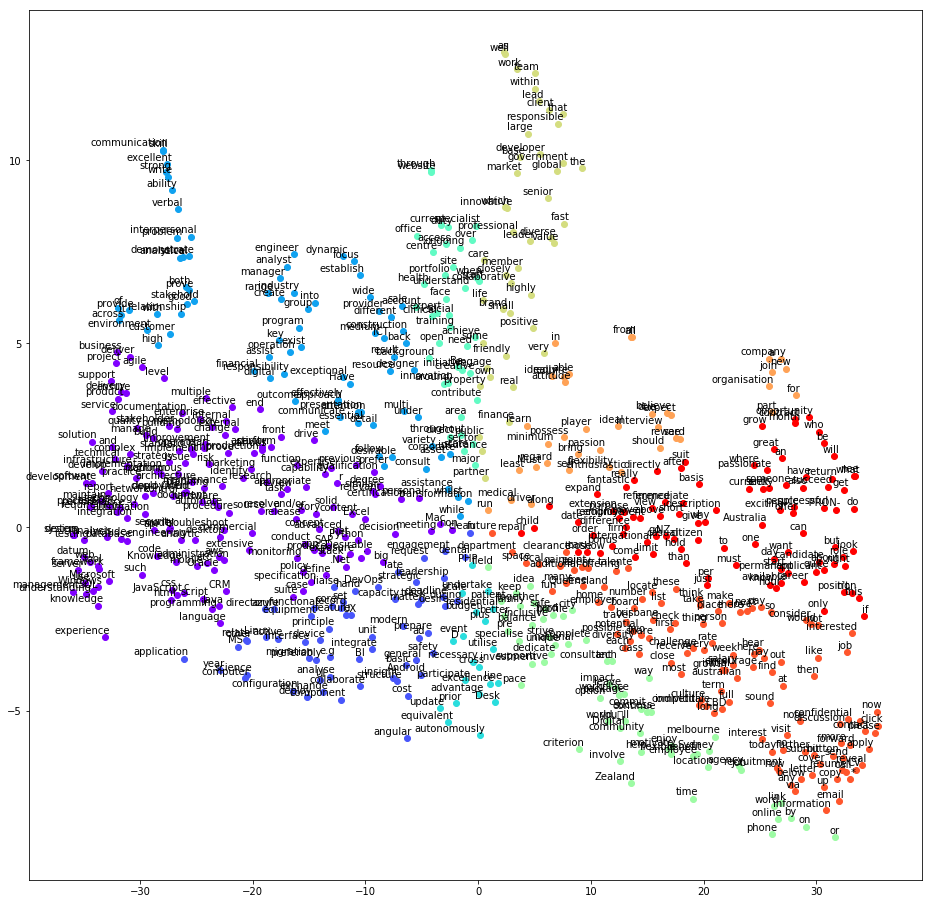

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:17,  2.33s/it]
188it [04:44,  1.24s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


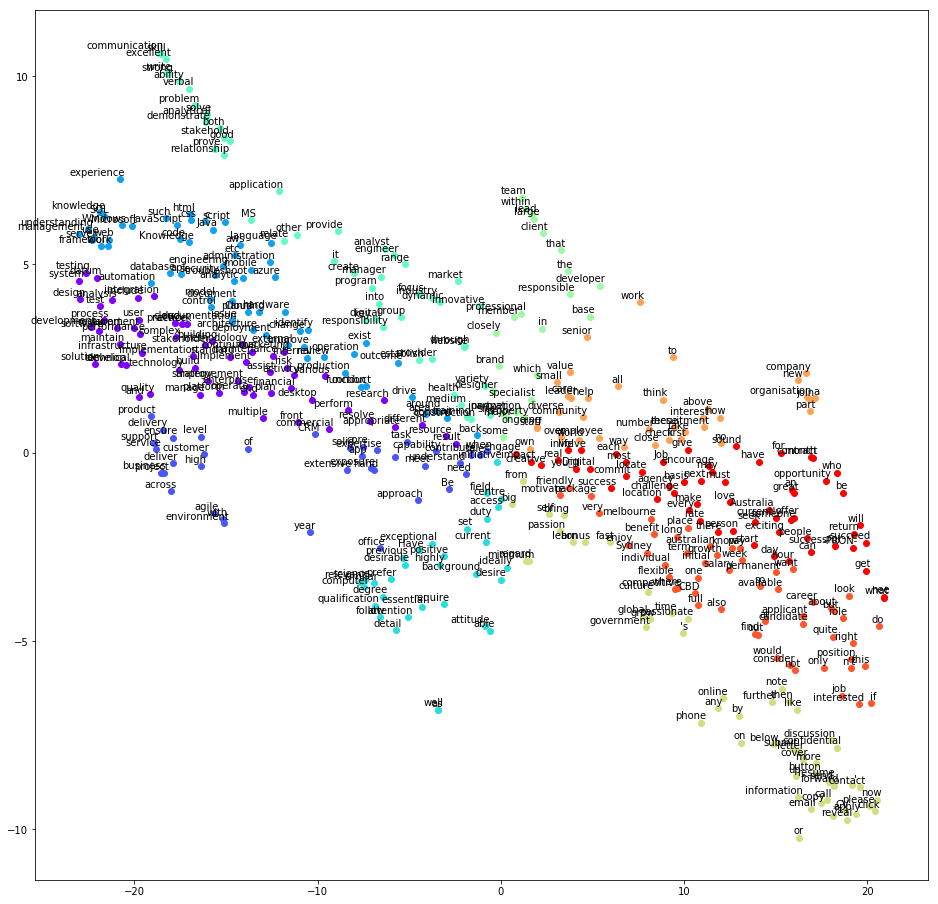

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:15,  2.33s/it]
188it [04:44,  1.24s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


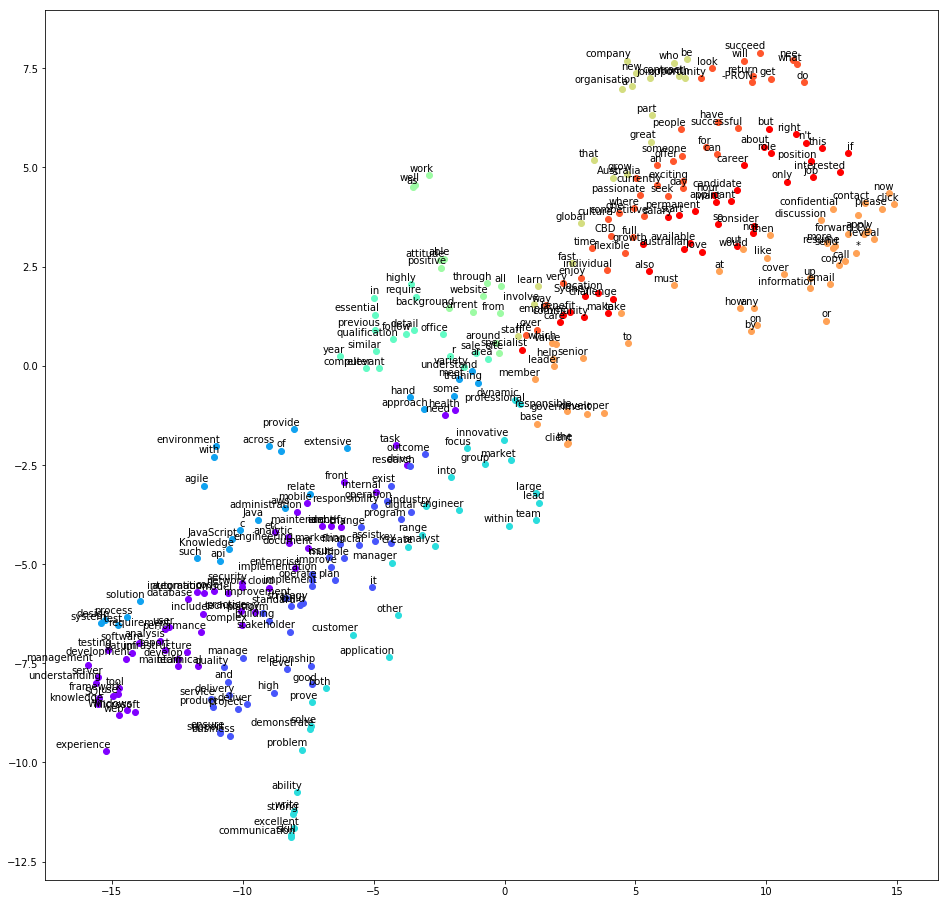

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:01, 175.72it/s]
188it [00:00, 233.38it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


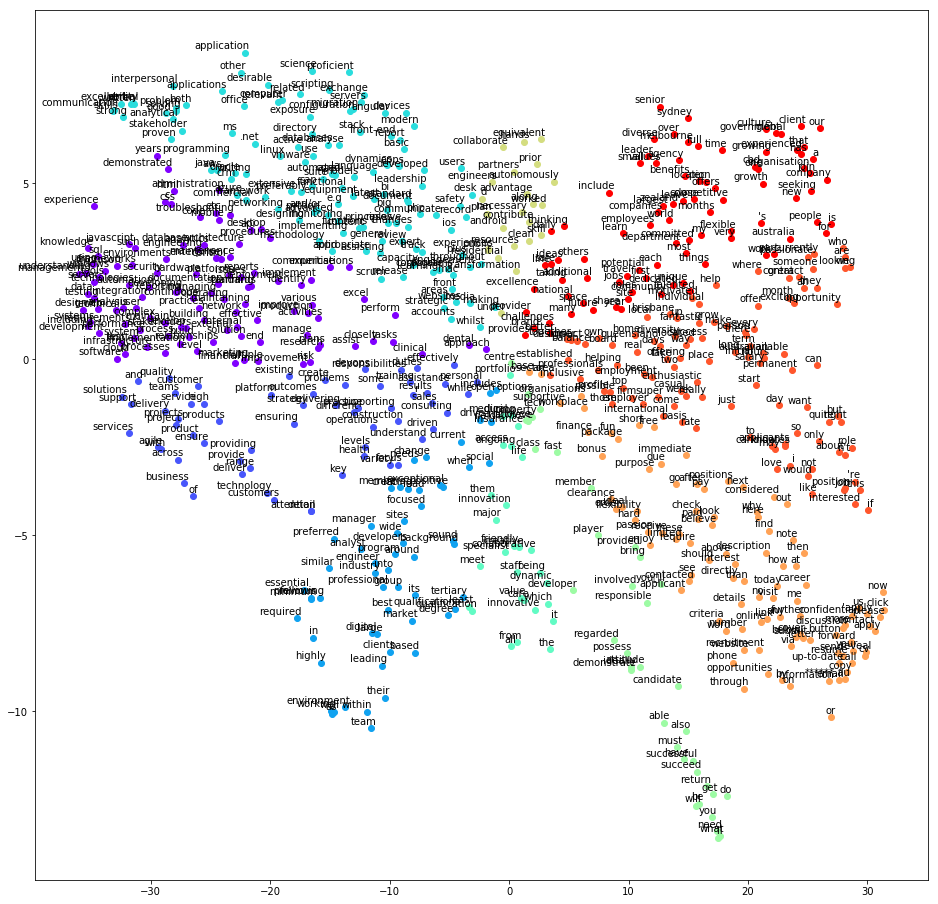

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('programming', 0.9969112873077393), ('framework', 0.9968271255493164), ('linux', 0.9954991936683655), ('aws', 0.99537593126297), ('administration', 0.9951879978179932)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('using', 0.9982566237449646), ('windows', 0.9977283477783203), ('tools', 0.9971712827682495), ('knowledge', 0.9966609477996826), ('server', 0.9962607026100159), ('microsoft', 0.9911731481552124), ('testing', 0.9906972646713257), ('understanding', 0.990680456161499), ('data', 0.9884874820709229), ('javascript', 0.9861332774162292)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9989056587219238), ('tools', 0.9985829591751099), ('sql', 0.9977283477783203), ('microsoft', 0.9968723058700562), ('using', 0.9963013529777527), ('knowledge', 0.9929822087287903), ('testing', 0.9925968647003174), ('understanding', 0.9891199469566345), ('data', 0.9891144633293152), ('javascript', 0.9890467524528503)]
preprocessing


338it [00:01, 172.80it/s]
188it [00:00, 234.99it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


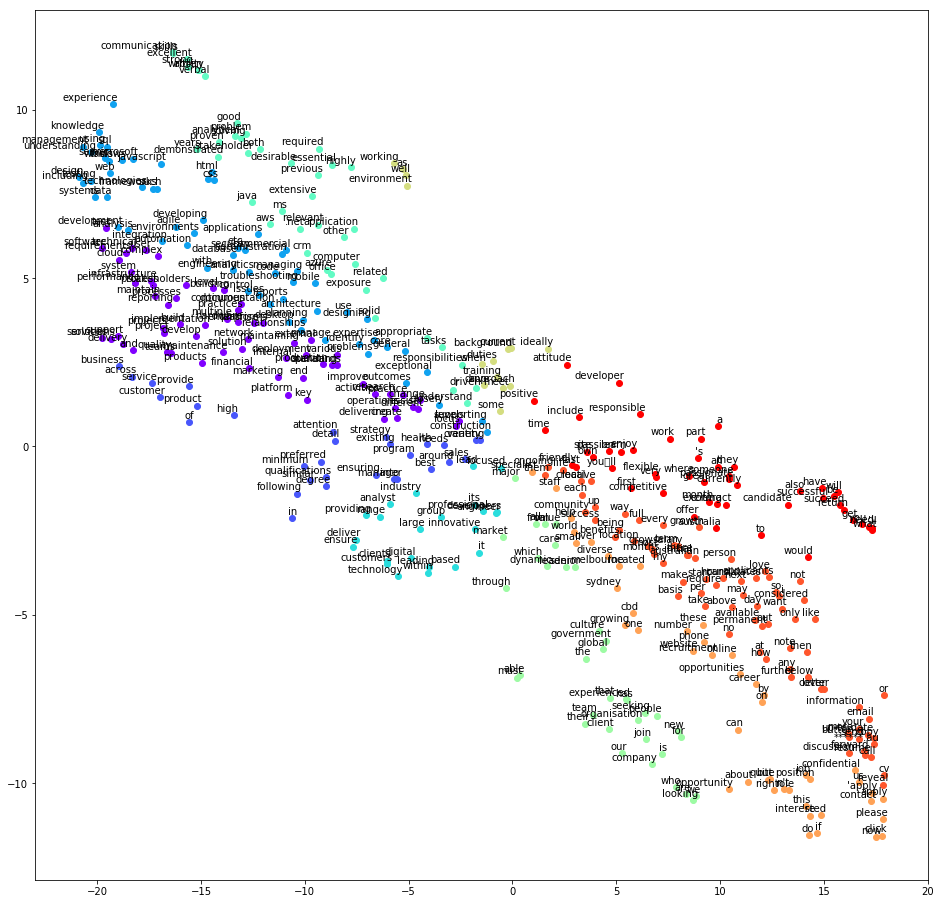

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('aws', 0.9952679872512817), ('html', 0.9941344857215881), ('css', 0.994087278842926), ('commercial', 0.991828203201294), ('.net', 0.9912780523300171)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('using', 0.997672975063324), ('windows', 0.9967554211616516), ('tools', 0.9966704845428467), ('knowledge', 0.994369387626648), ('server', 0.9939697980880737), ('understanding', 0.9910340309143066), ('javascript', 0.9900129437446594), ('microsoft', 0.9899707436561584), ('technologies', 0.9878687858581543), ('data', 0.9866493940353394)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9980517625808716), ('tools', 0.9980330467224121), ('microsoft', 0.9969714879989624), ('sql', 0.9967554211616516), ('using', 0.9958788156509399), ('javascript', 0.9938702583312988), ('technologies', 0.993675708770752), ('knowledge', 0.9926525950431824), ('frameworks', 0.9907807111740112), ('understanding', 0.9856444597244263)]
preprocessing


338it [00:01, 173.32it/s]
188it [00:00, 223.49it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


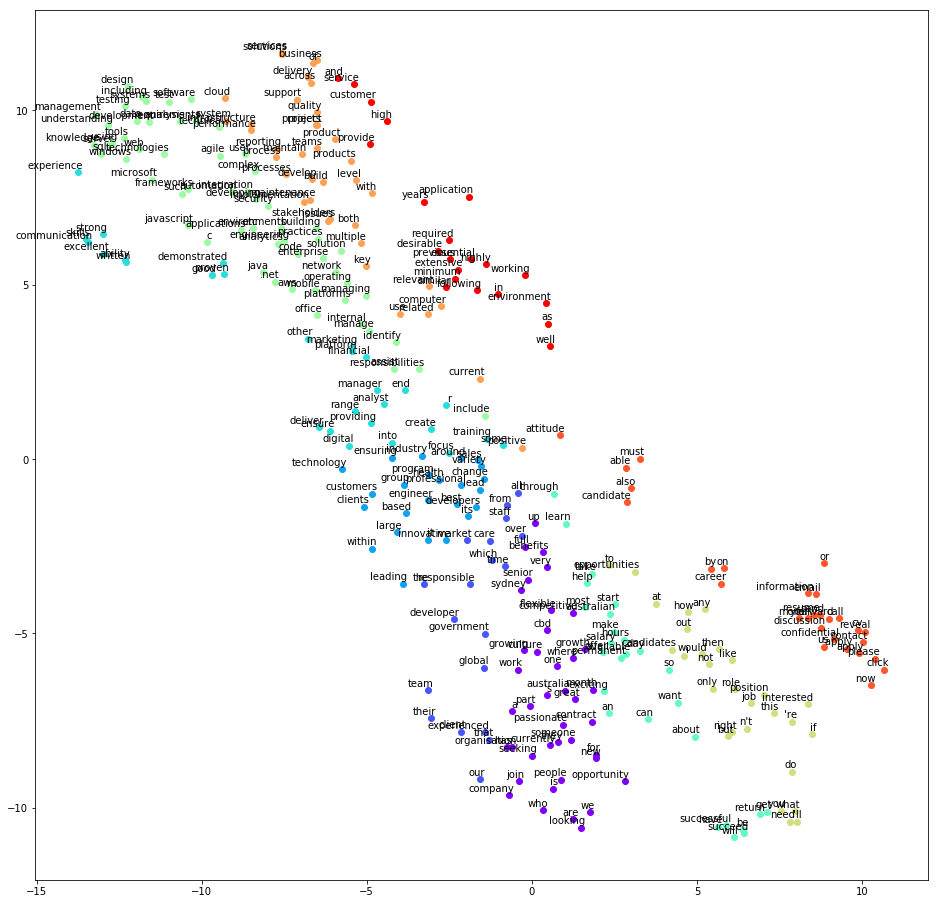

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.9986164569854736), ('aws', 0.9950162172317505), ('mobile', 0.9931427836418152), ('environments', 0.9883675575256348), ('code', 0.9875794649124146)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9971650838851929), ('using', 0.9958478808403015), ('knowledge', 0.9951404333114624), ('windows', 0.9945641160011292), ('tools', 0.9935030341148376), ('understanding', 0.9893330335617065), ('microsoft', 0.986474871635437), ('such', 0.9856303930282593), ('javascript', 0.984250545501709), ('technologies', 0.9841043949127197)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9985849857330322), ('using', 0.9977529644966125), ('microsoft', 0.9967026710510254), ('tools', 0.9965733289718628), ('sql', 0.9945641160011292), ('knowledge', 0.9929797649383545), ('technologies', 0.9911191463470459), ('frameworks', 0.9887963533401489), ('javascript', 0.988411009311676), ('understanding', 0.987966775894165)]
preprocessing


338it [00:01, 172.51it/s]
188it [00:00, 237.25it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


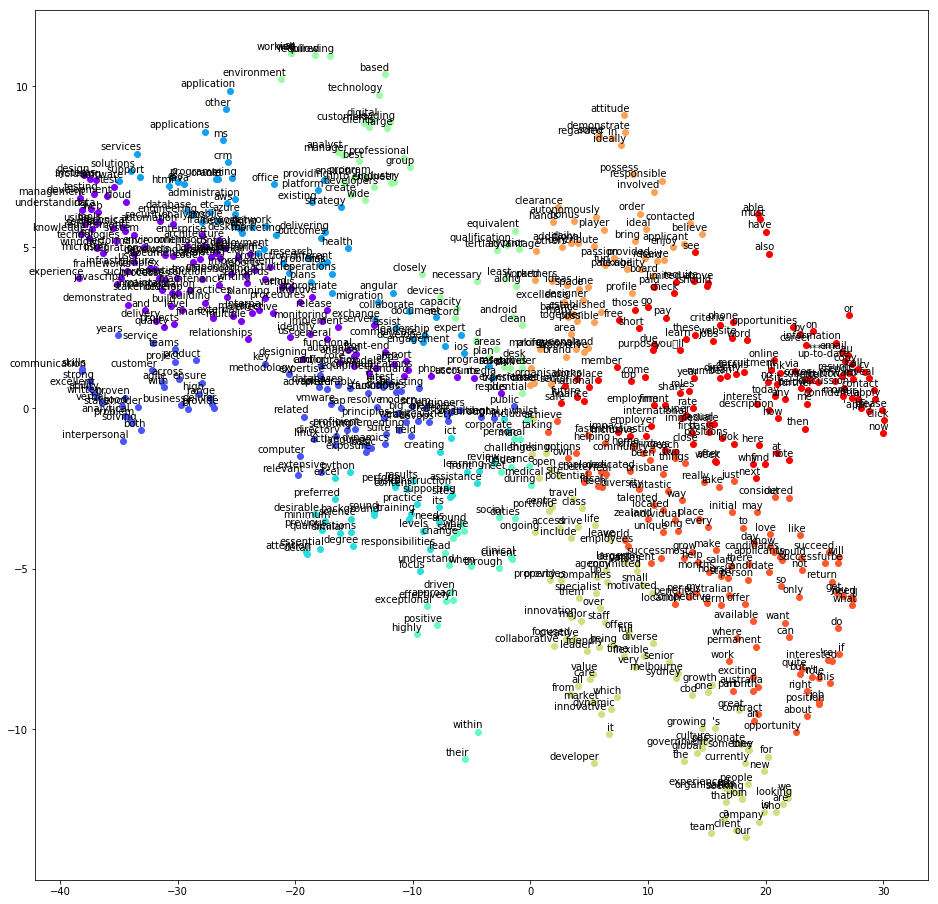

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('aws', 0.9985815286636353), ('css', 0.9978039264678955), ('html', 0.9970872402191162), ('database', 0.9961103200912476), ('framework', 0.9950605630874634)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('using', 0.9981942176818848), ('windows', 0.9979708194732666), ('server', 0.9971228241920471), ('knowledge', 0.9966116547584534), ('tools', 0.9945504665374756), ('data', 0.9922783374786377), ('microsoft', 0.9902569651603699), ('understanding', 0.9883893132209778), ('javascript', 0.9875378012657166), ('web', 0.9853485822677612)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('sql', 0.9979708194732666), ('server', 0.9974225759506226), ('microsoft', 0.9950433969497681), ('using', 0.9946107864379883), ('tools', 0.994452714920044), ('javascript', 0.9939867258071899), ('knowledge', 0.9933364391326904), ('c', 0.9910399913787842), ('data', 0.989445149898529), ('frameworks', 0.9880895614624023)]
preprocessing


338it [00:01, 173.56it/s]
188it [00:00, 233.67it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


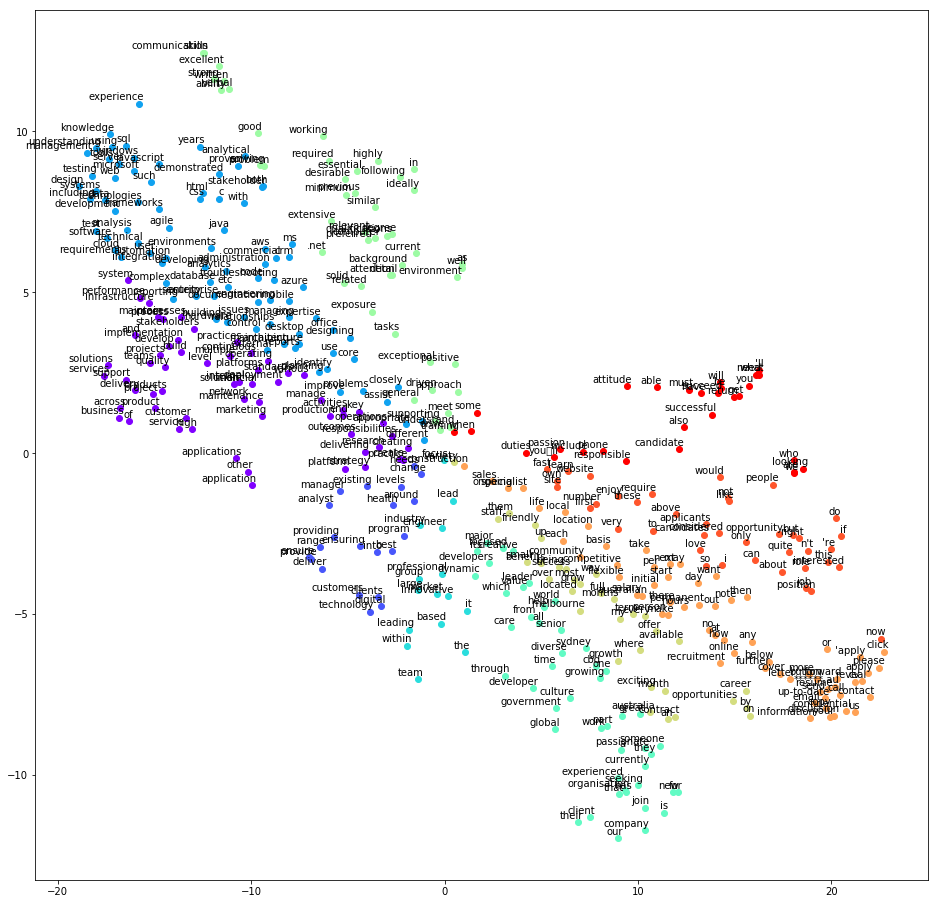

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('aws', 0.9977322816848755), ('administration', 0.9958865642547607), ('crm', 0.995834231376648), ('environments', 0.9945614337921143), ('azure', 0.9928814768791199)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('windows', 0.998397946357727), ('javascript', 0.9968453645706177), ('using', 0.9963018894195557), ('server', 0.99501633644104), ('microsoft', 0.9934343099594116), ('knowledge', 0.9929935932159424), ('such', 0.9924076795578003), ('tools', 0.9898958206176758), ('technologies', 0.9887088537216187), ('frameworks', 0.9848524332046509)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('sql', 0.9983978867530823), ('using', 0.9971766471862793), ('server', 0.9968301653862), ('microsoft', 0.9960078001022339), ('knowledge', 0.9949827194213867), ('javascript', 0.994386613368988), ('tools', 0.9940234422683716), ('such', 0.9899152517318726), ('technologies', 0.9890291690826416), ('frameworks', 0.9850653409957886)]
preprocessing


338it [00:01, 173.45it/s]
188it [00:00, 232.85it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


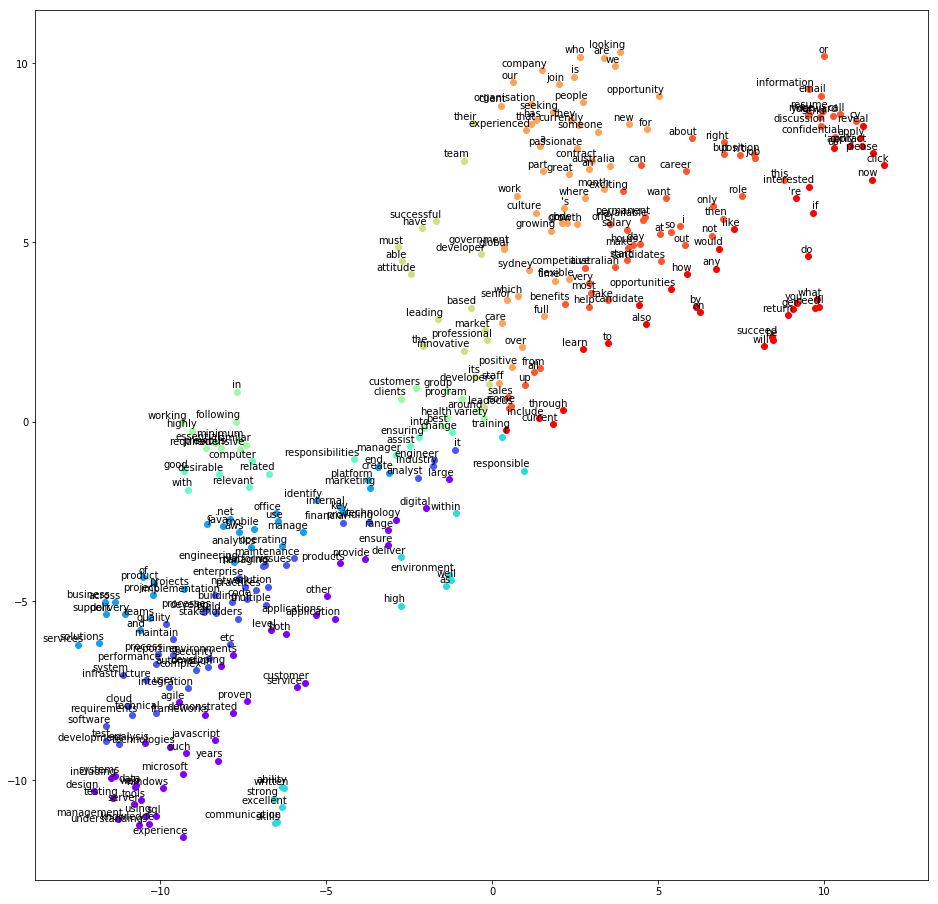

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.9970510005950928), ('aws', 0.9960932731628418), ('mobile', 0.9935588836669922), ('c', 0.9927834272384644), ('etc', 0.9907892942428589)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('using', 0.9975801706314087), ('windows', 0.9963558912277222), ('knowledge', 0.995356023311615), ('tools', 0.9937635660171509), ('server', 0.9918848872184753), ('microsoft', 0.9905188083648682), ('such', 0.989794135093689), ('understanding', 0.9886107444763184), ('technologies', 0.9878063201904297), ('data', 0.9857537746429443)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9968447685241699), ('using', 0.9967882633209229), ('microsoft', 0.9966469407081604), ('tools', 0.9965907335281372), ('sql', 0.9963560104370117), ('knowledge', 0.9923419952392578), ('data', 0.9913375377655029), ('technologies', 0.9909240007400513), ('such', 0.9905625581741333), ('understanding', 0.9855484366416931)]
preprocessing


338it [12:20,  2.32s/it]
188it [04:46,  1.26s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


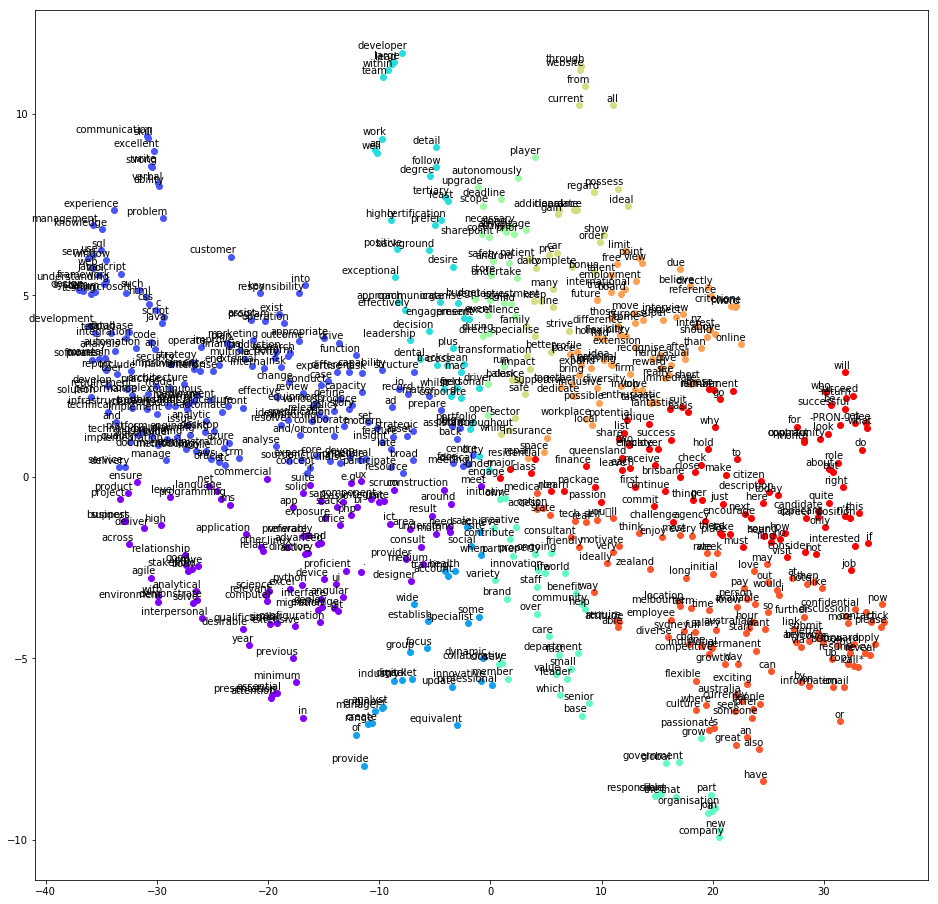

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.998022198677063), ('script', 0.9962003827095032), ('aws', 0.9959158897399902), ('css', 0.9954969882965088), ('api', 0.9953340888023376)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('window', 0.9988839626312256), ('javascript', 0.9967936277389526), ('framework', 0.9964959621429443), ('tool', 0.9959349036216736), ('use', 0.9934209585189819), ('server', 0.9926824569702148), ('microsoft', 0.9919813871383667), ('knowledge', 0.9919273853302002), ('understanding', 0.9912999272346497), ('web', 0.9892789125442505)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:17,  2.32s/it]
188it [04:45,  1.24s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


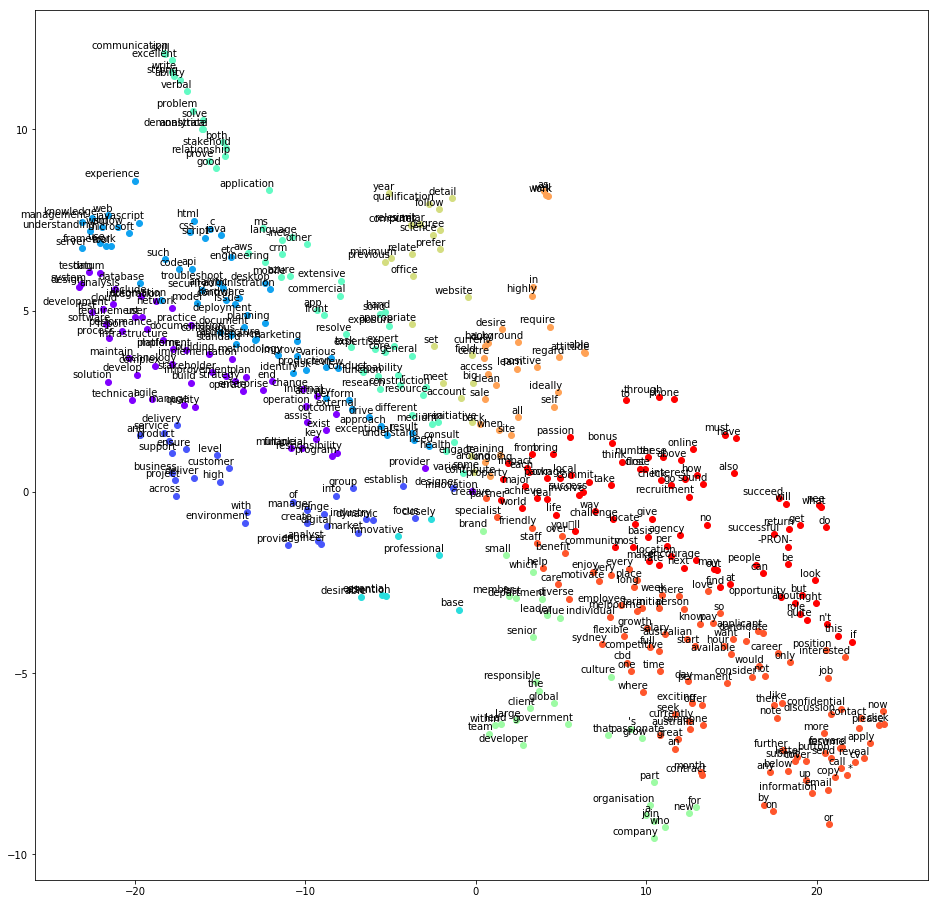

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9965119361877441), ('aws', 0.9955093860626221), ('css', 0.9943684935569763), ('desktop', 0.9932481050491333), ('etc', 0.992499589920044)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('framework', 0.9975379705429077), ('tool', 0.995918333530426), ('window', 0.9958736896514893), ('javascript', 0.9952693581581116), ('knowledge', 0.9945105910301208), ('understanding', 0.9937708377838135), ('microsoft', 0.9935903549194336), ('use', 0.9929803609848022), ('server', 0.9927366375923157), ('database', 0.9834677577018738)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:17,  2.32s/it]
188it [04:45,  1.24s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


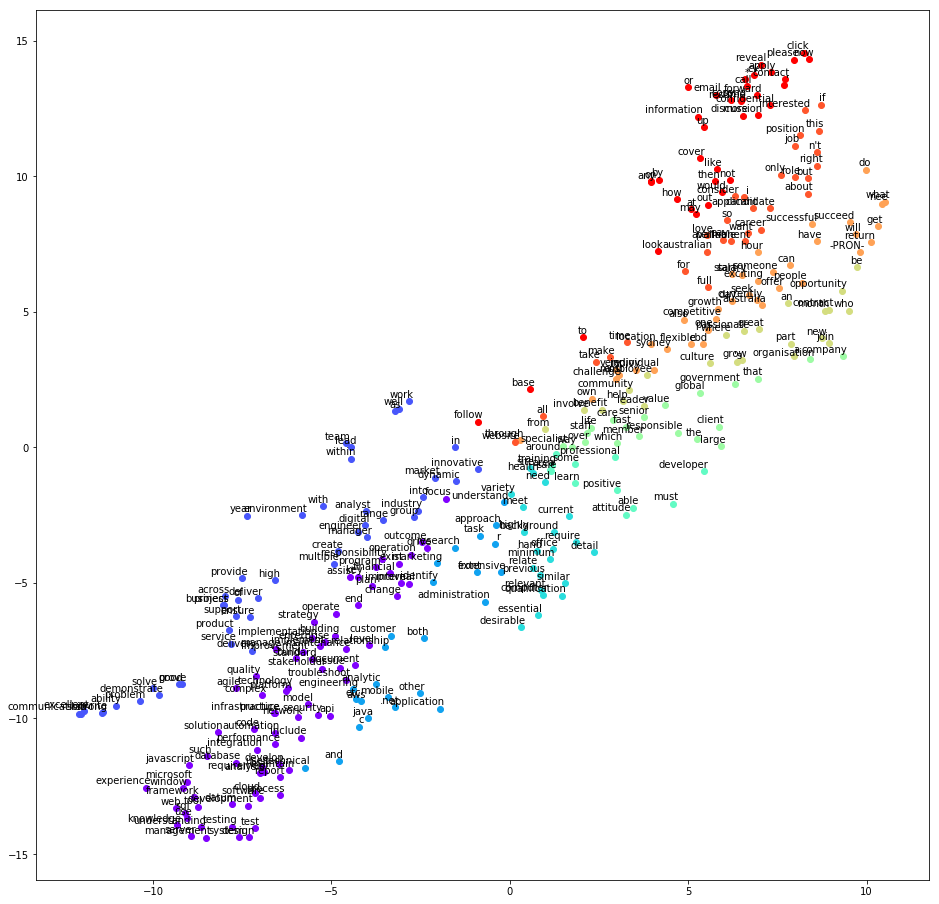

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9953876733779907), ('aws', 0.994401216506958), ('.net', 0.9937257170677185), ('mobile', 0.9929742813110352), ('etc', 0.9917876720428467)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('tool', 0.9980036616325378), ('use', 0.9974960088729858), ('framework', 0.9972065687179565), ('server', 0.997180700302124), ('window', 0.997128963470459), ('microsoft', 0.9949941039085388), ('javascript', 0.9915809035301208), ('knowledge', 0.9902216196060181), ('web', 0.9889675378799438), ('such', 0.9869193434715271)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:17,  2.32s/it]
188it [04:44,  1.25s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


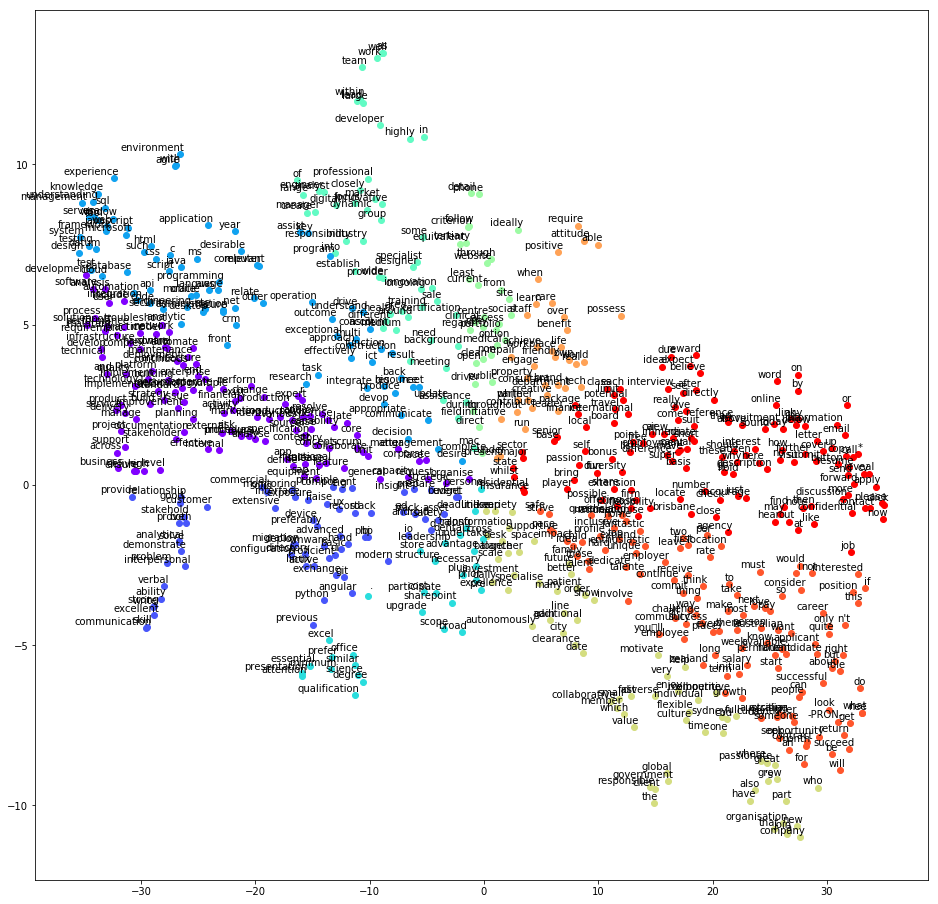

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('aws', 0.9962051510810852), ('c', 0.9956136345863342), ('oracle', 0.9949067831039429), ('programming', 0.9948146939277649), ('mobile', 0.9940637350082397)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('framework', 0.9968249201774597), ('window', 0.9953762292861938), ('knowledge', 0.9948508739471436), ('tool', 0.9944963455200195), ('server', 0.9941989183425903), ('javascript', 0.9941831231117249), ('use', 0.9931760430335999), ('understanding', 0.9899730086326599), ('microsoft', 0.9887071847915649), ('web', 0.987775981426239)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:17,  2.33s/it]
188it [04:46,  1.32s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


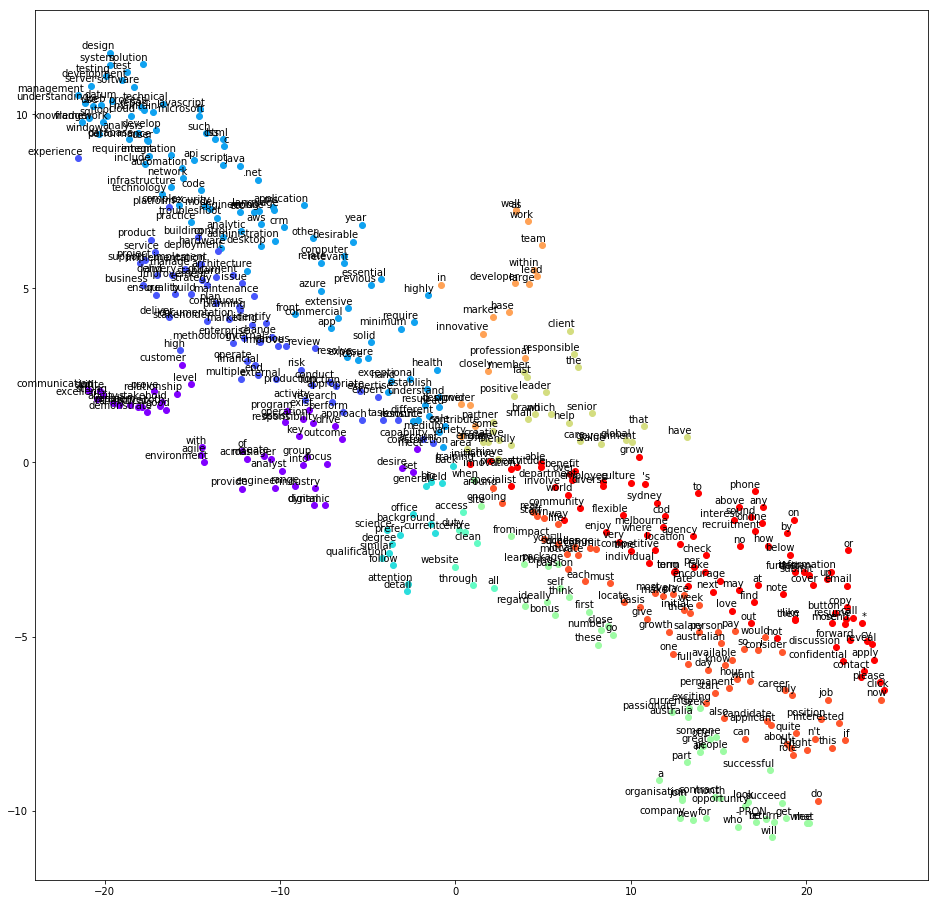

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.9962155818939209), ('language', 0.9960545301437378), ('html', 0.9949389100074768), ('aws', 0.9946296811103821), ('script', 0.9935479760169983)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('window', 0.9969037771224976), ('knowledge', 0.9955120086669922), ('server', 0.995505690574646), ('framework', 0.99480140209198), ('use', 0.9937382340431213), ('understanding', 0.9929986000061035), ('tool', 0.9917280077934265), ('javascript', 0.9911384582519531), ('microsoft', 0.9864100217819214), ('css', 0.9835758209228516)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [12:20,  2.30s/it]
188it [04:46,  1.27s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


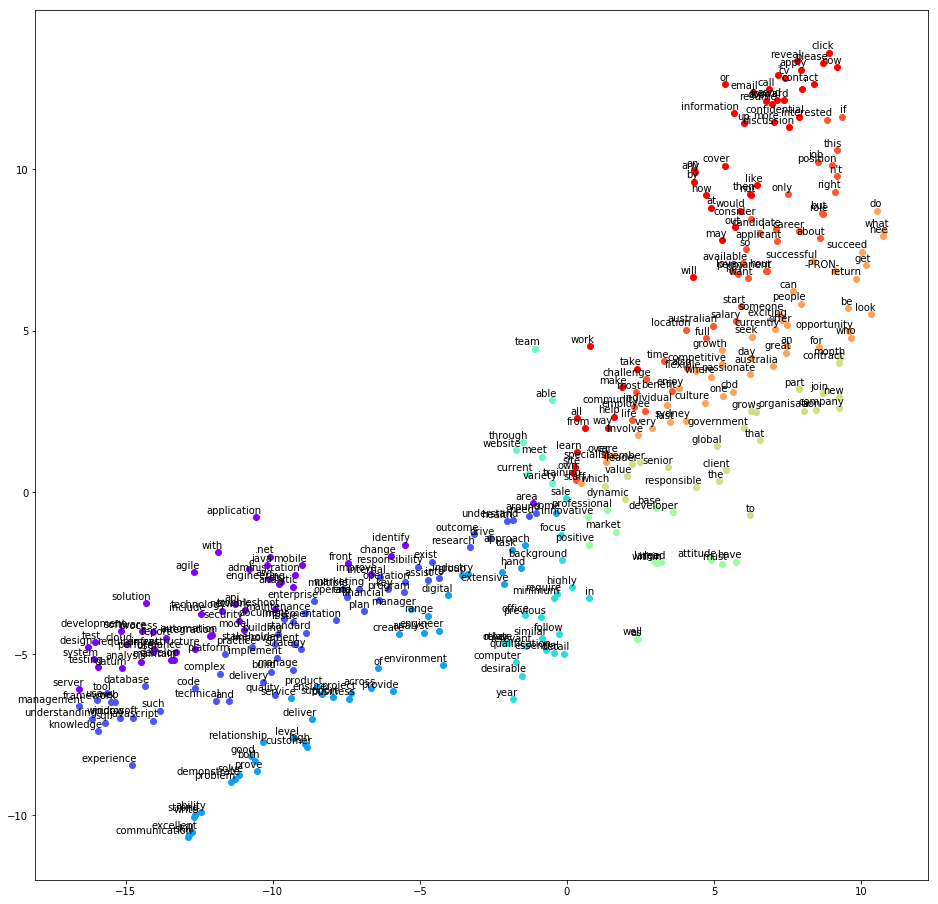

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.9961963891983032), ('c', 0.9953209161758423), ('aws', 0.9952829480171204), ('api', 0.991931140422821), ('administration', 0.9919057488441467)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('window', 0.9966188669204712), ('knowledge', 0.9947831630706787), ('framework', 0.9940025806427002), ('microsoft', 0.9939791560173035), ('javascript', 0.9927915334701538), ('tool', 0.9907647967338562), ('such', 0.9895573854446411), ('server', 0.9893609285354614), ('use', 0.9892194867134094), ('understanding', 0.9859306812286377)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:54,  5.82it/s]
188it [00:21,  8.32it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


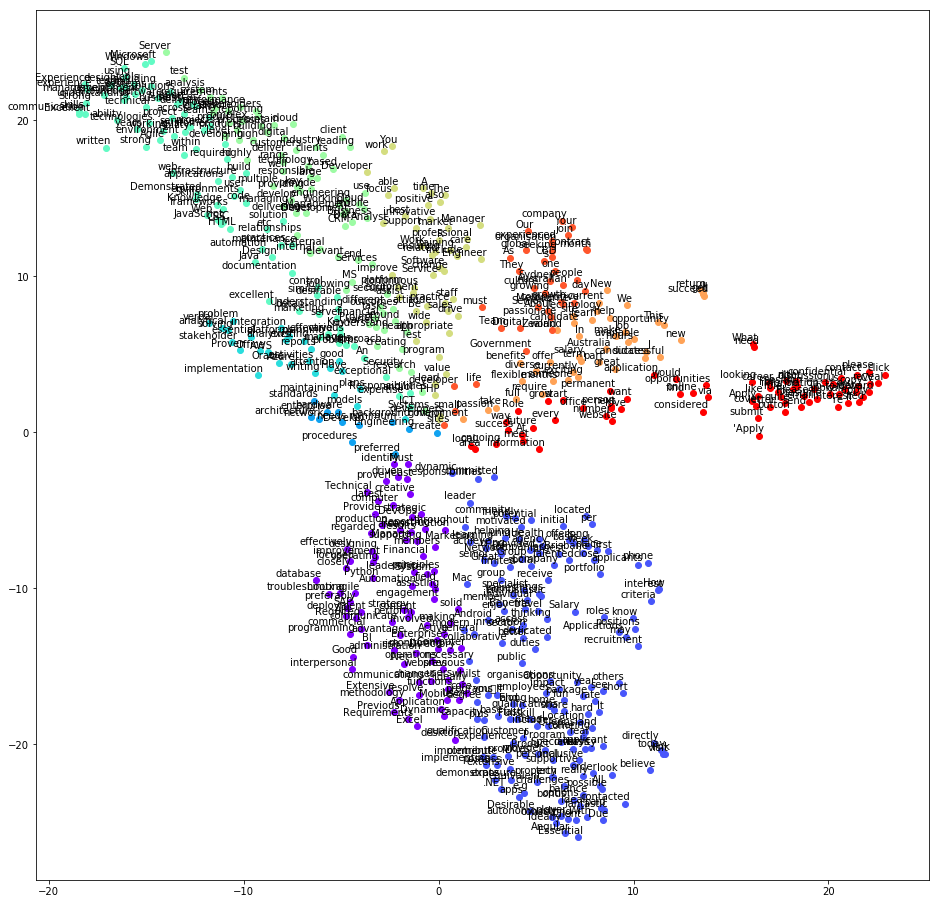

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:53,  5.53it/s]
188it [00:20,  8.77it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


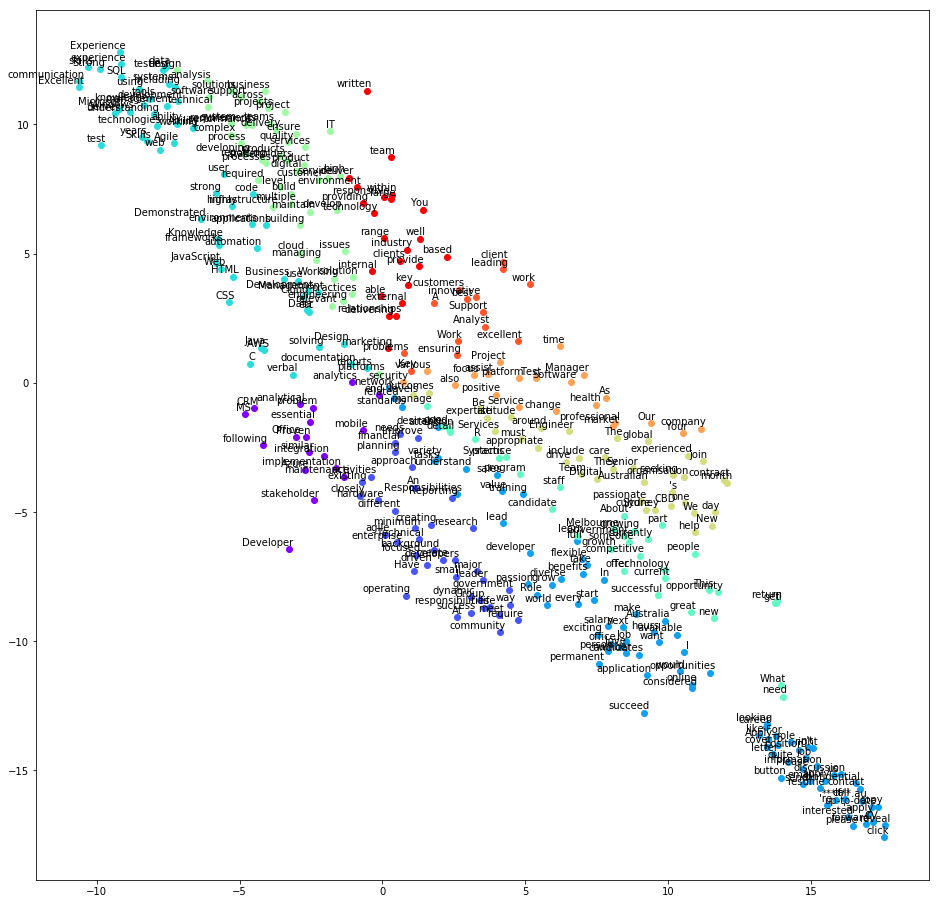

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:54,  5.47it/s]
188it [00:21,  8.81it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


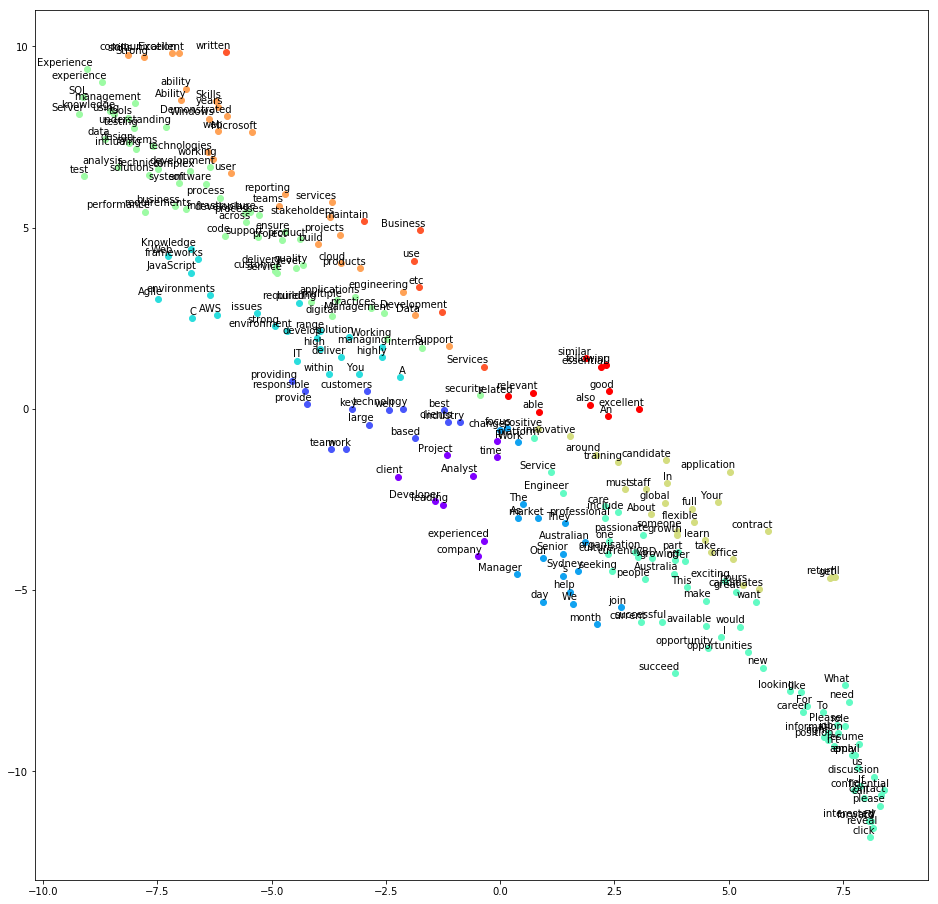

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:54,  5.51it/s]
188it [00:21,  8.75it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


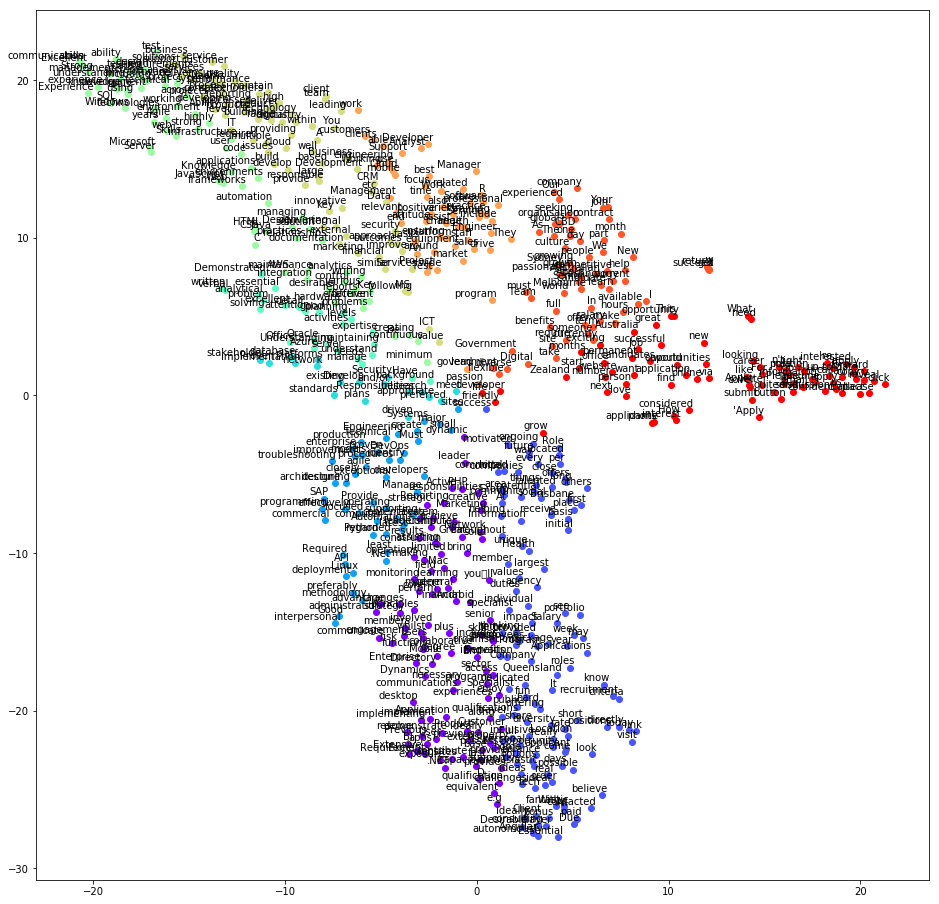

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:54,  5.51it/s]
188it [00:21,  8.68it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


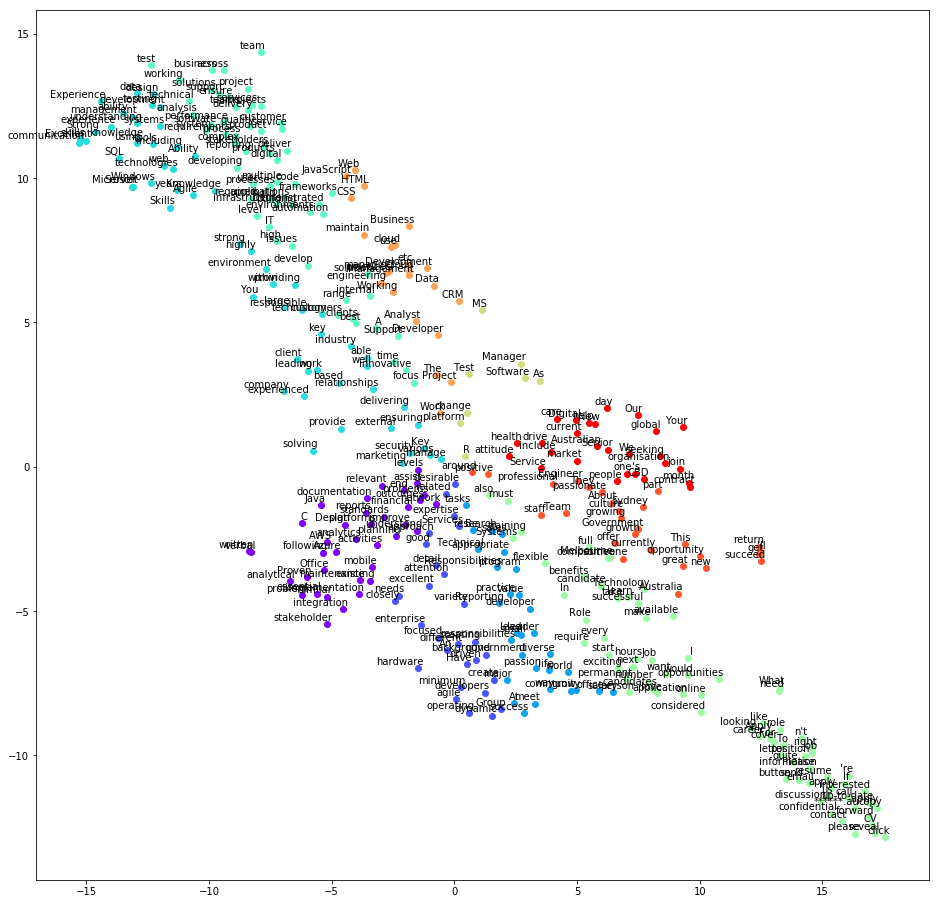

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:54,  5.52it/s]
188it [00:20,  8.85it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


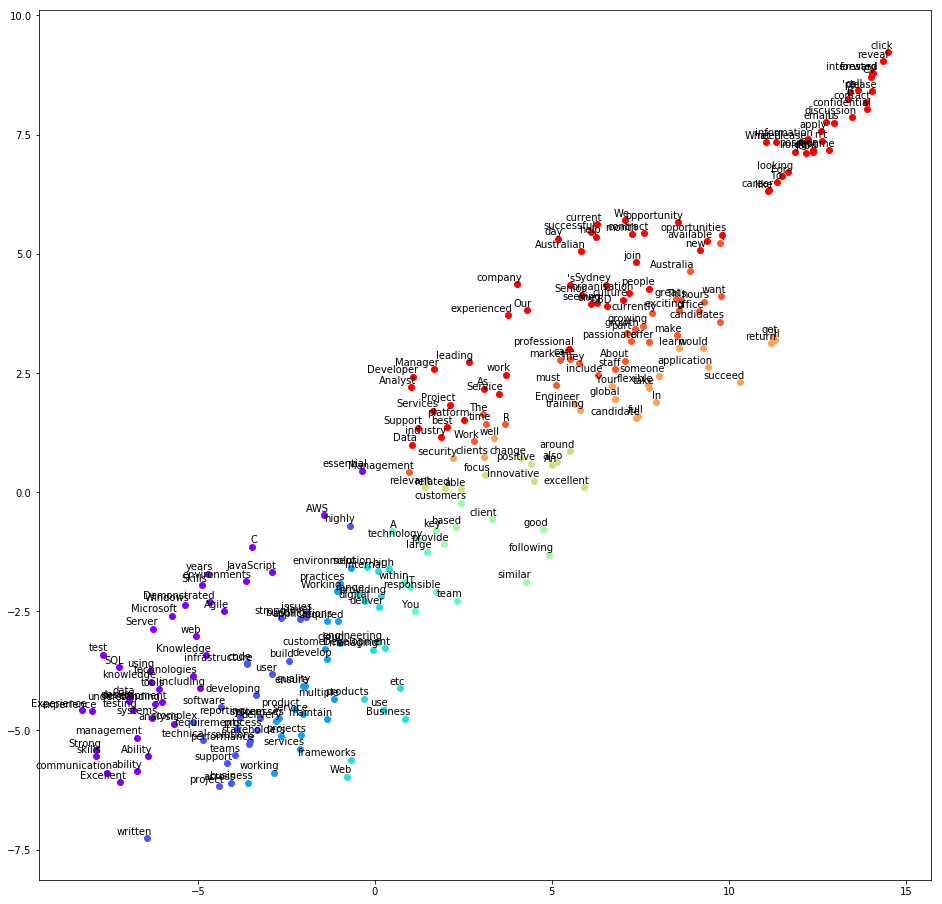

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:59,  2.64s/it]
188it [05:23,  1.51s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


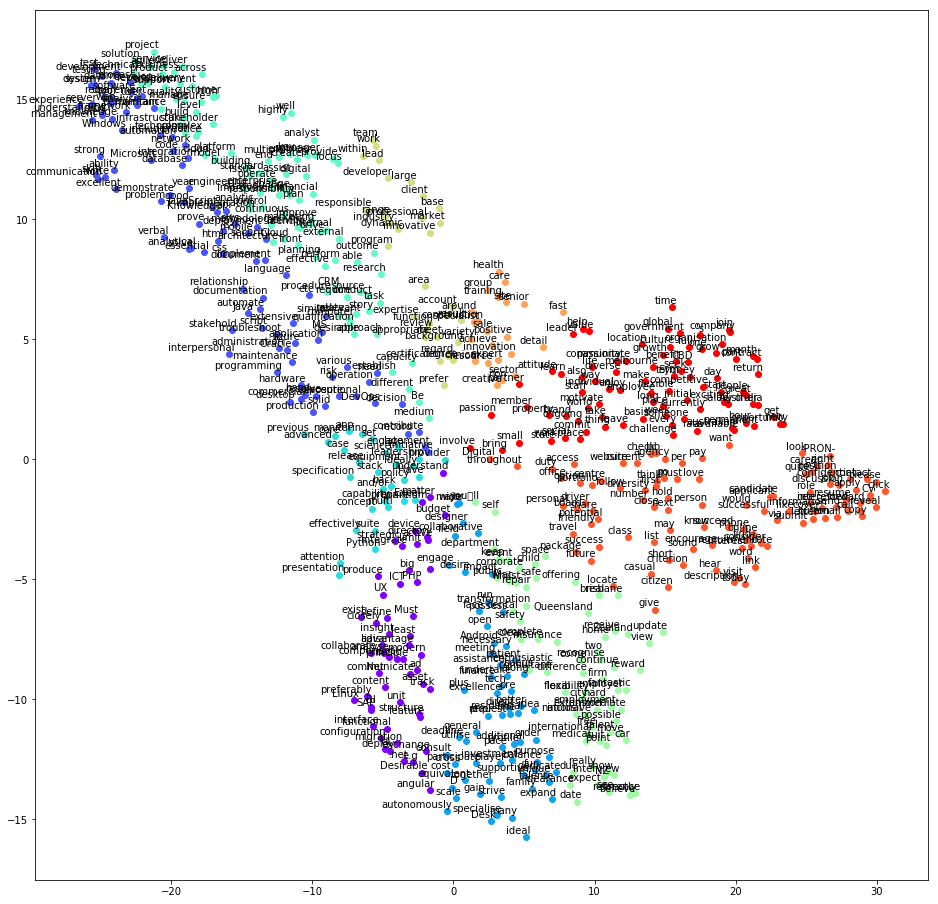

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:56,  2.64s/it]
188it [05:24,  1.50s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


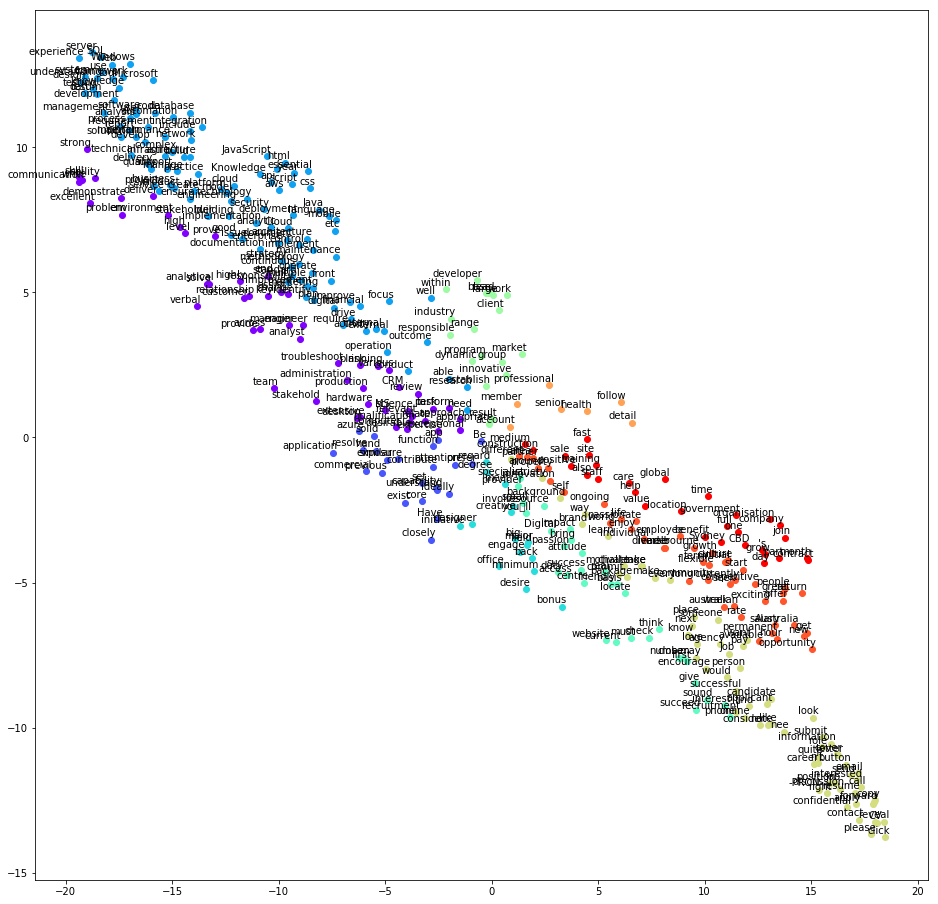

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:53,  2.64s/it]
188it [05:24,  1.40s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


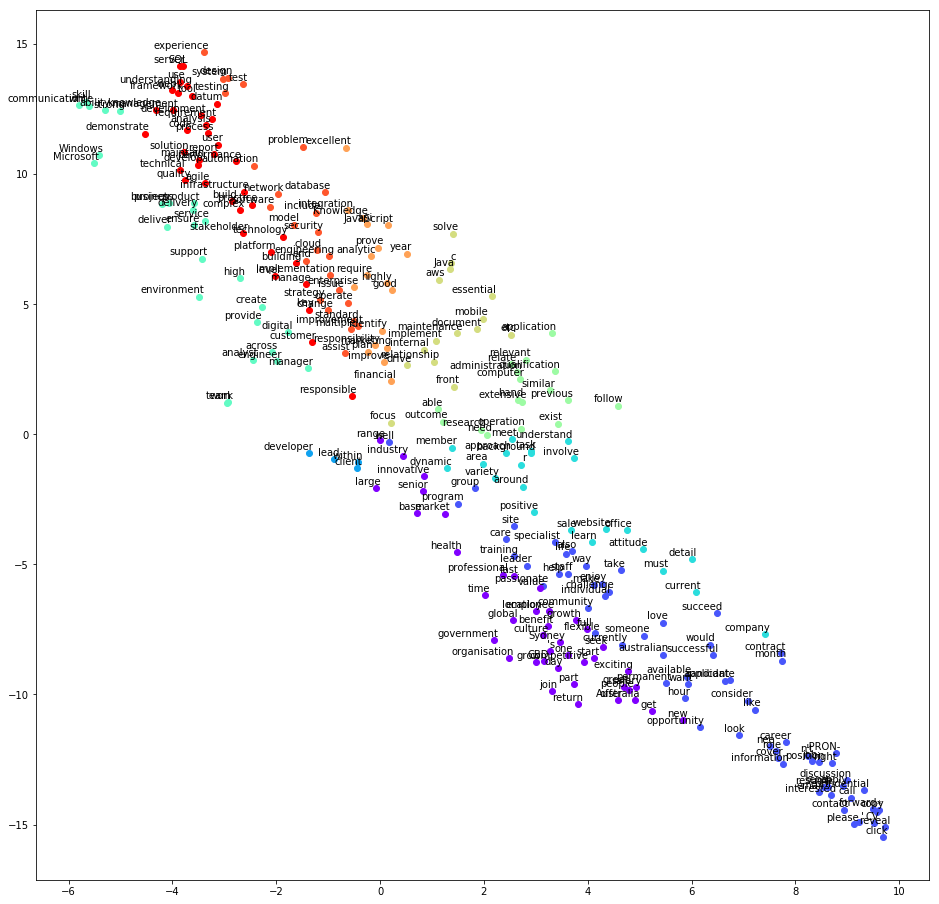

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [14:00,  2.63s/it]
188it [05:23,  1.42s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


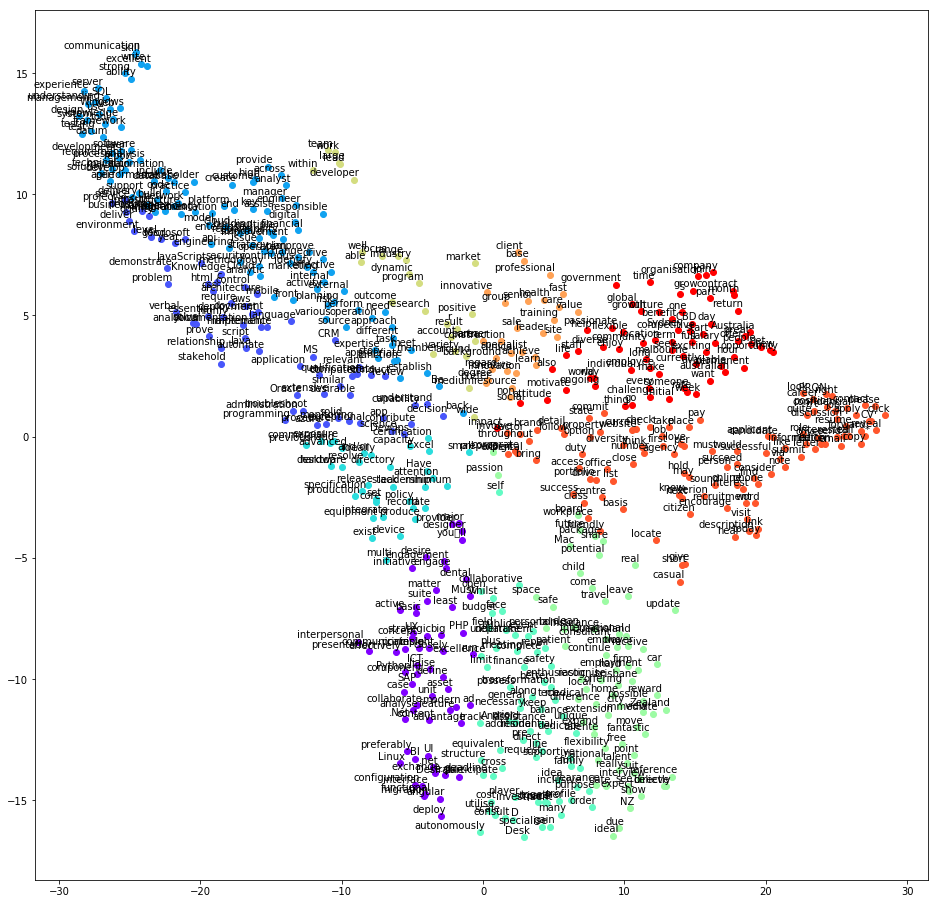

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:56,  2.63s/it]
188it [05:24,  1.42s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


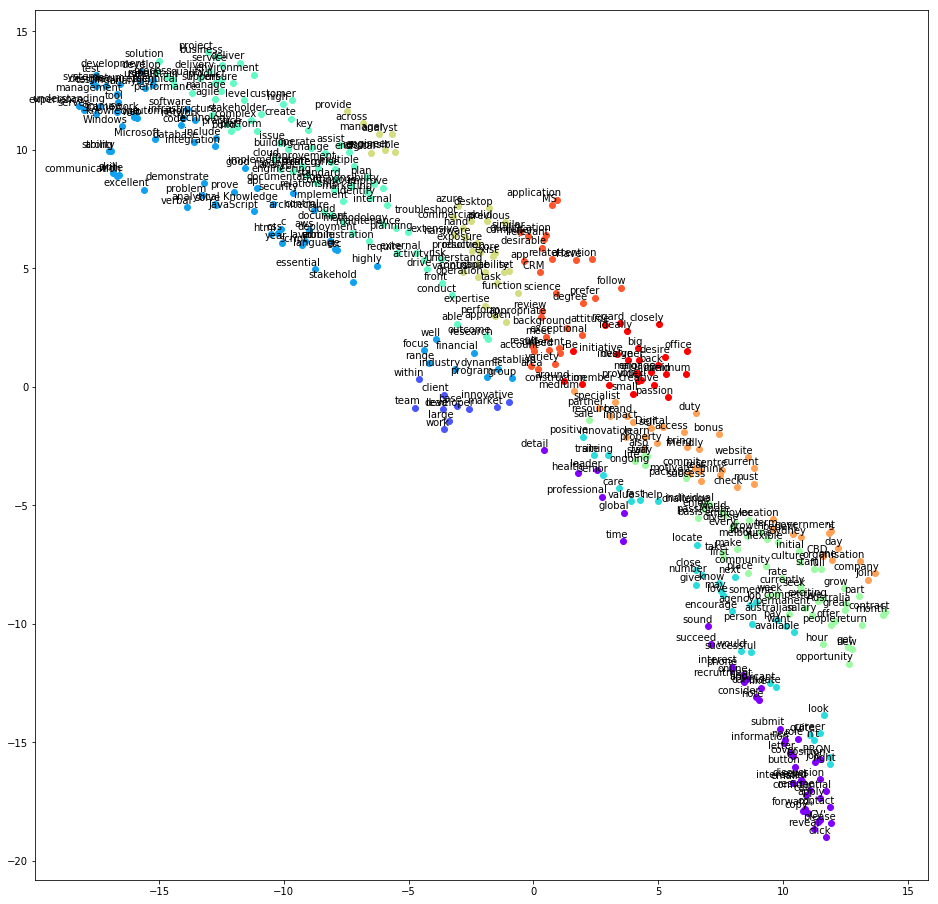

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:55,  2.67s/it]
188it [05:22,  1.40s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


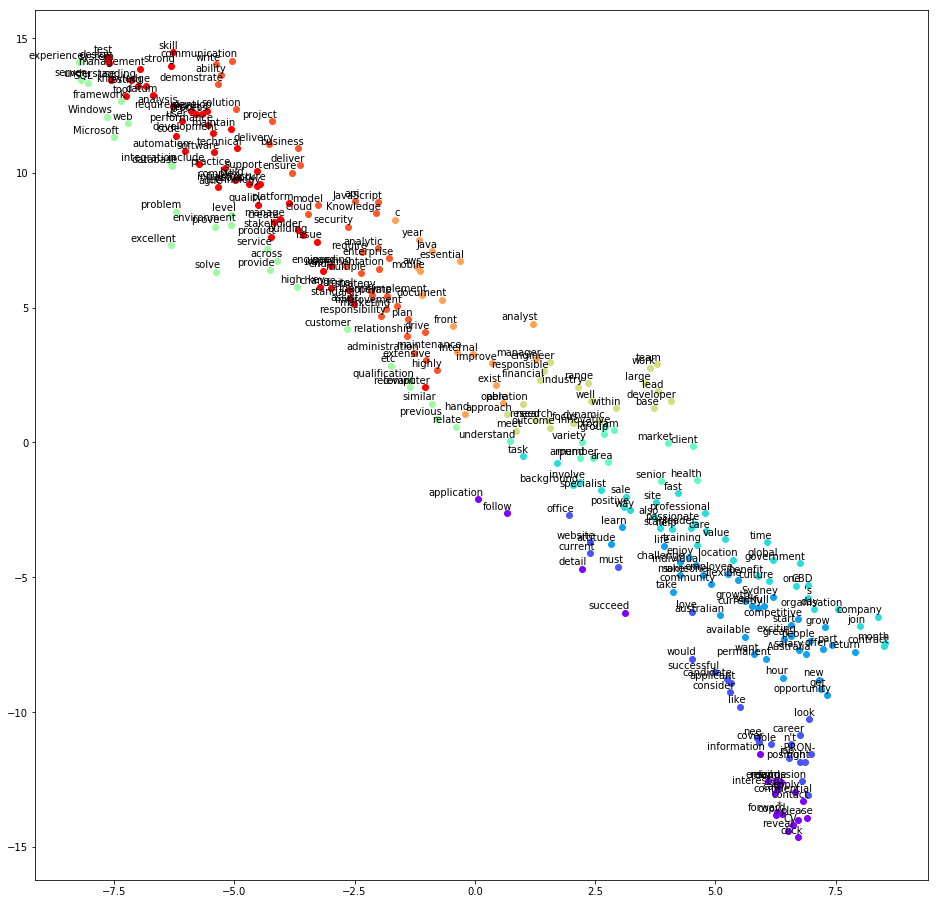

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [00:54,  5.54it/s]
188it [00:21,  8.79it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


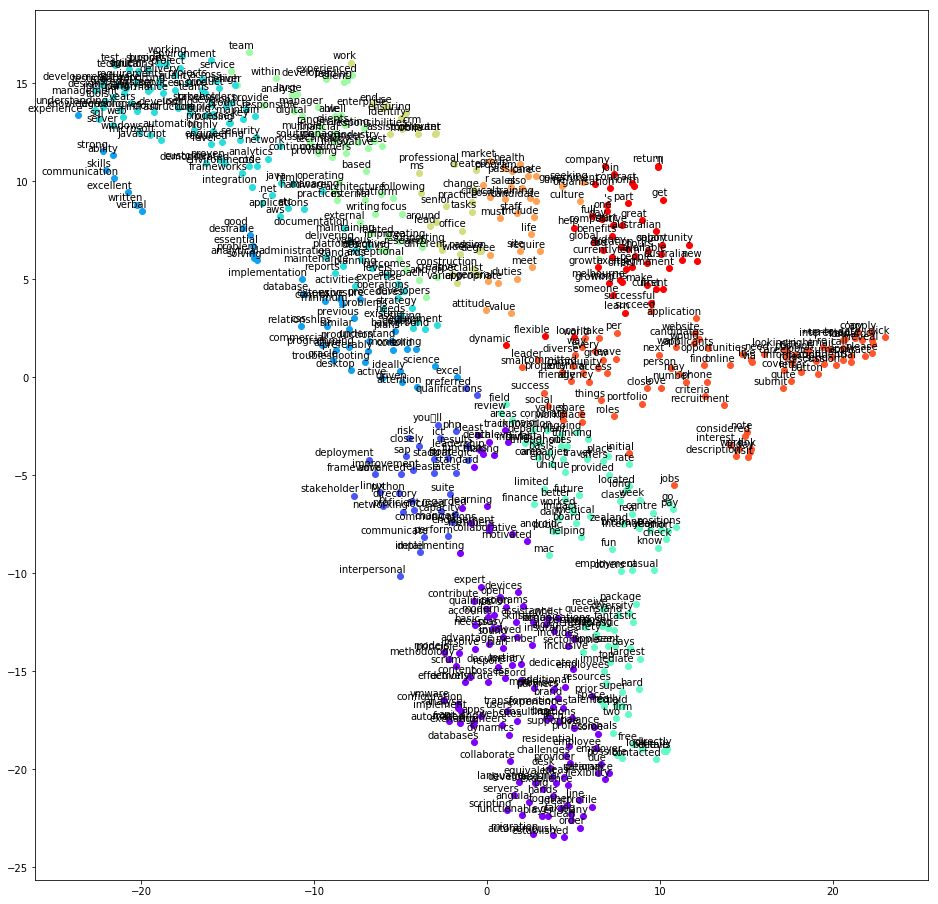

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.9993768930435181), ('oracle', 0.9992847442626953), ('etc', 0.9992091059684753), ('scripting', 0.9991810917854309), ('aws', 0.9991449117660522)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('knowledge', 0.9975422620773315), ('server', 0.9970053434371948), ('tools', 0.9968788027763367), ('understanding', 0.9961287975311279), ('web', 0.9960660934448242), ('using', 0.9960033893585205), ('development', 0.9937145709991455), ('testing', 0.9933490753173828), ('design', 0.9933253526687622), ('including', 0.9926532506942749)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('microsoft', 0.9986030459403992), ('server', 0.9976386427879333), ('technologies', 0.9967806339263916), ('using', 0.9961109757423401), ('javascript', 0.9961029291152954), ('web', 0.9955432415008545), ('cloud', 0.9946505427360535), ('including', 0.9939574003219604), ('user', 0.9932732582092285), ('c', 0.9927402138710022)]
preprocessing


338it [00:54,  5.53it/s]
188it [00:21,  8.81it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


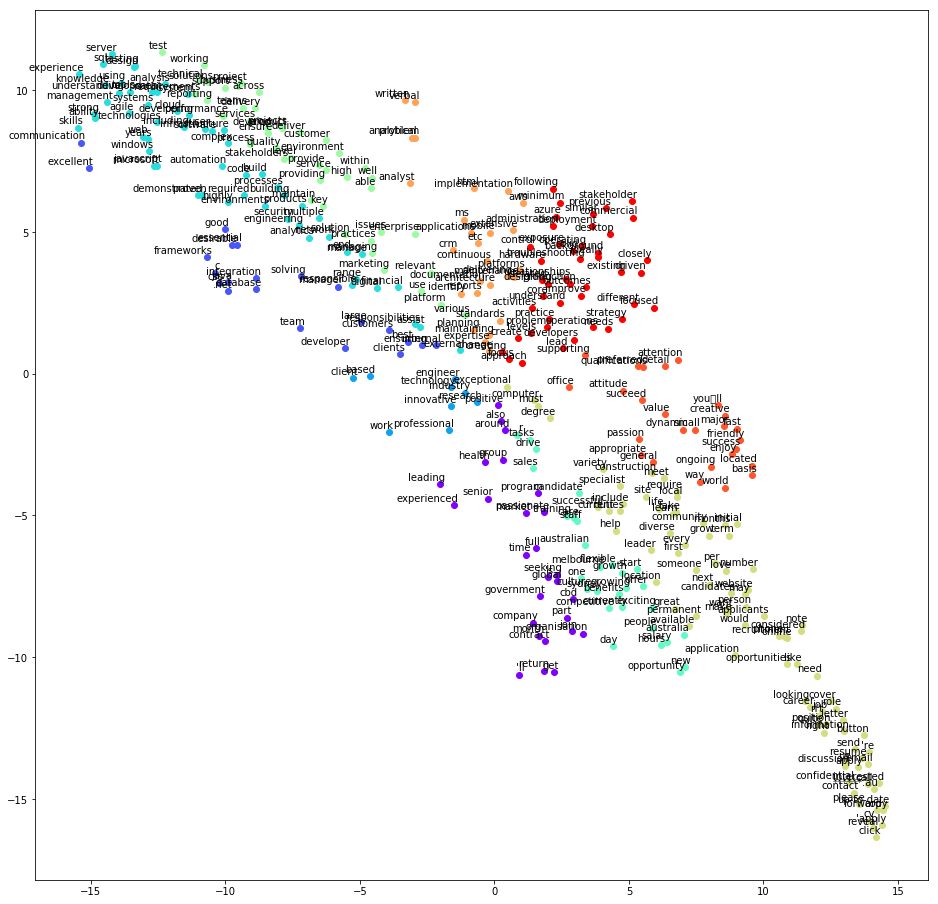

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.999252438545227), ('css', 0.9990271329879761), ('aws', 0.9988524317741394), ('c', 0.9986656904220581), ('database', 0.9986515045166016)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9963563680648804), ('using', 0.9962953329086304), ('knowledge', 0.995725154876709), ('tools', 0.9947097301483154), ('understanding', 0.9934829473495483), ('web', 0.9931398630142212), ('windows', 0.9911492466926575), ('systems', 0.9902498722076416), ('technologies', 0.989983856678009), ('testing', 0.9898056983947754)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('microsoft', 0.9987464547157288), ('web', 0.9977891445159912), ('technologies', 0.9977203011512756), ('server', 0.9976345896720886), ('javascript', 0.9973106384277344), ('years', 0.9965833425521851), ('including', 0.9964414834976196), ('systems', 0.9962108731269836), ('demonstrated', 0.99617600440979), ('tools', 0.9958481788635254)]
preprocessing


338it [00:54,  5.52it/s]
188it [00:20,  8.79it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


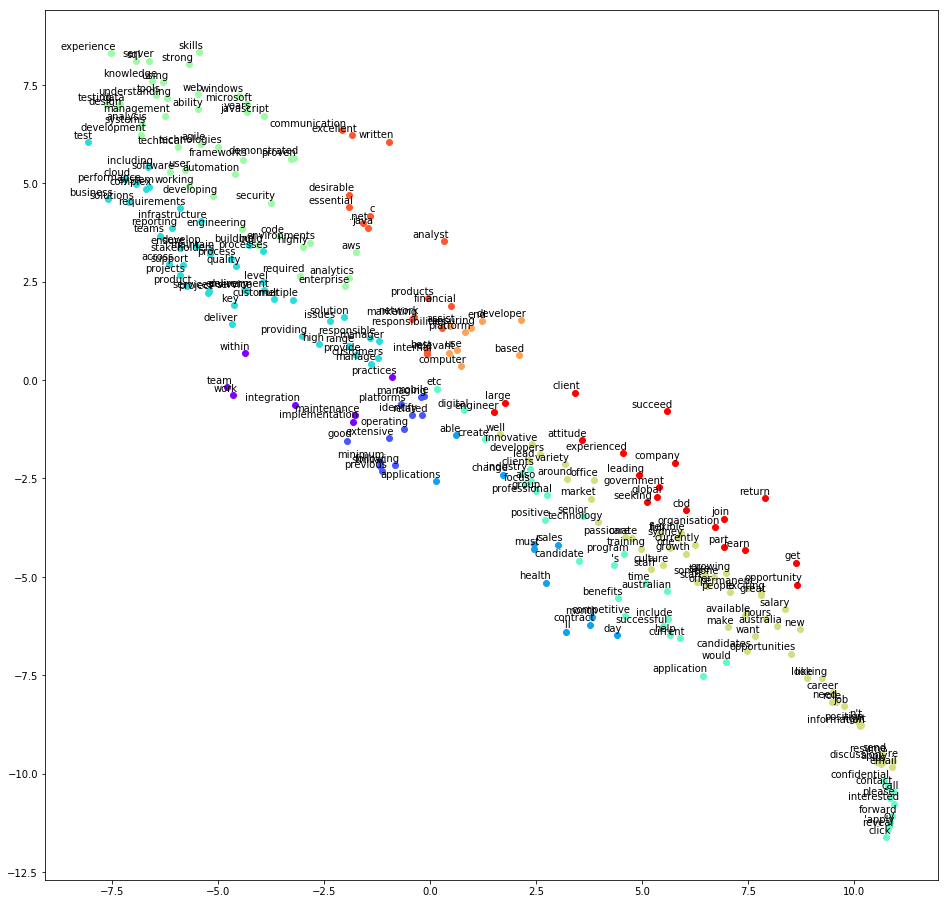

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9994282722473145), ('.net', 0.9994161128997803), ('aws', 0.9991211295127869), ('frameworks', 0.998846173286438), ('extensive', 0.9987264275550842)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9979543685913086), ('knowledge', 0.9977994561195374), ('using', 0.9973904490470886), ('tools', 0.9970520734786987), ('web', 0.996597170829773), ('understanding', 0.9964613318443298), ('windows', 0.9955975413322449), ('data', 0.995283305644989), ('design', 0.9947180151939392), ('testing', 0.9943683743476868)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('microsoft', 0.9991425275802612), ('server', 0.9988033771514893), ('javascript', 0.9981265068054199), ('using', 0.9980989694595337), ('years', 0.9980170726776123), ('technologies', 0.9979683756828308), ('web', 0.9978420734405518), ('tools', 0.9976718425750732), ('demonstrated', 0.9973928928375244), ('understanding', 0.9973251223564148)]
preprocessing


338it [00:53,  5.53it/s]
188it [00:20,  8.81it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


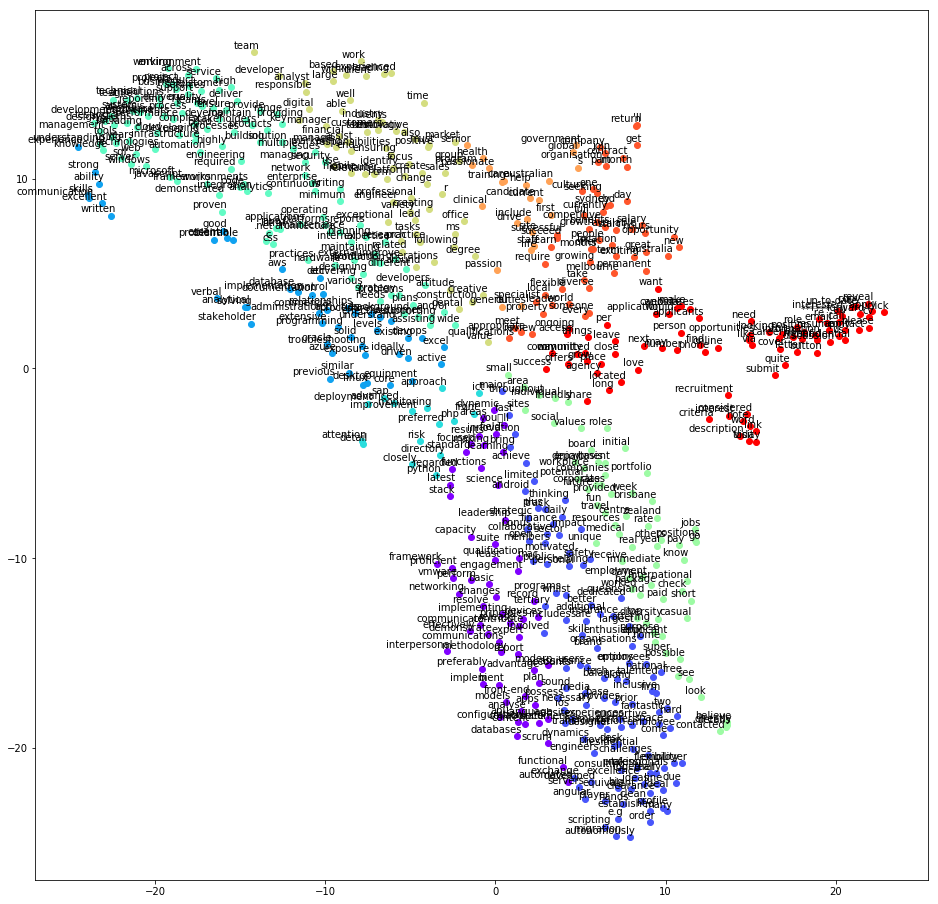

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.9994528889656067), ('extensive', 0.999238133430481), ('html', 0.9992067813873291), ('framework', 0.9992032647132874), ('oracle', 0.9991776943206787)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.99839848279953), ('web', 0.9973944425582886), ('using', 0.9973208904266357), ('tools', 0.9964373707771301), ('windows', 0.9961740970611572), ('knowledge', 0.9959613680839539), ('years', 0.9946660995483398), ('understanding', 0.9941953420639038), ('data', 0.9934107065200806), ('technologies', 0.993392825126648)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9981329441070557), ('microsoft', 0.9974111318588257), ('technologies', 0.99711674451828), ('web', 0.9970031976699829), ('sql', 0.9961740970611572), ('including', 0.9952445030212402), ('javascript', 0.995021402835846), ('using', 0.9949983358383179), ('cloud', 0.9940381646156311), ('frameworks', 0.9939058423042297)]
preprocessing


338it [00:54,  5.49it/s]
188it [00:20,  8.84it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


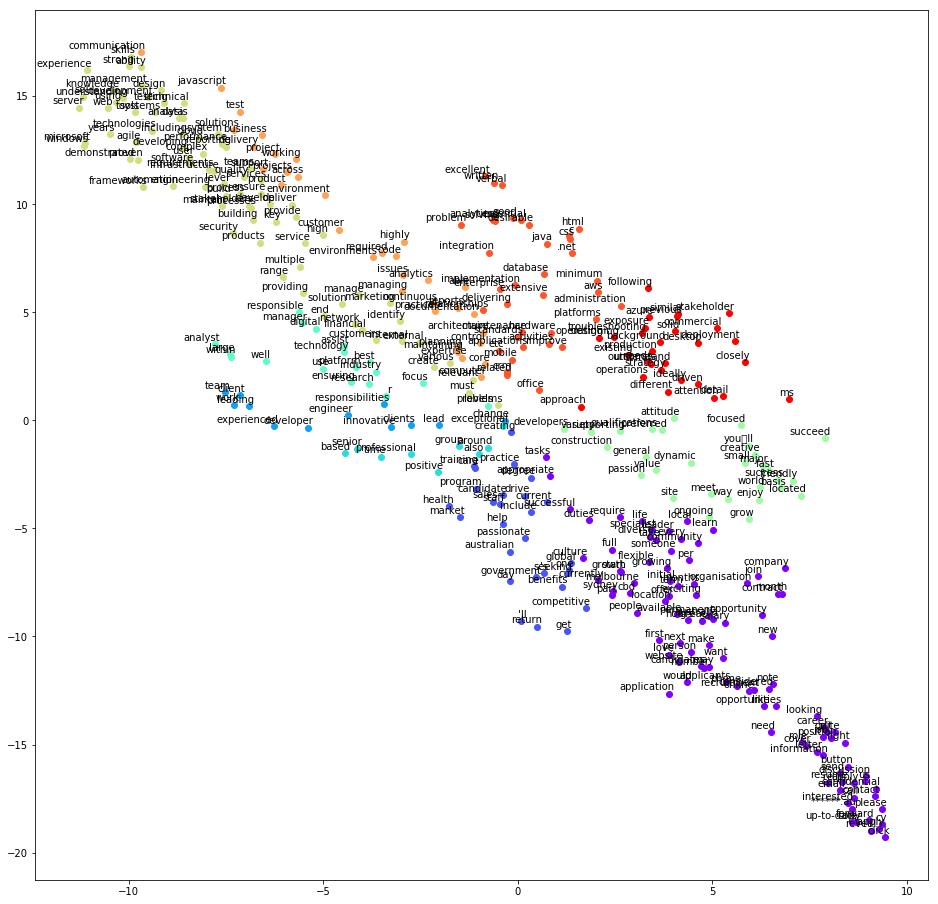

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('frameworks', 0.9990169405937195), ('.net', 0.9989824891090393), ('c', 0.9989715814590454), ('html', 0.9984842538833618), ('css', 0.9984413385391235)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9974877834320068), ('web', 0.9972927570343018), ('knowledge', 0.9970022439956665), ('using', 0.9966726303100586), ('understanding', 0.995408296585083), ('tools', 0.9942212700843811), ('years', 0.9925158023834229), ('development', 0.9924846887588501), ('systems', 0.991703987121582), ('microsoft', 0.9916543364524841)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('microsoft', 0.9993457794189453), ('javascript', 0.9973138570785522), ('frameworks', 0.996817946434021), ('technologies', 0.9967163801193237), ('server', 0.9965153932571411), ('demonstrated', 0.996367871761322), ('integration', 0.9957849383354187), ('java', 0.9957370162010193), ('c', 0.9953731894493103), ('including', 0.9953640699386597)]
preprocessing


338it [00:54,  5.44it/s]
188it [00:20,  8.80it/s]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


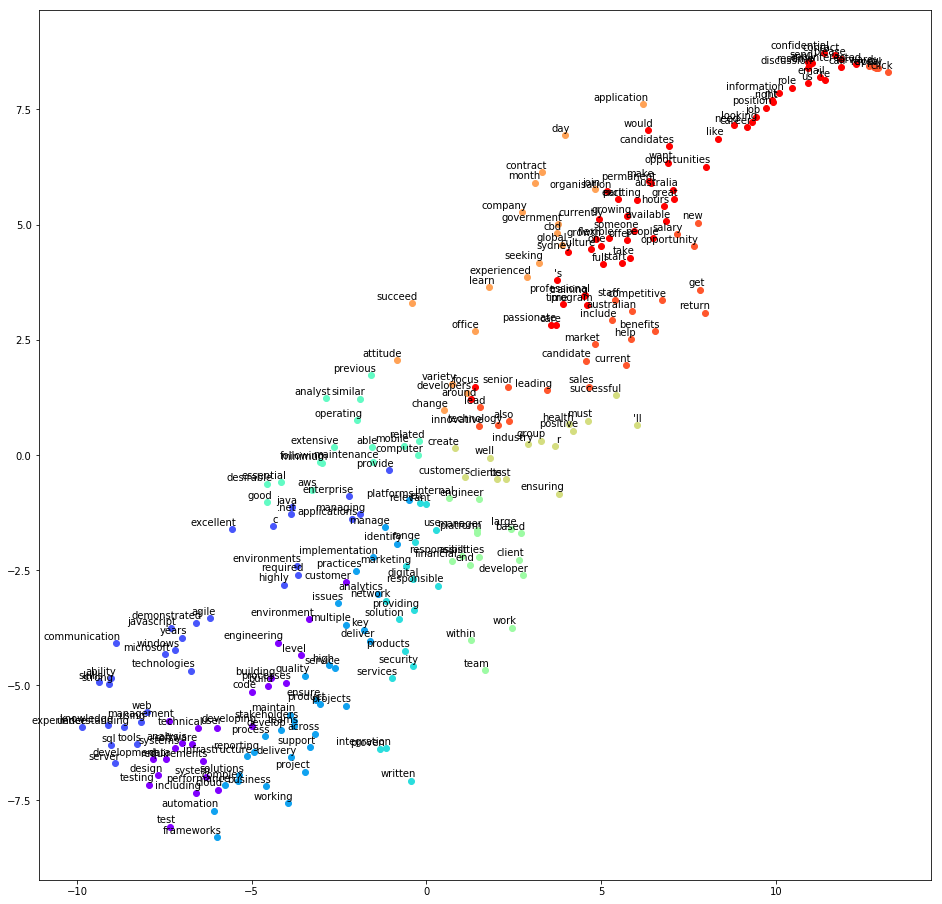

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9994931221008301), ('.net', 0.9994693398475647), ('aws', 0.9990856647491455), ('environments', 0.9989528656005859), ('frameworks', 0.998897910118103)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9990026354789734), ('using', 0.9980296492576599), ('knowledge', 0.9978506565093994), ('web', 0.9977760314941406), ('tools', 0.9977429509162903), ('understanding', 0.9975637197494507), ('microsoft', 0.9968056678771973), ('javascript', 0.9965116381645203), ('windows', 0.9957225322723389), ('strong', 0.9955654144287109)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('microsoft', 0.999370813369751), ('technologies', 0.999003529548645), ('years', 0.9984610080718994), ('javascript', 0.9983295202255249), ('including', 0.9982110261917114), ('demonstrated', 0.9981288909912109), ('proven', 0.9980359077453613), ('frameworks', 0.998019814491272), ('integration', 0.9979205131530762), ('using', 0.9978642463684082)]
preprocessing


338it [14:52,  3.15s/it]
188it [06:22,  1.67s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


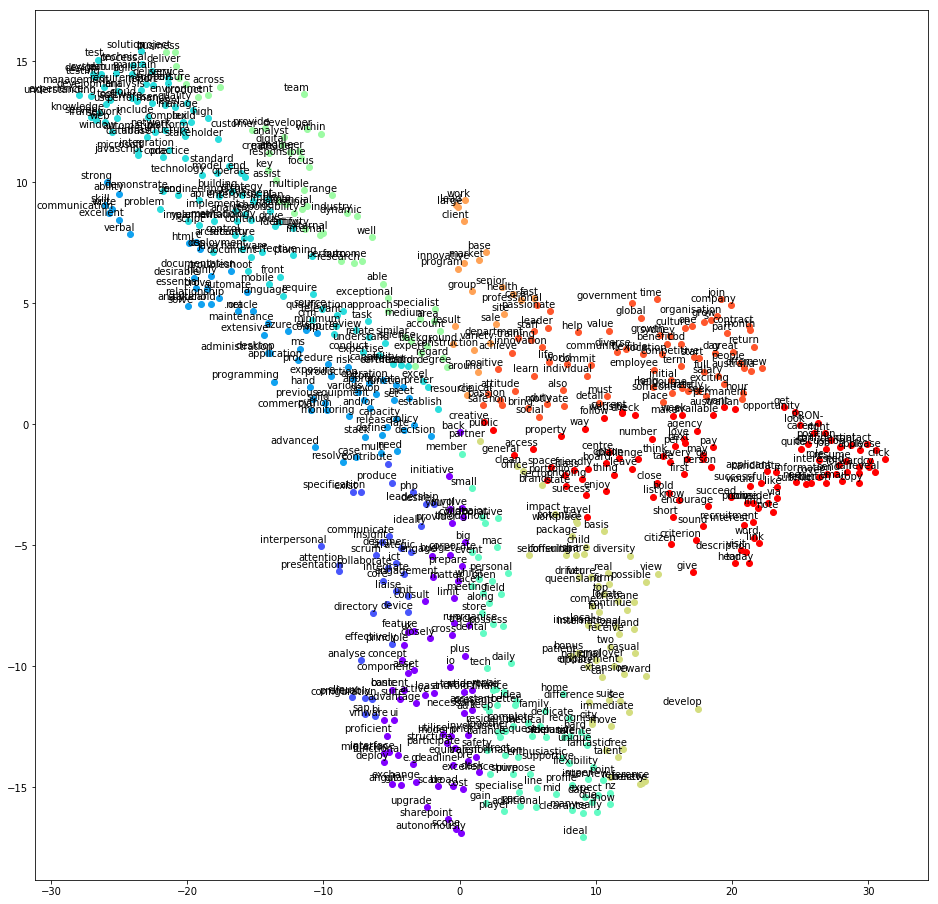

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9991455078125), ('.net', 0.9988782405853271), ('oracle', 0.9981895685195923), ('aws', 0.9981306195259094), ('git', 0.9978406429290771)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9981858730316162), ('web', 0.9979817867279053), ('knowledge', 0.9973479509353638), ('use', 0.9955040216445923), ('window', 0.9953247308731079), ('tool', 0.9937433004379272), ('framework', 0.9923278093338013), ('understanding', 0.9919832944869995), ('development', 0.9878333806991577), ('system', 0.9846208095550537)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [16:39,  3.10s/it]
188it [06:27,  1.66s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


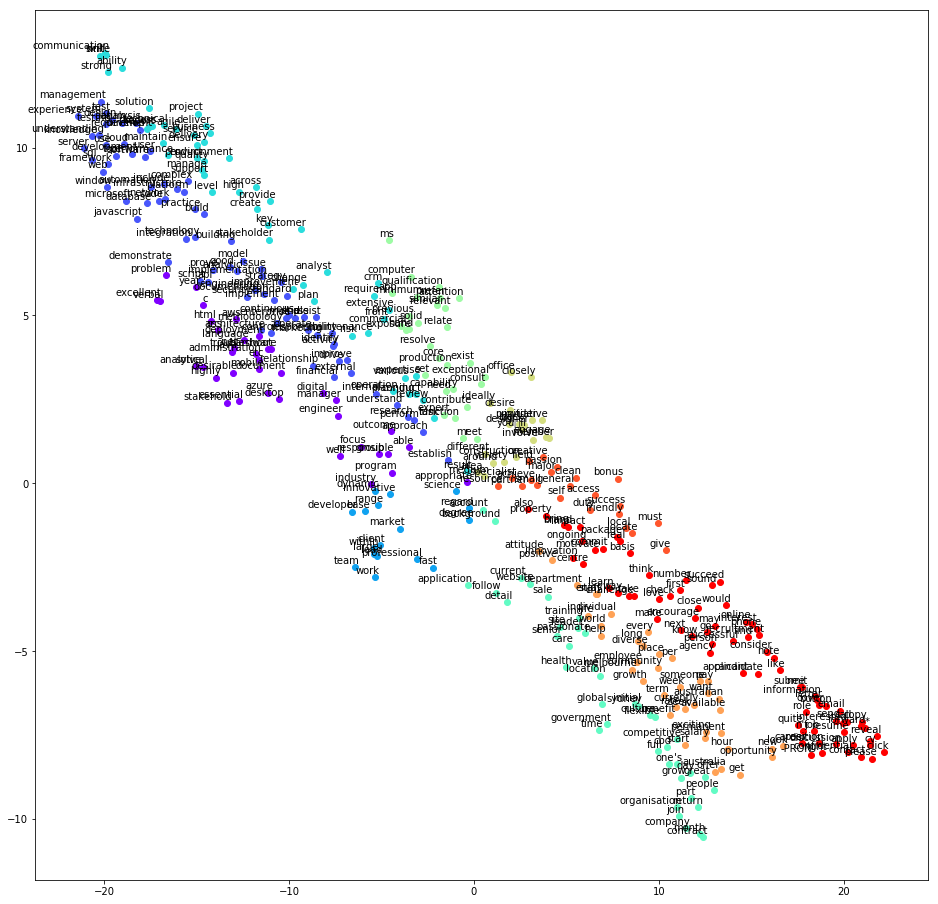

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('.net', 0.9987131357192993), ('c', 0.9981846809387207), ('html', 0.9979907274246216), ('language', 0.9979815483093262), ('aws', 0.9976994395256042)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('web', 0.9977141618728638), ('server', 0.9964816570281982), ('framework', 0.9962891340255737), ('window', 0.9961884617805481), ('knowledge', 0.9954030513763428), ('use', 0.9944743514060974), ('understanding', 0.9937658905982971), ('tool', 0.9935010671615601), ('microsoft', 0.9890856146812439), ('cloud', 0.9857664704322815)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [15:25,  2.61s/it]
188it [05:24,  1.42s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


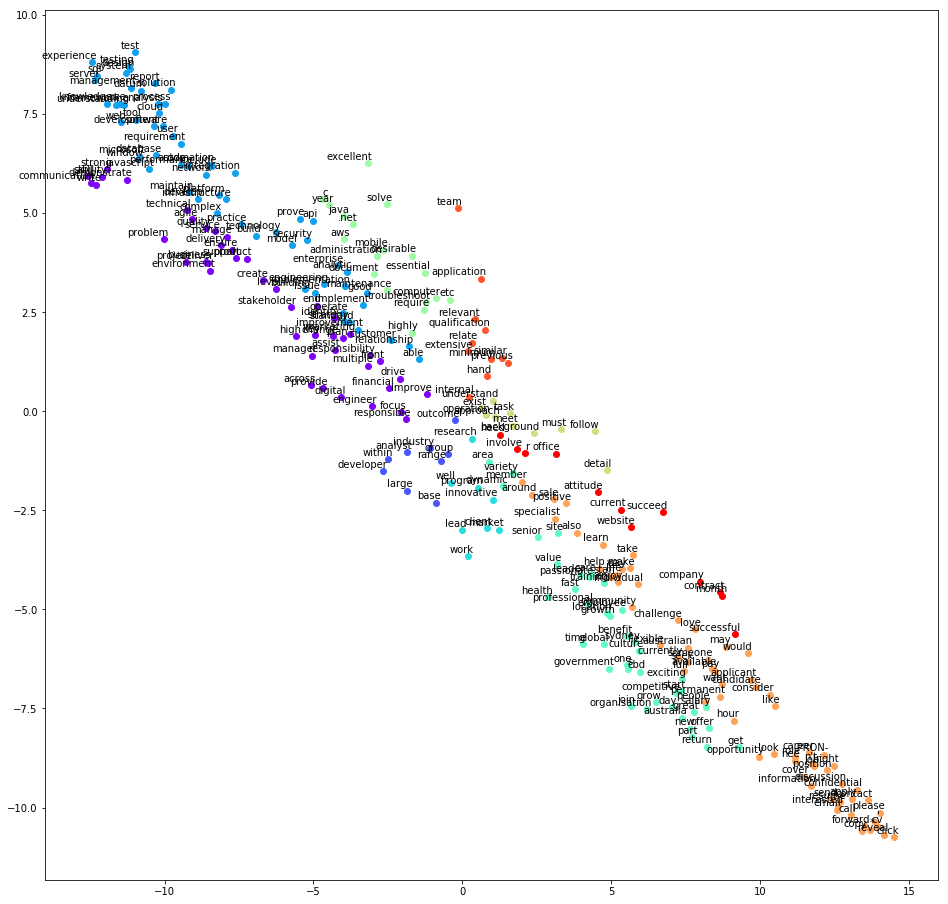

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9990201592445374), ('api', 0.9990044832229614), ('.net', 0.9980302453041077), ('aws', 0.9979500770568848), ('year', 0.9975550174713135)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9982697367668152), ('knowledge', 0.9963427782058716), ('web', 0.9955894947052002), ('use', 0.9948594570159912), ('experience', 0.9942269921302795), ('framework', 0.9925442934036255), ('understanding', 0.9913085103034973), ('tool', 0.9911988973617554), ('system', 0.989970862865448), ('testing', 0.988468587398529)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:55,  2.63s/it]
188it [05:22,  1.43s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


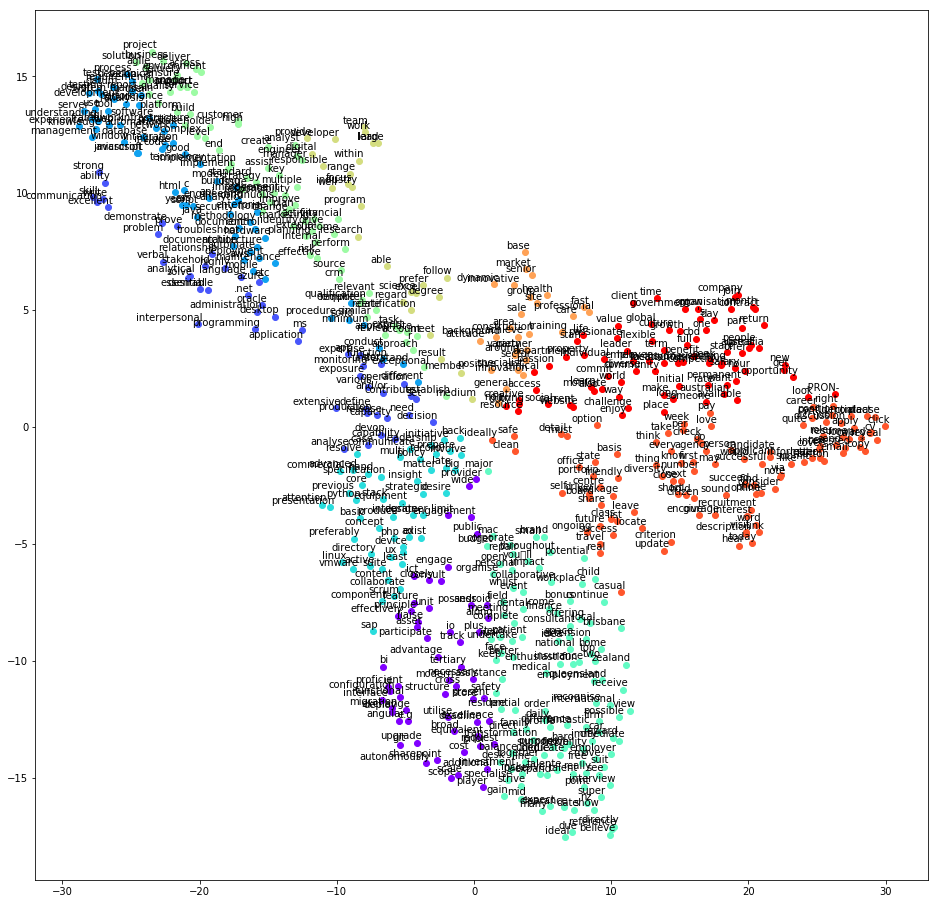

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9991050958633423), ('script', 0.9991042017936707), ('css', 0.9980654716491699), ('api', 0.9979163408279419), ('html', 0.9973450303077698)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9979522824287415), ('knowledge', 0.9970316886901855), ('web', 0.9969503879547119), ('use', 0.9956013560295105), ('tool', 0.9945451617240906), ('understanding', 0.9940284490585327), ('framework', 0.9909563064575195), ('window', 0.9893268346786499), ('development', 0.9883506894111633), ('system', 0.9877595901489258)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:56,  2.64s/it]
188it [05:25,  1.44s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


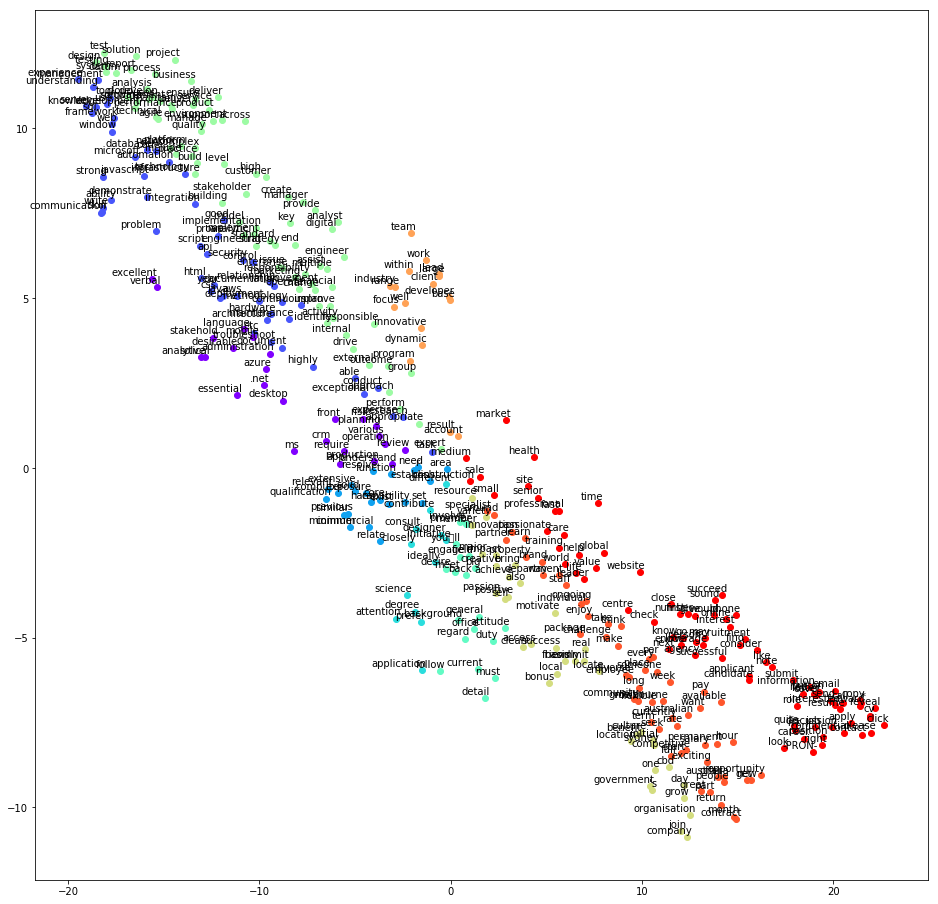

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9992884993553162), ('html', 0.9981554746627808), ('css', 0.9980348348617554), ('aws', 0.9980109333992004), ('api', 0.9978166222572327)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9980699419975281), ('web', 0.9970880746841431), ('window', 0.9969003200531006), ('knowledge', 0.9965938329696655), ('framework', 0.9957640171051025), ('use', 0.9953194856643677), ('tool', 0.9942247867584229), ('understanding', 0.9925644397735596), ('system', 0.9867454767227173), ('microsoft', 0.9860425591468811)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p
preprocessing


338it [13:54,  2.72s/it]
188it [05:22,  1.41s/it]


corpus


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\gensim\models\base_any2vec.py:743: UserWarning: C extension not loaded, training will be slow. Install a C compiler and reinstall gensim for fast training.
  "C extension not loaded, training will be slow. "


plot


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:8: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  
C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\smart_open\smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


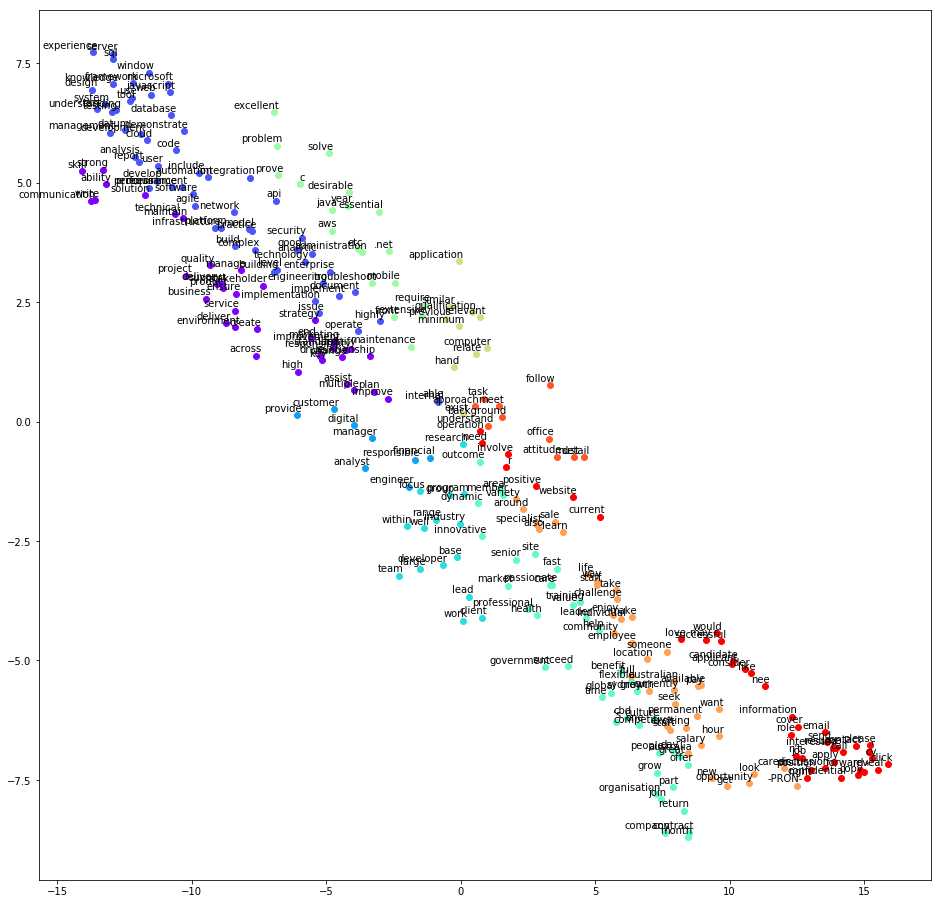

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:37: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('c', 0.9991113543510437), ('aws', 0.9982405304908752), ('api', 0.9980649948120117), ('administration', 0.9972181916236877), ('year', 0.9967813491821289)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:38: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


[('server', 0.9987277984619141), ('knowledge', 0.9968487024307251), ('framework', 0.996257483959198), ('tool', 0.9953843355178833), ('web', 0.9947612285614014), ('use', 0.9946051836013794), ('understanding', 0.9938787221908569), ('window', 0.9934482574462891), ('experience', 0.9895186424255371), ('system', 0.9887849688529968)]


C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:39: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


ca bug qqpart :p


In [181]:
seekBoard = pd.read_csv("data/input/Other/seek_australia_sample.csv", encoding = "ISO-8859-1")
seekBoard = seekBoard[["job_description"]]
seekBoard = seekBoard[seekBoard['job_description'].str.contains(regex_skill, na=False, regex=True)]

gumtreeBoard = pd.read_csv("data/input/Other/Gumtree_australia.csv", encoding = "ISO-8859-1")
gumtreeBoard = gumtreeBoard[["job_description"]]
gumtreeBoard = gumtreeBoard[gumtreeBoard['job_description'].str.contains(regex_skill, na=False, regex=True)]


for perplexity in perplexityPossibilities :
    for isDeleteEnglishStopwords in possibilities :
        for isLower in possibilities :
            for isLemmatize in possibilities :
                for n_iter in n_iterPossibilities :
                    for min_count in min_countPossibilities :

                        print("preprocessing")

                        # 360 lines
                        seekBoard_observations = preprocessingAO(seekBoard)
                        
                        # 188 lines
                        gumtreeBoard_observations = preprocessingAO(gumtreeBoard)

                        # Concat AO & DC
                        listToReduce = seekBoard_observations['sentences2'].tolist() + gumtreeBoard_observations['sentences2'].tolist()

                        print("corpus")
                        # Plot model and save fig
                        corpus = reduceDimensionList(listToReduce)
                        model = word2vec.Word2Vec(corpus, min_count=min_count, seed = 0)

                        print("plot")
                        tsne_plot(model)
                        
                        try :
                            print(model.most_similar('java', topn=5))
                            print(model.most_similar('sql'))
                            print(model.most_similar('windows'))
                        except :
                            print("ca bug qqpart :p")

In [168]:
model.most_similar('java', topn=10)

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('c', 0.9992022514343262),
 ('.net', 0.9991812705993652),
 ('css', 0.9988585710525513),
 ('frameworks', 0.9987439513206482),
 ('database', 0.9987295866012573),
 ('environments', 0.9986717104911804),
 ('html', 0.998663067817688),
 ('javascript', 0.998268723487854),
 ('integration', 0.9982553720474243),
 ('commercial', 0.9981401562690735)]

In [169]:
model.most_similar('reporting')

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('process', 0.999006986618042),
 ('performance', 0.9989069700241089),
 ('infrastructure', 0.9988809823989868),
 ('developing', 0.9988808035850525),
 ('delivery', 0.9988633394241333),
 ('complex', 0.998833179473877),
 ('business', 0.998820424079895),
 ('teams', 0.99876469373703),
 ('requirements', 0.9987625479698181),
 ('system', 0.9986299276351929)]

In [170]:
model.most_similar('sql')

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('server', 0.9982389211654663),
 ('knowledge', 0.9964163303375244),
 ('using', 0.9963995218276978),
 ('web', 0.9960907697677612),
 ('understanding', 0.9954172968864441),
 ('tools', 0.9953105449676514),
 ('years', 0.9937494397163391),
 ('windows', 0.9931482672691345),
 ('development', 0.9919965267181396),
 ('microsoft', 0.9906466007232666)]

In [21]:
model.most_similar('management')

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('product', 0.9997406005859375),
 ('users', 0.9997151494026184),
 ('performance', 0.9996814727783203),
 ('user', 0.9996808767318726),
 ('responsible', 0.9996782541275024),
 ('customers', 0.9996764063835144),
 ('quality', 0.9996752738952637),
 ('issues', 0.9996737837791443),
 ('teams', 0.9996728301048279),
 ('creating', 0.9996670484542847)]

In [171]:
model.most_similar('python')

C:\Users\ncharbit\AppData\Local\Continuum\anaconda3\envs\p36NLP\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


KeyError: "word 'python' not in vocabulary"